# Problem 2: Generative Adversarial Networks

* **Learning Objective:** In this problem, you will implement a Generative Adversarial Network with the network structure proposed in [*Unsupervised Representation Learning with Deep Convolutional Generative Adversarial Networks*](https://arxiv.org/abs/1511.06434), and learn a visualization technique, *activation maximization*.
* **Provided code:** The code for constructing the two parts of the GAN, the discriminator and the generator, is done for you, along with the skeleton code for the training.
* **TODOs:** You will need to figure out how to properly feed the data, compute the loss and update the parameters to complete the training and visualization. In addition, to test your understanding, you will answer some non-coding questions.

In [1]:
# Import required libraries
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
import math
%matplotlib inline

# for auto-reloading external modules
# see http://stackoverflow.com/questions/1907993/autoreload-of-modules-in-ipython
%load_ext autoreload
%autoreload 2

In [2]:
import sys
if sys.version_info[0] < 3:
    raise Exception("Must be using Python 3")

print(sys.version_info)

sys.version_info(major=3, minor=6, micro=8, releaselevel='final', serial=0)


## Introduction: The forger versus the police

*Note: read the story even if you are already familiar with GANs, as one of the questions is related to this story.*

Generative models try to model the distribution of the data in an explicit way, in the sense that we can easily sample new data points from this model. This is in contrast to discriminative models that try to infer the output from the input. In the class we have seen one classic deep generative model, the Variational Autoencoder (VAE). Here, we will learn another generative model that has risen to prominence in recent years, the Generative Adversarial Network (GAN).

As the maths of Generative Adversarial Networks is somewhat tedious, a story is often told of a forger and a police to illustrate the idea.

> Imagine a forger that makes fake bills, and a police that tries to find these forgeries. If the forger were a VAE, his goal would be to take some real bills, and try to replicate the real bills as precisely as possible. In GAN, he has a different idea in his mind: rather than trying to replicate the real bills, it suffices to make fake bills such that people *think* they are real.
> 
> Now let's start. In the beginning, the police knows nothing about how to distinguish between real and fake bills. The forger knows nothing either and only produces white paper.
> 
> In the first round, the police gets the fake bill and learns that the forgeries are white while the real bills are green. The forger then finds out that white papers can no longer fool the police and starts to produce green papers.
>
> In the second round, the police learns that real bills have denominations printed on them while the forgeries do not. The forger then finds out that plain papers can no longer fool the police and starts to print numbers on them.
>
> In the third round, the police learns that real bills have watermarks on them while the forgeries do not. The forger then has to reproduce the watermarks on his fake bills.
>
> ...
>
> Finally, the police is able to spot the tiniest difference between real and fake bills and the forger has to make perfect replicas of real bills to fool the police.

Now in a GAN, the forger becomes the generator and the police becomes the discriminator. The discriminator is a binary classifier with the two classes being "taken from the real data" ("real") and "generated by the generator" ("fake"). Its objective is to minimize the classification loss. The generator's objective is to generate samples so that the discriminator misclassifies them as real.

Here we have some complications: the goal is not to find one perfect fake sample. Such a sample will not actually fool the discriminator: if the forger makes hundreds of the exact same fake bill, they will all have the same serial number and the police will soon find out that they are fake. Instead, we want the generator to be able to generate a variety of fake samples such that when presented as a distribution alongside the distribution of real samples, these two are indistinguishable by the discriminator.

So how do we generate different samples with a diterministic generator? We provide it with random numbers as input.

Typically, for the discriminator we use binary cross entropy loss with label 1 being real and 0 being fake. For the generator, the input is a random vector drawn from a standard normal distribution. Denote the generator by $G_{\phi}(z)$, discriminator by $D_{\theta}(x)$, the distribution of the real samples by $p(x)$ and the input distribution to the generator by $q(z)$. Recall that the binary cross entropy loss with classifier output $y$ and label $\hat{y}$ is

$$L(y, \hat{y}) = -\hat{y} \log y - (1 - \hat{y}) \log (1 - y)$$

For the discriminator, the objective is

$$\min_{\theta} \mathrm{E}_{x \sim p(x)}[L(D_{\theta}(x), 1)] + \mathrm{E}_{z \sim q(z)}[L(D_{\theta}(G_{\phi}(z)), 0)]$$

For the generator, the objective is

$$\max_{\phi} \mathrm{E}_{z \sim q(z)}[L(D_{\theta}(G_{\phi}(z)), 0)]$$

The generator's objective corresponds to maximizing the classification loss of the discriminator on the generated samples. Alternatively, we can **minimize** the classification loss of the discriminator on the generated samples  **when labelled as real**:

$$\min_{\phi} \mathrm{E}_{z \sim q(z)}[L(D_{\theta}(G_{\phi}(z)), 1)]$$

And this is what we will use in our implementation. The strength of the two networks should be balanced, so we train the two networks alternatingly, updating the parameters in both networks once in each interation.

## Problem 2-1: Implementing the GAN

We first load the data (CIFAR-10) and define some convenient functions. You should already have CIFAR-10 from assignment 1. Just copy the data from there or use ```data/get_datasets.sh``` if you don't have them.

In [3]:
def unpickle(file):
    import sys
    if sys.version_info.major == 2:
        import cPickle
        with open(file, 'rb') as fo:
            dict = cPickle.load(fo)
        return dict['data'], dict['labels']
    else:
        import pickle
        with open(file, 'rb') as fo:
            dict = pickle.load(fo, encoding='bytes')
        return dict[b'data'], dict[b'labels']

def load_train_data():
    X = []
    for i in range(5):
        X_, _ = unpickle('data/cifar-10-batches-py/data_batch_%d' % (i + 1))
        X.append(X_)
    X = np.concatenate(X)
    X = X.reshape((X.shape[0], 3, 32, 32)).transpose(0, 2, 3, 1)
    return X

def load_test_data():
    X_, _ = unpickle('data/cifar-10-batches-py/test_batch')
    X = X_.reshape((X_.shape[0], 3, 32, 32)).transpose(0, 2, 3, 1)
    return X

# Load cifar-10 data
train_samples = load_train_data() / 255.0
test_samples = load_test_data() / 255.0

In [4]:
def viz_grid(Xs, padding):
    N, H, W, C = Xs.shape
    grid_size = int(math.ceil(math.sqrt(N)))
    grid_height = H * grid_size + padding * (grid_size + 1)
    grid_width = W * grid_size + padding * (grid_size + 1)
    grid = np.zeros((grid_height, grid_width, C))
    next_idx = 0
    y0, y1 = padding, H + padding
    for y in range(grid_size):
        x0, x1 = padding, W + padding
        for x in range(grid_size):
            if next_idx < N:
                img = Xs[next_idx]
                grid[y0:y1, x0:x1] = img
                next_idx += 1
            x0 += W + padding
            x1 += W + padding
        y0 += H + padding
        y1 += H + padding
    return grid

def set_seed(seed):
    np.random.seed(seed)
    tf.random.set_random_seed(seed)

def conv2d(input, kernel_size, stride, num_filter, name = 'conv2d'):
    with tf.variable_scope(name):
        stride_shape = [1, stride, stride, 1]
        filter_shape = [kernel_size, kernel_size, input.get_shape()[3], num_filter]

        W = tf.get_variable('w', filter_shape, tf.float32, tf.random_normal_initializer(0.0, 0.02))
        b = tf.get_variable('b', [1, 1, 1, num_filter], initializer = tf.constant_initializer(0.0))
        return tf.nn.conv2d(input, W, stride_shape, padding = 'SAME') + b

def conv2d_transpose(input, kernel_size, stride, num_filter, name = 'conv2d_transpose'):
    with tf.variable_scope(name):
        stride_shape = [1, stride, stride, 1]
        filter_shape = [kernel_size, kernel_size, num_filter, input.get_shape()[3]]
        output_shape = tf.stack([tf.shape(input)[0], tf.shape(input)[1] * 2, tf.shape(input)[2] * 2, num_filter])

        W = tf.get_variable('w', filter_shape, tf.float32, tf.random_normal_initializer(0.0, 0.02))
        b = tf.get_variable('b', [1, 1, 1, num_filter], initializer = tf.constant_initializer(0.0))
        return tf.nn.conv2d_transpose(input, W, output_shape, stride_shape, padding = 'SAME') + b

def fc(input, num_output, name = 'fc'):
    with tf.variable_scope(name):
        num_input = input.get_shape()[1]
        W = tf.get_variable('w', [num_input, num_output], tf.float32, tf.random_normal_initializer(0.0, 0.02))
        b = tf.get_variable('b', [num_output], initializer = tf.constant_initializer(0.0))
        return tf.matmul(input, W) + b

def batch_norm(input, is_training):
    out = tf.contrib.layers.batch_norm(input, decay = 0.99, center = True, scale = True,
                                       is_training = is_training, updates_collections = None)
    return out

def leaky_relu(input, alpha = 0.2):
    return tf.maximum(alpha * input, input)

To save you some mundane work, we have defined a discriminator and a generator for you, in ```_discriminator()``` and ```_generator()``` respectively. Look at the code to see what layers are there.

For this part, you need to complete code blocks marked with "Prob 2-1":

*   **Build the computation graph for the losses:** Complete the following definitions in ```_init_ops()```
    *   ```fake_samples_op```: generate famples from ```noise```
    *   ```dis_loss_op```: compute discriminator's loss, with real samples from ```real_input``` and fake
        samples generated by the generator
    *   ```gen_loss_op```: compute generator's loss
*   **Define the optimizer:** We use RMSprop for training. Adam is observed to perform poorly with an unstable objective as is the case in GANs. We've defined ```dis_train_op``` and ```gen_train_op``` for you but those are wrong: rather than updating all the parameters all the time, when training one network we want to keep the other one fixed. Modify the definition to reflect this. [Check here](https://stackoverflow.com/a/35304001) if you are not sure how this is possible.
*   **Feed the data:** Feed the proper samples and labels in ```train()``` for training and in ```generate_one_sample()``` for visualizing the generated samples.

The batch normalization layers should operate in training mode. As per *[How to Train a GAN? Tips and tricks to make GANs work](https://github.com/soumith/ganhacks)*, we put real samples and fake samples in different batches when training the discriminator.

*Note: use the advices on that page with caution if you are doing GAN for your team project. It is already more than 2 years old, which is a **really long time** in deep learning research. It does not reflect the latest results.*

In [13]:
class DCGAN(object):

    def __init__(self):
        self.num_epoch = 1
        self.batch_size = 32
        self.log_step = 50
        self.visualize_step = 200
        self.code_size = 64
        self.learning_rate = 1e-4
        self.vis_learning_rate = 1e-2
        self.recon_steps = 100
        self.actmax_steps = 100
        
        self._dis_called = False
        self._gen_called = False

        self.tracked_noise = np.random.normal(0, 1, [64, self.code_size])

        self.real_input = tf.placeholder(tf.float32, [None, 32, 32, 3])
        self.real_label = tf.placeholder(tf.float32, [None, 1])
        self.fake_label = tf.placeholder(tf.float32, [None, 1])
        self.noise = tf.placeholder(tf.float32, [None, self.code_size])
        
        self.is_train = tf.placeholder(tf.bool)
        
        self.recon_sample = tf.placeholder(tf.float32, [1, 32, 32, 3])
        self.actmax_label = tf.placeholder(tf.float32, [1, 1])
        
        with tf.variable_scope('actmax'):
            self.actmax_code = tf.get_variable('actmax_code', [1, self.code_size],
                                               initializer = tf.constant_initializer(0.0))
        
        self._init_ops()

    def _discriminator(self, input):
        # We have multiple instances of the discriminator in the same computation graph,
        # so set variable sharing if this is not the first invocation of this function.
        with tf.variable_scope('dis', reuse = self._dis_called):
            self._dis_called = True
            dis_conv1 = conv2d(input, 4, 2, 32, 'conv1')
            dis_lrelu1 = leaky_relu(dis_conv1)
            dis_conv2 = conv2d(dis_lrelu1, 4, 2, 64, 'conv2')
            dis_batchnorm2 = batch_norm(dis_conv2, self.is_train)
            dis_lrelu2 = leaky_relu(dis_batchnorm2)
            dis_conv3 = conv2d(dis_lrelu2, 4, 2, 128, 'conv3')
            dis_batchnorm3 = batch_norm(dis_conv3, self.is_train)
            dis_lrelu3 = leaky_relu(dis_batchnorm3)
            dis_reshape3 = tf.reshape(dis_lrelu3, [-1, 4 * 4 * 128])
            dis_fc4 = fc(dis_reshape3, 1, 'fc4')
            return dis_fc4

    def _generator(self, input):
        with tf.variable_scope('gen', reuse = self._gen_called):
            self._gen_called = True
            gen_fc1 = fc(input, 4 * 4 * 128, 'fc1')
            gen_reshape1 = tf.reshape(gen_fc1, [-1, 4, 4, 128])
            gen_batchnorm1 = batch_norm(gen_reshape1, self.is_train)
            gen_lrelu1 = leaky_relu(gen_batchnorm1)
            gen_conv2 = conv2d_transpose(gen_lrelu1, 4, 2, 64, 'conv2')
            gen_batchnorm2 = batch_norm(gen_conv2, self.is_train)
            gen_lrelu2 = leaky_relu(gen_batchnorm2)
            gen_conv3 = conv2d_transpose(gen_lrelu2, 4, 2, 32, 'conv3')
            gen_batchnorm3 = batch_norm(gen_conv3, self.is_train)
            gen_lrelu3 = leaky_relu(gen_batchnorm3)
            gen_conv4 = conv2d_transpose(gen_lrelu3, 4, 2, 3, 'conv4')
            gen_sigmoid4 = tf.sigmoid(gen_conv4)
            return gen_sigmoid4

    def _loss(self, labels, logits):
        loss = tf.nn.sigmoid_cross_entropy_with_logits(labels = labels, logits = logits)
        return tf.reduce_mean(loss)

    def _reconstruction_loss(self, generated, target):
        loss = tf.nn.l2_loss(generated - target)
        return tf.reduce_mean(loss)
    
    # Define operations
    def _init_ops(self):
        
        ################################################################################
        # Prob 2-1: complete the definition of these operations                        #
        ################################################################################
        
        self.fake_samples_op = self._generator(self.noise)
        
        #true_labels = tf.ones_like(logits_fake)
        #real_image_loss = tf.nn.sigmoid_cross_entropy_with_logits(logits=logits_real, labels=true_labels)
        #fake_image_loss = tf.nn.sigmoid_cross_entropy_with_logits(logits=logits_fake, labels=1-true_labels)
    
        logits_real = self._discriminator(self.real_input)
        logits_fake = self._discriminator(self.fake_samples_op)
#         true_labels = tf.ones_like(logits_fake)
#         real_image_loss = self._loss(labels=true_labels, logits=logits_real)
        real_image_loss = self._loss(labels=self.real_label, logits=logits_real)
#         fake_image_loss = self._loss(labels=1-true_labels, logits=logits_fake)
        fake_image_loss = self._loss(labels=self.fake_label, logits=logits_fake)
        D_loss = real_image_loss + fake_image_loss
        self.dis_loss_op = tf.reduce_mean(D_loss)
        
        # G_loss = tf.nn.sigmoid_cross_entropy_with_logits(logits=logits_fake, labels=true_labels)
        
#         self.gen_loss_op = self._loss(labels=true_labels, logits=logits_fake)
        #logits_fake = self._discriminator(self.fake_samples_op)
        self.gen_loss_op = self._loss(labels=self.real_label, logits=logits_fake)
        
        ################################################################################
        # Prob 2-1: fix the definition of these operations                             #
        ################################################################################
        
        dis_optimizer = tf.train.RMSPropOptimizer(self.learning_rate)
        dis_train_vars = tf.get_collection(tf.GraphKeys.TRAINABLE_VARIABLES,
                                     "dis")
        self.dis_train_op = dis_optimizer.minimize(self.dis_loss_op, var_list=dis_train_vars)
        
        gen_optimizer = tf.train.RMSPropOptimizer(self.learning_rate)
        gen_train_vars = tf.get_collection(tf.GraphKeys.TRAINABLE_VARIABLES,
                                     "gen")
        self.gen_train_op = gen_optimizer.minimize(self.gen_loss_op, var_list=gen_train_vars)
        
        ################################################################################
        # Prob 2-4: check the definition of these operations                           #
        # skip this part when working on problem 2-1 and come back for problem 2-4     #
        ################################################################################
        
        self.actmax_sample_op = self._generator(self.actmax_code)
        actmax_dis = self._discriminator(self.actmax_sample_op)
        self.actmax_loss_op = self._loss(self.actmax_label, actmax_dis)

        actmax_optimizer = tf.train.AdamOptimizer(self.vis_learning_rate)
        self.actmax_op = actmax_optimizer.minimize(self.actmax_loss_op, var_list = [self.actmax_code])
        
        ################################################################################
        # Prob 2-4: complete the definition of these operations                        #
        # skip this part when working on problem 2-1 and come back for problem 2-4     #
        ################################################################################
        
        #gen_sample = self._generator(self.actmax_code)
        self.recon_loss_op = self._reconstruction_loss(self.actmax_sample_op, self.real_input)
        
        recon_optimizer = tf.train.AdamOptimizer(self.vis_learning_rate)
        #recon_vars = tf.get_collection(tf.GraphKeys.TRAINABLE_VARIABLES,
         #                            "actmax")
        #self.reconstruct_op = recon_optimizer.minimize(self.recon_loss_op, var_list=recon_vars)
        self.reconstruct_op = recon_optimizer.minimize(self.recon_loss_op, var_list = [self.actmax_code])
        
        ################################################################################
        #                               END OF YOUR CODE                               #
        ################################################################################

    # Training function
    def train(self, sess, train_samples):
        sess.run(tf.global_variables_initializer())

        num_train = train_samples.shape[0]
        step = 0
        
        # smooth the loss curve so that it does not fluctuate too much
        smooth_factor = 0.95
        plot_dis_s = 0
        plot_gen_s = 0
        plot_ws = 0
        
        dis_losses = []
        gen_losses = []
        max_steps = int(self.num_epoch * (num_train // self.batch_size))
        print('Start training ...')
        for epoch in range(self.num_epoch):
            print("epoch ", epoch)
            for i in range(num_train // self.batch_size):
                step += 1

                batch_samples = train_samples[i * self.batch_size : (i + 1) * self.batch_size]
                noise = np.random.normal(0, 1, [self.batch_size, self.code_size])
                zeros = np.zeros([self.batch_size, 1])
                ones = np.ones([self.batch_size, 1])
        
                ################################################################################
                # Prob 2-1: complete the feed dictionary                                       #
                ################################################################################
#                 self.real_input = tf.placeholder(tf.float32, [None, 32, 32, 3])
#                 self.real_label = tf.placeholder(tf.float32, [None, 1])
#                 self.fake_label = tf.placeholder(tf.float32, [None, 1])
#                 self.noise = tf.placeholder(tf.float32, [None, self.code_size])
#                 self.is_train = tf.placeholder(tf.bool)
#                 self.recon_sample = tf.placeholder(tf.float32, [1, 32, 32, 3])
#                 self.actmax_label = tf.placeholder(tf.float32, [1, 1])
                
                dis_feed_dict = {self.noise: noise, self.real_input: batch_samples, 
                                 self.real_label:ones, self.fake_label: zeros,
                                self.is_train:True }
                
                ################################################################################
                #                               END OF YOUR CODE                               #
                ################################################################################

                _, dis_loss = sess.run([self.dis_train_op, self.dis_loss_op], feed_dict = dis_feed_dict)
        
                ################################################################################
                # Prob 2-1: complete the feed dictionary                                       #
                ################################################################################
                
                gen_feed_dict = {self.noise: noise, self.real_input: batch_samples,
                                self.real_label:ones, self.fake_label:zeros,
                                self.is_train:True}
                
                ################################################################################
                #                               END OF YOUR CODE                               #
                ################################################################################

                _, gen_loss = sess.run([self.gen_train_op, self.gen_loss_op], feed_dict = gen_feed_dict)

                plot_dis_s = plot_dis_s * smooth_factor + dis_loss * (1 - smooth_factor)
                plot_gen_s = plot_gen_s * smooth_factor + gen_loss * (1 - smooth_factor)
                plot_ws = plot_ws * smooth_factor + (1 - smooth_factor)
                dis_losses.append(plot_dis_s / plot_ws)
                gen_losses.append(plot_gen_s / plot_ws)

                if step % self.log_step == 0:
                    print('Iteration {0}/{1}: dis loss = {2:.4f}, gen loss = {3:.4f}'.format(step, max_steps, dis_loss, gen_loss))

            fig = plt.figure(figsize = (8, 8))   
            ax1 = plt.subplot(111)
            ax1.imshow(viz_grid(self.generate(self.tracked_noise), 1))
            plt.show()

            plt.plot(dis_losses)
            plt.title('discriminator loss')
            plt.xlabel('iterations')
            plt.ylabel('loss')
            plt.show()

            plt.plot(gen_losses)
            plt.title('generator loss')
            plt.xlabel('iterations')
            plt.ylabel('loss')
            plt.show()
        print('... Done!')

    # Find the reconstruction of one input sample
    def reconstruct_one_sample(self, sample):
        
        ################################################################################
        # Prob 2-4: initialize self.actmax_code                                        #
        # skip this part when working on problem 2-1 and come back for problem 2-4     #
        ################################################################################
        
        actmax_init_val = tf.zeros([1, self.code_size])
        
        ################################################################################
        #                               END OF YOUR CODE                               #
        ################################################################################
        
        sess.run(self.actmax_code.assign(actmax_init_val))
        last_reconstruction = None
        last_loss = None
        for i in range(self.recon_steps):
        
            ################################################################################
            # Prob 2-4: complete the feed dictionary                                       #
            # skip this part when working on problem 2-1 and come back for problem 2-4     #
            ################################################################################   
            
            #recon_feed_dict = {self.recon_sample :sample, self.is_train: False}
            recon_feed_dict = {self.real_input :sample, self.is_train: False}
            
            ################################################################################
            #                               END OF YOUR CODE                               #
            ################################################################################
            
            run_ops = [self.recon_loss_op, self.reconstruct_op, self.actmax_sample_op]
            last_loss, _, last_reconstruction = sess.run(run_ops, feed_dict = recon_feed_dict)
        return last_loss, last_reconstruction

    # Find the reconstruction of a batch of samples
    def reconstruct(self, samples):
        reconstructions = np.zeros(samples.shape)
        total_loss = 0
        for i in range(samples.shape[0]):
            loss, reconstructions[i:i+1] = self.reconstruct_one_sample(samples[i:i+1])
            total_loss += loss
        return total_loss / samples.shape[0], reconstructions

    # Generates a single sample from input code
    def generate_one_sample(self, code):
        
        ################################################################################
        # Prob 2-1: complete the feed dictionary                                       #
        ################################################################################
        
        gen_vis_feed_dict = {self.noise: code, self.is_train:False}
        
        ################################################################################
        #                               END OF YOUR CODE                               #
        ################################################################################
        
        generated = sess.run(self.fake_samples_op, feed_dict = gen_vis_feed_dict)
        return generated

    # Generates samples from input batch of codes
    def generate(self, codes):
        generated = np.zeros((codes.shape[0], 32, 32, 3))
        for i in range(codes.shape[0]):
            generated[i:i+1] = self.generate_one_sample(codes[i:i+1])
        return generated

    # Perform activation maximization on one initial code
    def actmax_one_sample(self, initial_code):
        
        ################################################################################
        # Prob 2-4: check this function                                                #
        # skip this part when working on problem 2-1 and come back for problem 2-4     #
        ################################################################################
        
        actmax_init_val = tf.convert_to_tensor(initial_code, dtype = tf.float32)
        sess.run(self.actmax_code.assign(actmax_init_val))
        for i in range(self.actmax_steps):
            actmax_feed_dict = {
                self.actmax_label: np.ones([1, 1]),
                self.is_train: False
            }
            _, last_actmax = sess.run([self.actmax_op, self.actmax_sample_op], feed_dict = actmax_feed_dict)
        return last_actmax

    # Perform activation maximization on a batch of different initial codes
    def actmax(self, initial_codes):
        actmax_results = np.zeros((initial_codes.shape[0], 32, 32, 3))
        for i in range(initial_codes.shape[0]):
            actmax_results[i:i+1] = self.actmax_one_sample(initial_codes[i:i+1])
        return actmax_results.clip(0, 1)

Now let's do the training!

Don't panic if the loss curve goes wild. The two networks are competing for the loss curve to go different directions, so virtually anything can happen. If your code is correct, the generated samples should have a high variety.

Start training ...
Iteration 50/7810: dis loss = 0.5594, gen loss = 1.8982
Iteration 100/7810: dis loss = 0.0822, gen loss = 3.8476
Iteration 150/7810: dis loss = 0.1718, gen loss = 2.6334
Iteration 200/7810: dis loss = 0.0714, gen loss = 3.7793
Iteration 250/7810: dis loss = 0.0851, gen loss = 3.3335
Iteration 300/7810: dis loss = 0.9234, gen loss = 0.7855
Iteration 350/7810: dis loss = 0.7110, gen loss = 1.1671
Iteration 400/7810: dis loss = 1.1919, gen loss = 1.1929
Iteration 450/7810: dis loss = 0.6680, gen loss = 1.4169
Iteration 500/7810: dis loss = 0.7814, gen loss = 1.8323
Iteration 550/7810: dis loss = 0.5076, gen loss = 1.8792
Iteration 600/7810: dis loss = 0.7580, gen loss = 1.7314
Iteration 650/7810: dis loss = 1.1272, gen loss = 0.7392
Iteration 700/7810: dis loss = 1.2308, gen loss = 0.5244
Iteration 750/7810: dis loss = 0.9833, gen loss = 1.8920
Iteration 800/7810: dis loss = 0.7468, gen loss = 1.1145
Iteration 850/7810: dis loss = 1.0226, gen loss = 0.8199
Iteration 900

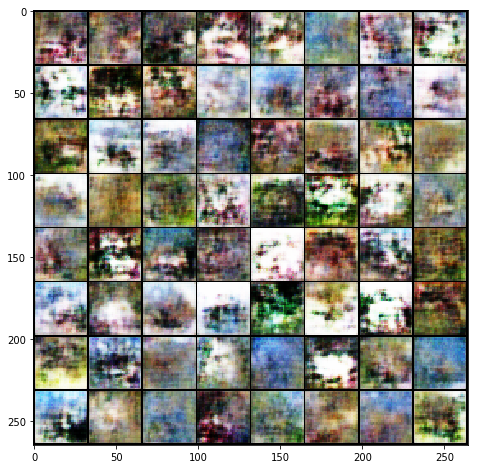

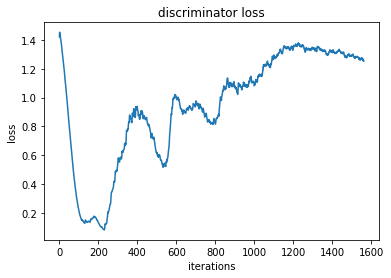

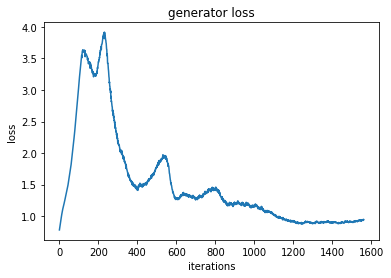

Iteration 1600/7810: dis loss = 1.2908, gen loss = 1.2244
Iteration 1650/7810: dis loss = 1.2840, gen loss = 1.1293
Iteration 1700/7810: dis loss = 1.1478, gen loss = 0.8607
Iteration 1750/7810: dis loss = 1.1319, gen loss = 0.9771
Iteration 1800/7810: dis loss = 1.2700, gen loss = 0.8437
Iteration 1850/7810: dis loss = 1.1946, gen loss = 1.2538
Iteration 1900/7810: dis loss = 1.0240, gen loss = 1.3947
Iteration 1950/7810: dis loss = 1.2869, gen loss = 1.2736
Iteration 2000/7810: dis loss = 1.0934, gen loss = 1.5992
Iteration 2050/7810: dis loss = 1.3295, gen loss = 1.0389
Iteration 2100/7810: dis loss = 1.0779, gen loss = 0.9215
Iteration 2150/7810: dis loss = 1.1077, gen loss = 0.8604
Iteration 2200/7810: dis loss = 1.3284, gen loss = 1.1018
Iteration 2250/7810: dis loss = 1.0725, gen loss = 0.8283
Iteration 2300/7810: dis loss = 1.1789, gen loss = 0.8843
Iteration 2350/7810: dis loss = 1.1136, gen loss = 0.8641
Iteration 2400/7810: dis loss = 1.2150, gen loss = 0.7201
Iteration 2450

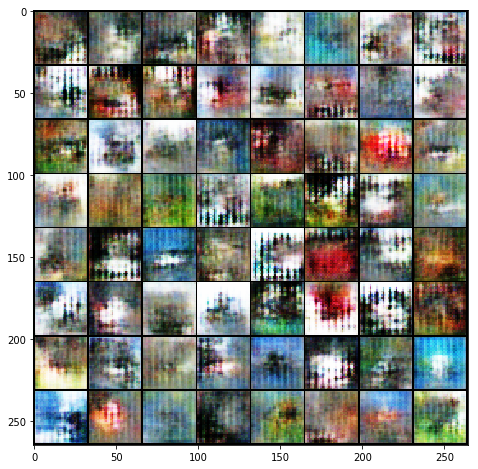

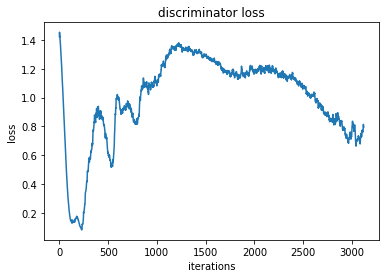

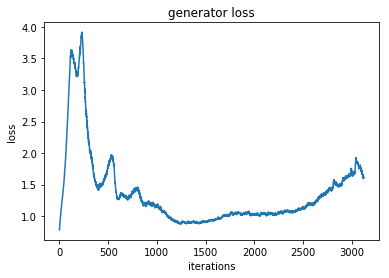

Iteration 3150/7810: dis loss = 0.8481, gen loss = 2.2032
Iteration 3200/7810: dis loss = 0.4154, gen loss = 1.7048
Iteration 3250/7810: dis loss = 0.6784, gen loss = 1.8065
Iteration 3300/7810: dis loss = 0.7145, gen loss = 1.1930
Iteration 3350/7810: dis loss = 0.7191, gen loss = 1.5113
Iteration 3400/7810: dis loss = 0.6356, gen loss = 1.4194
Iteration 3450/7810: dis loss = 0.5613, gen loss = 1.4756
Iteration 3500/7810: dis loss = 0.8539, gen loss = 2.2775
Iteration 3550/7810: dis loss = 0.7981, gen loss = 1.5751
Iteration 3600/7810: dis loss = 0.7379, gen loss = 1.7293
Iteration 3650/7810: dis loss = 0.6825, gen loss = 1.3517
Iteration 3700/7810: dis loss = 0.9169, gen loss = 1.1168
Iteration 3750/7810: dis loss = 0.9780, gen loss = 0.9933
Iteration 3800/7810: dis loss = 1.2561, gen loss = 1.6104
Iteration 3850/7810: dis loss = 1.4828, gen loss = 1.6292
Iteration 3900/7810: dis loss = 1.1212, gen loss = 1.6147
Iteration 3950/7810: dis loss = 1.0995, gen loss = 0.8019
Iteration 4000

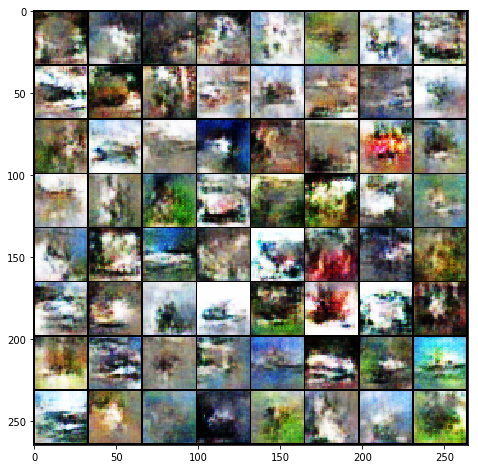

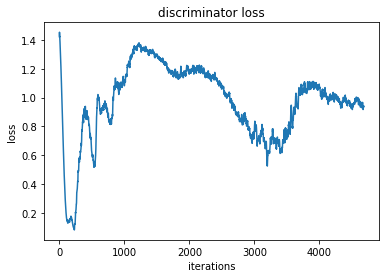

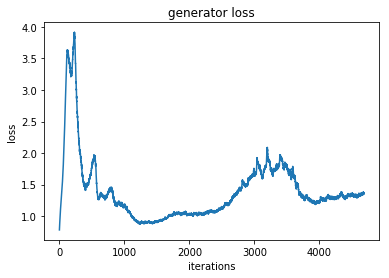

Iteration 4700/7810: dis loss = 1.0154, gen loss = 0.9311
Iteration 4750/7810: dis loss = 1.0890, gen loss = 0.7486
Iteration 4800/7810: dis loss = 1.1031, gen loss = 0.8351
Iteration 4850/7810: dis loss = 0.8201, gen loss = 1.4727
Iteration 4900/7810: dis loss = 0.8961, gen loss = 1.3998
Iteration 4950/7810: dis loss = 0.9595, gen loss = 0.8185
Iteration 5000/7810: dis loss = 1.0047, gen loss = 0.4476
Iteration 5050/7810: dis loss = 1.0413, gen loss = 0.9720
Iteration 5100/7810: dis loss = 1.2261, gen loss = 2.3440
Iteration 5150/7810: dis loss = 0.9238, gen loss = 1.3580
Iteration 5200/7810: dis loss = 1.0459, gen loss = 0.5771
Iteration 5250/7810: dis loss = 1.0839, gen loss = 1.7860
Iteration 5300/7810: dis loss = 0.8974, gen loss = 0.8794
Iteration 5350/7810: dis loss = 0.9676, gen loss = 0.7071
Iteration 5400/7810: dis loss = 0.7393, gen loss = 1.5035
Iteration 5450/7810: dis loss = 0.9837, gen loss = 1.7919
Iteration 5500/7810: dis loss = 0.8603, gen loss = 1.1772
Iteration 5550

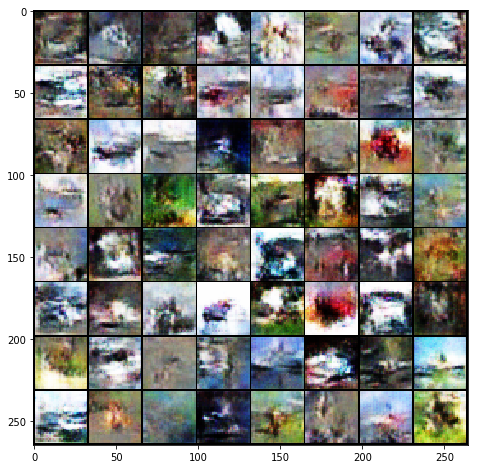

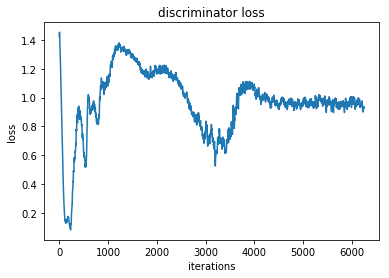

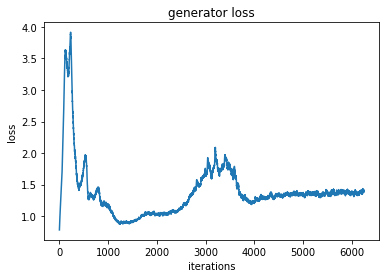

Iteration 6250/7810: dis loss = 1.0229, gen loss = 0.9113
Iteration 6300/7810: dis loss = 0.7618, gen loss = 1.3545
Iteration 6350/7810: dis loss = 0.8183, gen loss = 1.3004
Iteration 6400/7810: dis loss = 0.8624, gen loss = 1.4598
Iteration 6450/7810: dis loss = 0.8295, gen loss = 1.9870
Iteration 6500/7810: dis loss = 0.7647, gen loss = 2.2925
Iteration 6550/7810: dis loss = 0.8275, gen loss = 1.7005
Iteration 6600/7810: dis loss = 1.2739, gen loss = 1.6076
Iteration 6650/7810: dis loss = 1.1411, gen loss = 0.8055
Iteration 6700/7810: dis loss = 0.8496, gen loss = 1.8854
Iteration 6750/7810: dis loss = 1.2419, gen loss = 0.4930
Iteration 6800/7810: dis loss = 1.0051, gen loss = 0.8717
Iteration 6850/7810: dis loss = 0.9101, gen loss = 0.9624
Iteration 6900/7810: dis loss = 0.9231, gen loss = 0.9253
Iteration 6950/7810: dis loss = 0.8119, gen loss = 1.5265
Iteration 7000/7810: dis loss = 0.7559, gen loss = 1.3328
Iteration 7050/7810: dis loss = 1.0388, gen loss = 1.0204
Iteration 7100

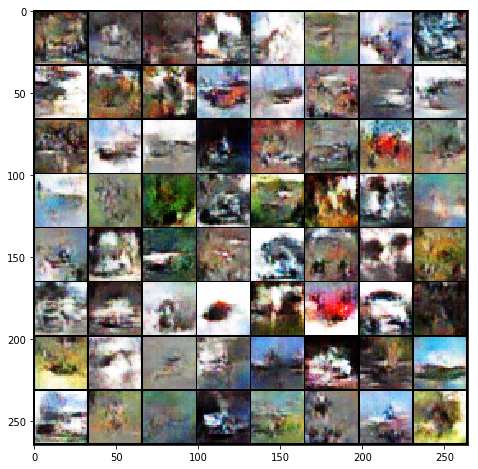

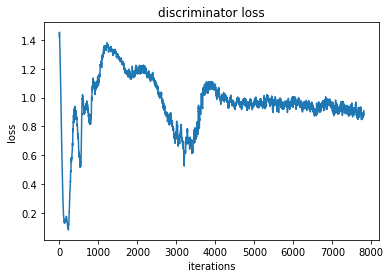

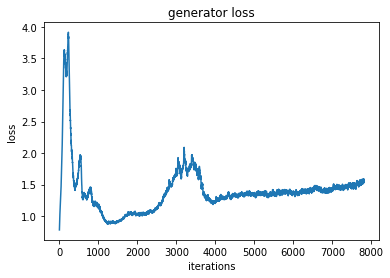

... Done!


In [19]:
tf.reset_default_graph()
#set_seed(21)

with tf.Session() as sess:
    with tf.device('/cpu:0'):
        dcgan = DCGAN()
        sess.run(tf.global_variables_initializer())
        dcgan.train(sess, train_samples)
        dis_var_list = tf.get_collection(tf.GraphKeys.GLOBAL_VARIABLES, 'dis')
        gen_var_list = tf.get_collection(tf.GraphKeys.GLOBAL_VARIABLES, 'gen')
        saver = tf.train.Saver(dis_var_list + gen_var_list)
        saver.save(sess, 'model/dcgan')


Start training ...
epoch  0
Iteration 50/156200: dis loss = 0.4688, gen loss = 2.1446
Iteration 100/156200: dis loss = 0.0752, gen loss = 4.0203
Iteration 150/156200: dis loss = 0.1883, gen loss = 5.2771
Iteration 200/156200: dis loss = 0.1896, gen loss = 2.8276
Iteration 250/156200: dis loss = 0.0444, gen loss = 4.2938
Iteration 300/156200: dis loss = 0.3094, gen loss = 1.1960
Iteration 350/156200: dis loss = 0.6543, gen loss = 1.3438
Iteration 400/156200: dis loss = 0.5745, gen loss = 1.7153
Iteration 450/156200: dis loss = 0.6629, gen loss = 1.5379
Iteration 500/156200: dis loss = 0.5858, gen loss = 3.0402
Iteration 550/156200: dis loss = 0.8674, gen loss = 1.6744
Iteration 600/156200: dis loss = 0.7313, gen loss = 1.9865
Iteration 650/156200: dis loss = 1.0805, gen loss = 2.3306
Iteration 700/156200: dis loss = 0.7730, gen loss = 1.0625
Iteration 750/156200: dis loss = 0.7679, gen loss = 1.9558
Iteration 800/156200: dis loss = 0.5534, gen loss = 2.4451
Iteration 850/156200: dis los

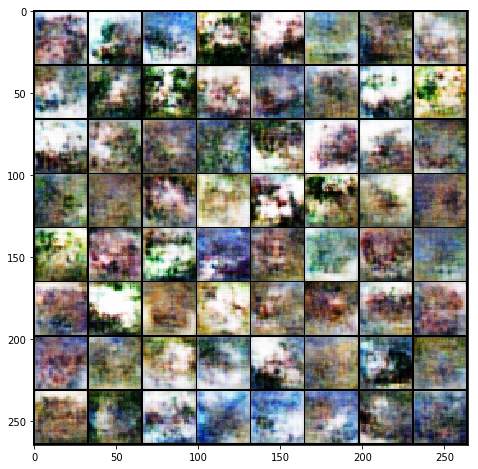

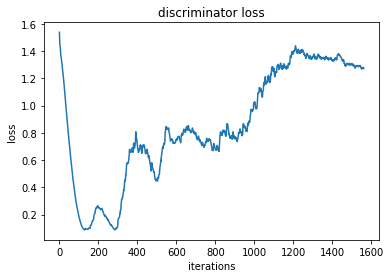

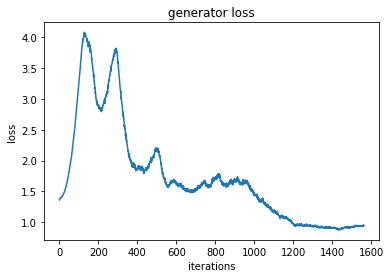

epoch  1
Iteration 1600/156200: dis loss = 1.2337, gen loss = 1.2615
Iteration 1650/156200: dis loss = 1.2648, gen loss = 1.2050
Iteration 1700/156200: dis loss = 1.2310, gen loss = 1.3426
Iteration 1750/156200: dis loss = 1.1237, gen loss = 0.7831
Iteration 1800/156200: dis loss = 1.3400, gen loss = 0.9516
Iteration 1850/156200: dis loss = 1.3821, gen loss = 0.5334
Iteration 1900/156200: dis loss = 1.1687, gen loss = 1.2505
Iteration 1950/156200: dis loss = 1.2580, gen loss = 1.1917
Iteration 2000/156200: dis loss = 1.2199, gen loss = 1.1617
Iteration 2050/156200: dis loss = 1.1751, gen loss = 1.3586
Iteration 2100/156200: dis loss = 1.2811, gen loss = 1.1997
Iteration 2150/156200: dis loss = 1.2346, gen loss = 0.7320
Iteration 2200/156200: dis loss = 1.2140, gen loss = 1.1387
Iteration 2250/156200: dis loss = 1.3098, gen loss = 0.7818
Iteration 2300/156200: dis loss = 1.3378, gen loss = 0.7417
Iteration 2350/156200: dis loss = 1.1594, gen loss = 0.7449
Iteration 2400/156200: dis loss

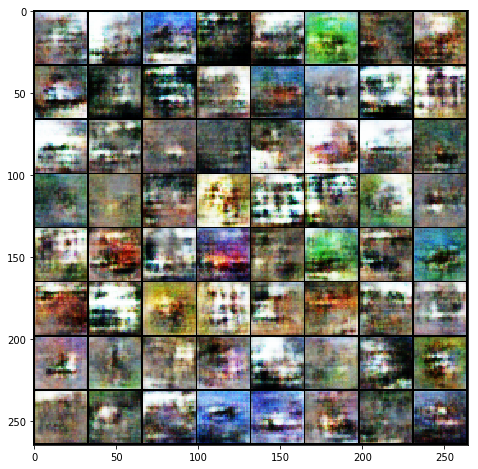

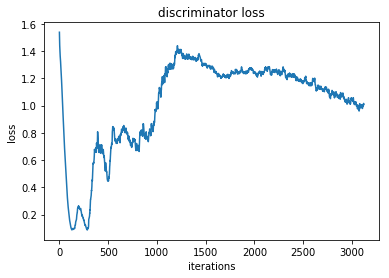

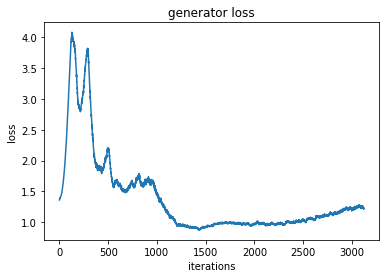

epoch  2
Iteration 3150/156200: dis loss = 1.0570, gen loss = 1.8171
Iteration 3200/156200: dis loss = 0.8431, gen loss = 1.0744
Iteration 3250/156200: dis loss = 0.8844, gen loss = 1.0098
Iteration 3300/156200: dis loss = 0.9202, gen loss = 0.9523
Iteration 3350/156200: dis loss = 0.9458, gen loss = 0.9599
Iteration 3400/156200: dis loss = 1.1666, gen loss = 1.1629
Iteration 3450/156200: dis loss = 0.7673, gen loss = 1.7146
Iteration 3500/156200: dis loss = 1.0801, gen loss = 0.6052
Iteration 3550/156200: dis loss = 1.0426, gen loss = 1.4989
Iteration 3600/156200: dis loss = 0.8926, gen loss = 1.1969
Iteration 3650/156200: dis loss = 0.9319, gen loss = 1.7813
Iteration 3700/156200: dis loss = 0.9541, gen loss = 1.0226
Iteration 3750/156200: dis loss = 1.2392, gen loss = 1.9401
Iteration 3800/156200: dis loss = 0.9410, gen loss = 1.2038
Iteration 3850/156200: dis loss = 1.4080, gen loss = 1.9689
Iteration 3900/156200: dis loss = 1.1736, gen loss = 0.9333
Iteration 3950/156200: dis loss

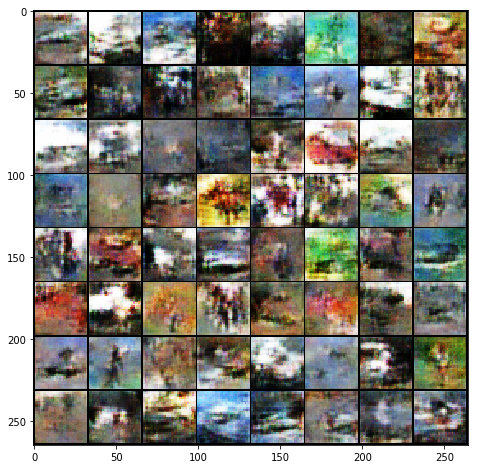

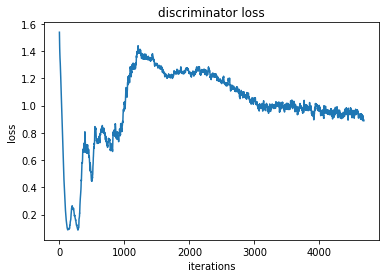

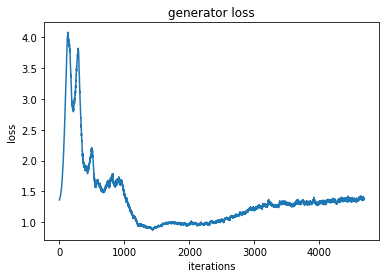

epoch  3
Iteration 4700/156200: dis loss = 1.2180, gen loss = 0.8164
Iteration 4750/156200: dis loss = 1.1597, gen loss = 1.8436
Iteration 4800/156200: dis loss = 1.0337, gen loss = 0.8792
Iteration 4850/156200: dis loss = 1.0613, gen loss = 0.7424
Iteration 4900/156200: dis loss = 0.8525, gen loss = 1.0037
Iteration 4950/156200: dis loss = 0.7123, gen loss = 1.7239
Iteration 5000/156200: dis loss = 0.8883, gen loss = 1.3971
Iteration 5050/156200: dis loss = 0.7440, gen loss = 1.4523
Iteration 5100/156200: dis loss = 0.8373, gen loss = 1.0504
Iteration 5150/156200: dis loss = 1.0787, gen loss = 0.7788
Iteration 5200/156200: dis loss = 0.9863, gen loss = 1.7141
Iteration 5250/156200: dis loss = 1.0709, gen loss = 2.1366
Iteration 5300/156200: dis loss = 0.8552, gen loss = 1.9331
Iteration 5350/156200: dis loss = 0.7606, gen loss = 1.0656
Iteration 5400/156200: dis loss = 0.9623, gen loss = 0.6411
Iteration 5450/156200: dis loss = 0.6380, gen loss = 1.3389
Iteration 5500/156200: dis loss

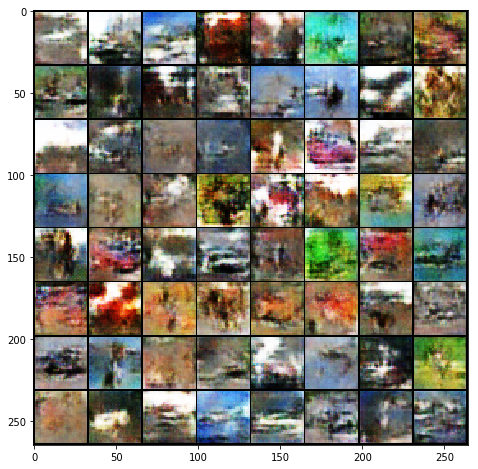

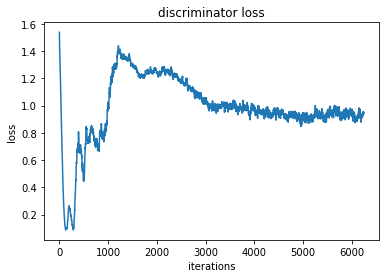

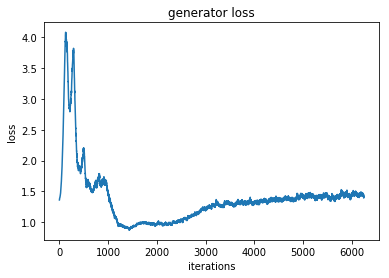

epoch  4
Iteration 6250/156200: dis loss = 0.9211, gen loss = 2.0025
Iteration 6300/156200: dis loss = 0.9506, gen loss = 0.9071
Iteration 6350/156200: dis loss = 0.7482, gen loss = 1.0132
Iteration 6400/156200: dis loss = 1.0759, gen loss = 1.8569
Iteration 6450/156200: dis loss = 1.0370, gen loss = 0.9098
Iteration 6500/156200: dis loss = 0.8179, gen loss = 0.8226
Iteration 6550/156200: dis loss = 0.9861, gen loss = 1.9381
Iteration 6600/156200: dis loss = 0.9018, gen loss = 1.1064
Iteration 6650/156200: dis loss = 1.1177, gen loss = 0.9342
Iteration 6700/156200: dis loss = 0.7823, gen loss = 1.8724
Iteration 6750/156200: dis loss = 1.0372, gen loss = 0.7603
Iteration 6800/156200: dis loss = 1.0159, gen loss = 1.4353
Iteration 6850/156200: dis loss = 0.5863, gen loss = 1.3978
Iteration 6900/156200: dis loss = 1.0152, gen loss = 0.5185
Iteration 6950/156200: dis loss = 1.4375, gen loss = 0.3846
Iteration 7000/156200: dis loss = 1.0393, gen loss = 1.3224
Iteration 7050/156200: dis loss

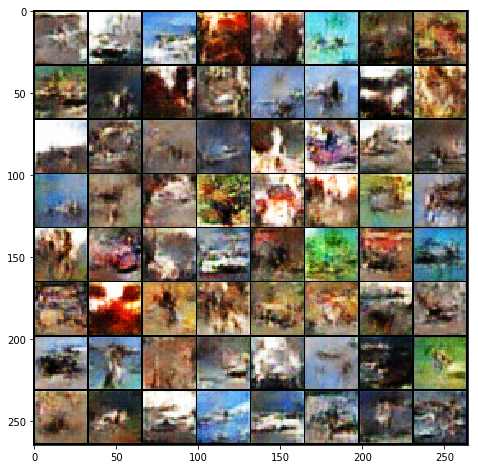

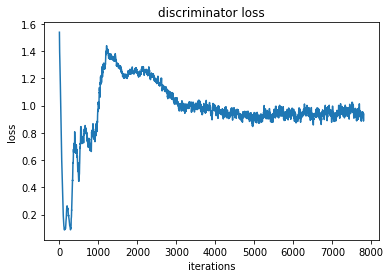

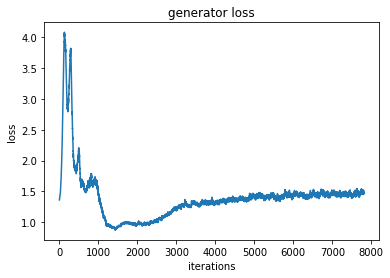

epoch  5
Iteration 7850/156200: dis loss = 1.1534, gen loss = 0.6534
Iteration 7900/156200: dis loss = 0.7025, gen loss = 2.6246
Iteration 7950/156200: dis loss = 0.9774, gen loss = 0.7248
Iteration 8000/156200: dis loss = 0.9441, gen loss = 0.6615
Iteration 8050/156200: dis loss = 1.3606, gen loss = 2.2813
Iteration 8100/156200: dis loss = 0.9277, gen loss = 2.6996
Iteration 8150/156200: dis loss = 0.8179, gen loss = 1.7256
Iteration 8200/156200: dis loss = 0.9943, gen loss = 2.4959
Iteration 8250/156200: dis loss = 0.8059, gen loss = 2.2983
Iteration 8300/156200: dis loss = 1.1974, gen loss = 1.9536
Iteration 8350/156200: dis loss = 0.8251, gen loss = 1.0804
Iteration 8400/156200: dis loss = 0.8439, gen loss = 1.4369
Iteration 8450/156200: dis loss = 0.9268, gen loss = 1.7000
Iteration 8500/156200: dis loss = 1.3647, gen loss = 0.8015
Iteration 8550/156200: dis loss = 1.3226, gen loss = 0.2756
Iteration 8600/156200: dis loss = 0.8130, gen loss = 1.0243
Iteration 8650/156200: dis loss

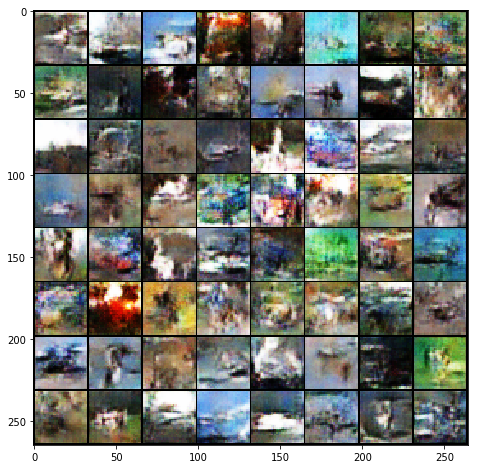

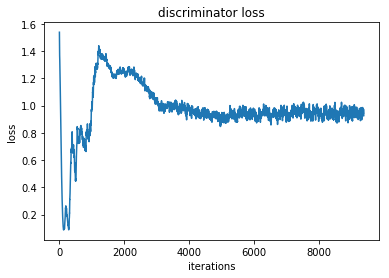

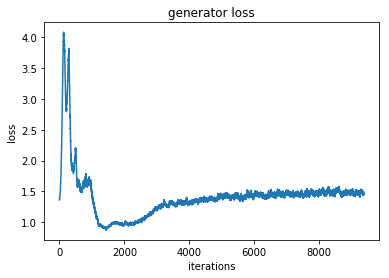

epoch  6
Iteration 9400/156200: dis loss = 1.5034, gen loss = 0.5966
Iteration 9450/156200: dis loss = 0.9286, gen loss = 1.9502
Iteration 9500/156200: dis loss = 0.8434, gen loss = 1.5076
Iteration 9550/156200: dis loss = 0.9152, gen loss = 1.1671
Iteration 9600/156200: dis loss = 0.8447, gen loss = 2.2840
Iteration 9650/156200: dis loss = 0.7210, gen loss = 1.1413
Iteration 9700/156200: dis loss = 0.7177, gen loss = 2.0246
Iteration 9750/156200: dis loss = 0.6373, gen loss = 2.3137
Iteration 9800/156200: dis loss = 0.9879, gen loss = 2.4770
Iteration 9850/156200: dis loss = 0.7873, gen loss = 1.3503
Iteration 9900/156200: dis loss = 0.9092, gen loss = 0.8095
Iteration 9950/156200: dis loss = 1.1485, gen loss = 1.9068
Iteration 10000/156200: dis loss = 1.1115, gen loss = 1.0368
Iteration 10050/156200: dis loss = 0.8106, gen loss = 1.2835
Iteration 10100/156200: dis loss = 1.1064, gen loss = 0.9219
Iteration 10150/156200: dis loss = 1.1617, gen loss = 1.9711
Iteration 10200/156200: dis

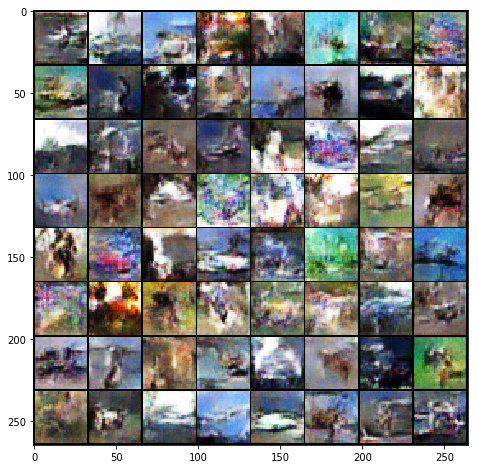

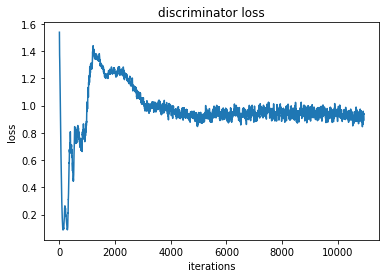

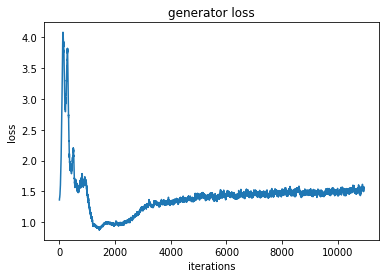

epoch  7
Iteration 10950/156200: dis loss = 0.9140, gen loss = 1.0544
Iteration 11000/156200: dis loss = 0.9189, gen loss = 0.9545
Iteration 11050/156200: dis loss = 0.9287, gen loss = 0.9817
Iteration 11100/156200: dis loss = 0.8372, gen loss = 1.7920
Iteration 11150/156200: dis loss = 1.0408, gen loss = 0.7816
Iteration 11200/156200: dis loss = 0.8151, gen loss = 2.5026
Iteration 11250/156200: dis loss = 0.5375, gen loss = 1.9317
Iteration 11300/156200: dis loss = 0.8319, gen loss = 1.0754
Iteration 11350/156200: dis loss = 0.9669, gen loss = 2.2305
Iteration 11400/156200: dis loss = 0.8827, gen loss = 0.6667
Iteration 11450/156200: dis loss = 1.0573, gen loss = 0.6248
Iteration 11500/156200: dis loss = 0.6911, gen loss = 1.5409
Iteration 11550/156200: dis loss = 0.7256, gen loss = 1.8337
Iteration 11600/156200: dis loss = 0.6232, gen loss = 1.8422
Iteration 11650/156200: dis loss = 0.8817, gen loss = 0.9976
Iteration 11700/156200: dis loss = 0.7399, gen loss = 1.8664
Iteration 11750

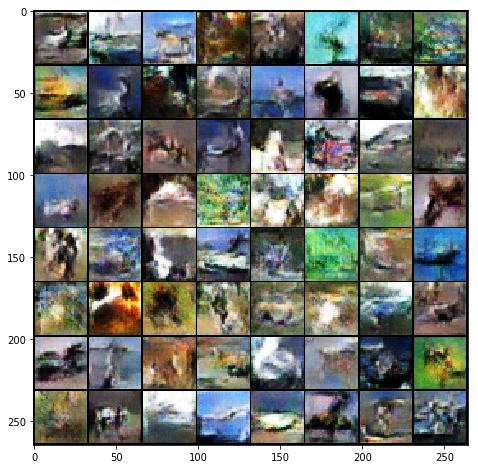

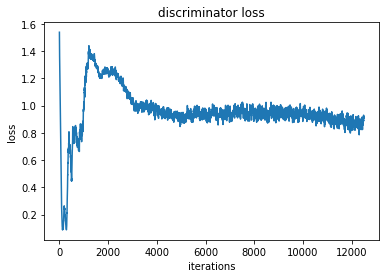

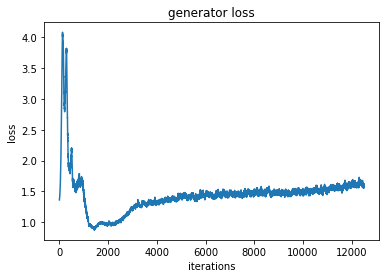

epoch  8
Iteration 12500/156200: dis loss = 0.7992, gen loss = 2.2254
Iteration 12550/156200: dis loss = 0.8706, gen loss = 1.0532
Iteration 12600/156200: dis loss = 0.8087, gen loss = 1.1198
Iteration 12650/156200: dis loss = 1.0639, gen loss = 2.4636
Iteration 12700/156200: dis loss = 0.8682, gen loss = 2.2385
Iteration 12750/156200: dis loss = 0.7451, gen loss = 1.1202
Iteration 12800/156200: dis loss = 1.3094, gen loss = 2.2886
Iteration 12850/156200: dis loss = 0.6973, gen loss = 1.2924
Iteration 12900/156200: dis loss = 0.8694, gen loss = 0.6266
Iteration 12950/156200: dis loss = 0.6352, gen loss = 1.9621
Iteration 13000/156200: dis loss = 0.6721, gen loss = 1.6883
Iteration 13050/156200: dis loss = 0.5678, gen loss = 2.1089
Iteration 13100/156200: dis loss = 0.6175, gen loss = 2.9293
Iteration 13150/156200: dis loss = 1.1920, gen loss = 0.7271
Iteration 13200/156200: dis loss = 0.8639, gen loss = 1.1072
Iteration 13250/156200: dis loss = 0.7921, gen loss = 0.9709
Iteration 13300

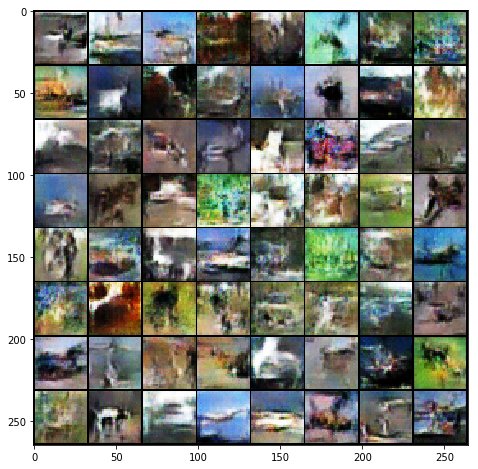

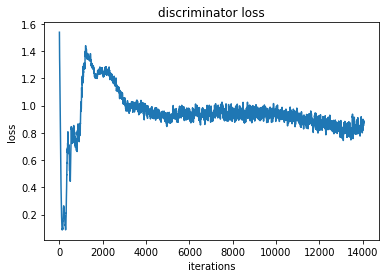

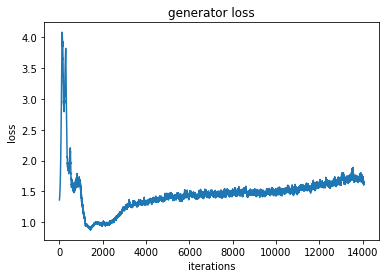

epoch  9
Iteration 14100/156200: dis loss = 0.8953, gen loss = 1.9742
Iteration 14150/156200: dis loss = 0.8772, gen loss = 2.0125
Iteration 14200/156200: dis loss = 1.0404, gen loss = 0.9497
Iteration 14250/156200: dis loss = 0.7252, gen loss = 3.0142
Iteration 14300/156200: dis loss = 0.7090, gen loss = 1.6600
Iteration 14350/156200: dis loss = 0.7164, gen loss = 1.9859
Iteration 14400/156200: dis loss = 0.6811, gen loss = 2.3547
Iteration 14450/156200: dis loss = 0.8307, gen loss = 1.2798
Iteration 14500/156200: dis loss = 0.8706, gen loss = 2.4829
Iteration 14550/156200: dis loss = 0.6804, gen loss = 1.6616
Iteration 14600/156200: dis loss = 0.5722, gen loss = 1.9943
Iteration 14650/156200: dis loss = 0.6442, gen loss = 1.5625
Iteration 14700/156200: dis loss = 0.9434, gen loss = 2.2701
Iteration 14750/156200: dis loss = 1.0778, gen loss = 0.7406
Iteration 14800/156200: dis loss = 0.9958, gen loss = 2.4800
Iteration 14850/156200: dis loss = 1.0395, gen loss = 2.9405
Iteration 14900

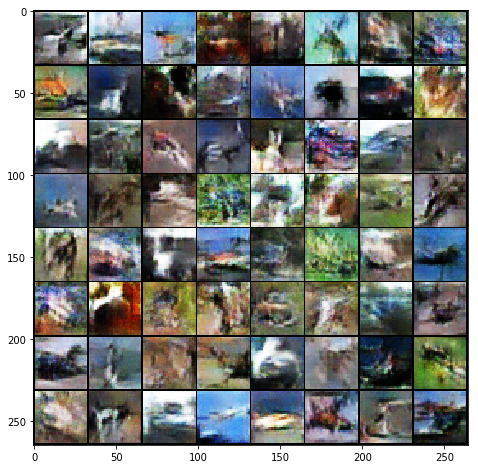

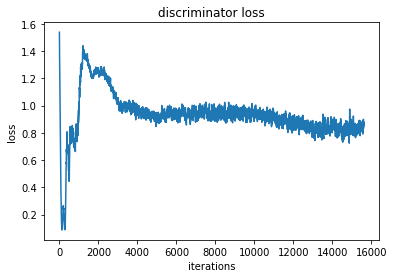

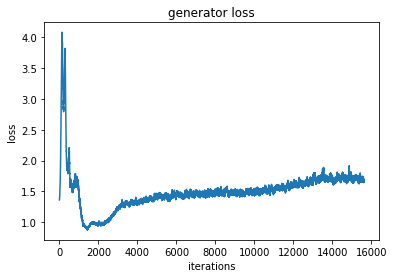

epoch  10
Iteration 15650/156200: dis loss = 0.7080, gen loss = 1.4486
Iteration 15700/156200: dis loss = 1.0754, gen loss = 2.8267
Iteration 15750/156200: dis loss = 0.6481, gen loss = 1.2783
Iteration 15800/156200: dis loss = 0.8383, gen loss = 2.0027
Iteration 15850/156200: dis loss = 1.0016, gen loss = 2.3005
Iteration 15900/156200: dis loss = 0.8397, gen loss = 1.9301
Iteration 15950/156200: dis loss = 0.6860, gen loss = 2.2324
Iteration 16000/156200: dis loss = 0.8888, gen loss = 2.0849
Iteration 16050/156200: dis loss = 0.9756, gen loss = 1.6984
Iteration 16100/156200: dis loss = 0.5459, gen loss = 1.7441
Iteration 16150/156200: dis loss = 0.8828, gen loss = 1.8215
Iteration 16200/156200: dis loss = 0.9707, gen loss = 0.9552
Iteration 16250/156200: dis loss = 0.9250, gen loss = 1.1160
Iteration 16300/156200: dis loss = 0.5846, gen loss = 2.0876
Iteration 16350/156200: dis loss = 0.6467, gen loss = 2.9372
Iteration 16400/156200: dis loss = 0.8139, gen loss = 2.2546
Iteration 1645

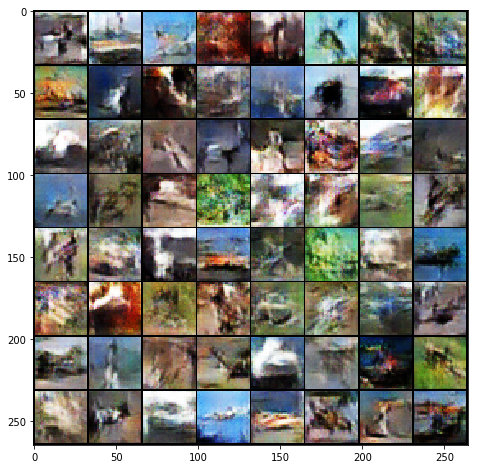

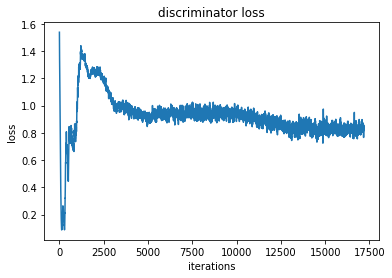

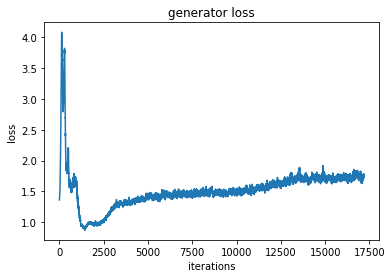

epoch  11
Iteration 17200/156200: dis loss = 0.6811, gen loss = 1.9134
Iteration 17250/156200: dis loss = 0.7027, gen loss = 1.0487
Iteration 17300/156200: dis loss = 0.7361, gen loss = 2.6296
Iteration 17350/156200: dis loss = 0.9383, gen loss = 1.0987
Iteration 17400/156200: dis loss = 0.7632, gen loss = 1.1235
Iteration 17450/156200: dis loss = 0.8891, gen loss = 1.1828
Iteration 17500/156200: dis loss = 0.6005, gen loss = 1.9994
Iteration 17550/156200: dis loss = 0.8246, gen loss = 2.6639
Iteration 17600/156200: dis loss = 0.7232, gen loss = 1.8186
Iteration 17650/156200: dis loss = 0.6135, gen loss = 2.6466
Iteration 17700/156200: dis loss = 0.5284, gen loss = 1.7851
Iteration 17750/156200: dis loss = 0.8871, gen loss = 1.1438
Iteration 17800/156200: dis loss = 0.8491, gen loss = 1.7718
Iteration 17850/156200: dis loss = 0.9624, gen loss = 0.6901
Iteration 17900/156200: dis loss = 1.0496, gen loss = 0.7547
Iteration 17950/156200: dis loss = 0.8133, gen loss = 0.9539
Iteration 1800

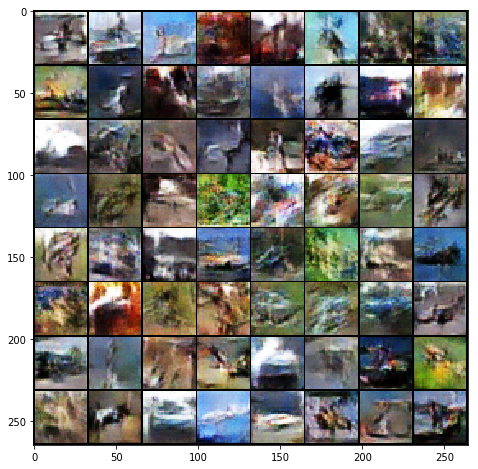

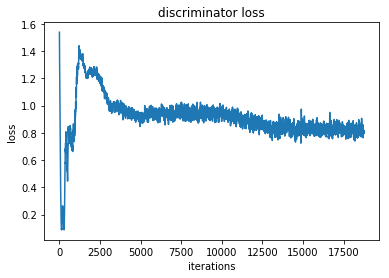

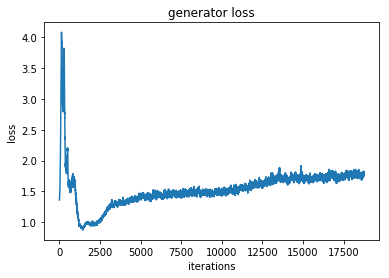

epoch  12
Iteration 18750/156200: dis loss = 0.6277, gen loss = 1.9110
Iteration 18800/156200: dis loss = 0.9179, gen loss = 2.9931
Iteration 18850/156200: dis loss = 0.7435, gen loss = 1.1308
Iteration 18900/156200: dis loss = 0.8381, gen loss = 1.7480
Iteration 18950/156200: dis loss = 0.7269, gen loss = 2.1703
Iteration 19000/156200: dis loss = 0.6911, gen loss = 1.3016
Iteration 19050/156200: dis loss = 0.6362, gen loss = 2.2030
Iteration 19100/156200: dis loss = 0.9318, gen loss = 1.5526
Iteration 19150/156200: dis loss = 0.9366, gen loss = 2.6088
Iteration 19200/156200: dis loss = 0.9173, gen loss = 2.2910
Iteration 19250/156200: dis loss = 0.6209, gen loss = 1.3560
Iteration 19300/156200: dis loss = 0.7957, gen loss = 1.8008
Iteration 19350/156200: dis loss = 0.8676, gen loss = 1.2577
Iteration 19400/156200: dis loss = 0.6863, gen loss = 1.3280
Iteration 19450/156200: dis loss = 0.5541, gen loss = 1.7034
Iteration 19500/156200: dis loss = 0.7454, gen loss = 1.7523
Iteration 1955

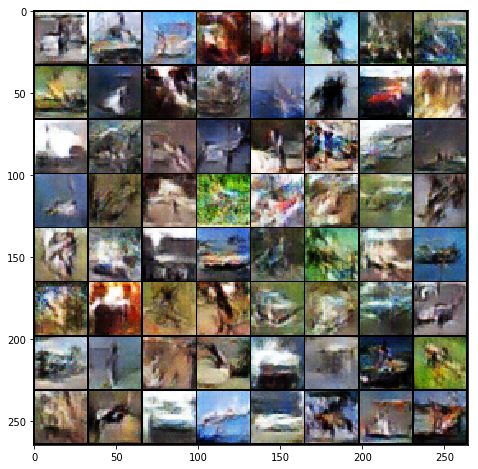

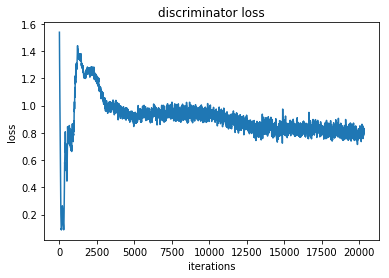

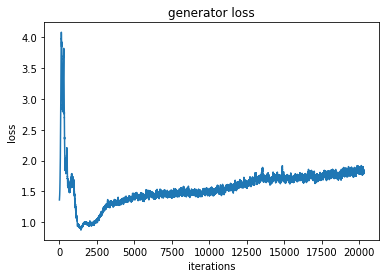

epoch  13
Iteration 20350/156200: dis loss = 0.8522, gen loss = 1.2117
Iteration 20400/156200: dis loss = 0.7320, gen loss = 1.7631
Iteration 20450/156200: dis loss = 0.6080, gen loss = 2.2786
Iteration 20500/156200: dis loss = 0.6580, gen loss = 1.3436
Iteration 20550/156200: dis loss = 0.5679, gen loss = 2.7021
Iteration 20600/156200: dis loss = 0.5764, gen loss = 2.4359
Iteration 20650/156200: dis loss = 0.4973, gen loss = 1.7723
Iteration 20700/156200: dis loss = 1.1423, gen loss = 0.8507
Iteration 20750/156200: dis loss = 0.9582, gen loss = 2.0757
Iteration 20800/156200: dis loss = 0.8862, gen loss = 0.9714
Iteration 20850/156200: dis loss = 0.8140, gen loss = 1.0666
Iteration 20900/156200: dis loss = 0.7809, gen loss = 2.2625
Iteration 20950/156200: dis loss = 0.5458, gen loss = 2.0973
Iteration 21000/156200: dis loss = 0.5180, gen loss = 2.5914
Iteration 21050/156200: dis loss = 0.6823, gen loss = 1.1946
Iteration 21100/156200: dis loss = 0.7077, gen loss = 1.9723
Iteration 2115

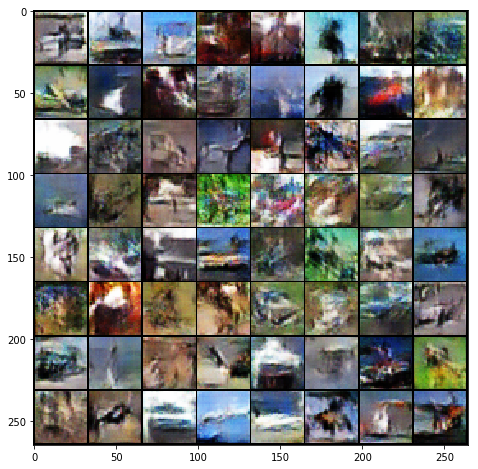

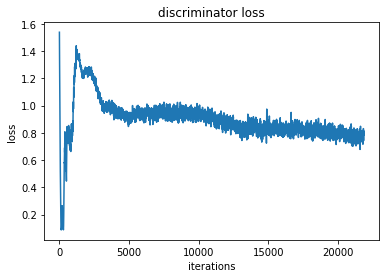

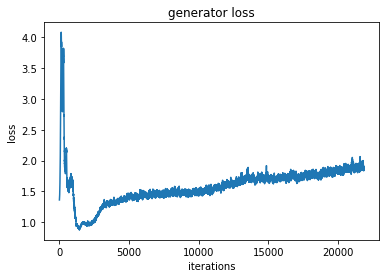

epoch  14
Iteration 21900/156200: dis loss = 0.6293, gen loss = 2.1119
Iteration 21950/156200: dis loss = 0.7349, gen loss = 2.9613
Iteration 22000/156200: dis loss = 1.1901, gen loss = 2.8683
Iteration 22050/156200: dis loss = 0.7612, gen loss = 2.2636
Iteration 22100/156200: dis loss = 1.1288, gen loss = 1.2458
Iteration 22150/156200: dis loss = 0.6953, gen loss = 1.9437
Iteration 22200/156200: dis loss = 0.5697, gen loss = 1.7358
Iteration 22250/156200: dis loss = 0.6285, gen loss = 2.2585
Iteration 22300/156200: dis loss = 0.6293, gen loss = 2.2271
Iteration 22350/156200: dis loss = 0.9694, gen loss = 2.9751
Iteration 22400/156200: dis loss = 1.0879, gen loss = 1.8666
Iteration 22450/156200: dis loss = 0.7245, gen loss = 1.0791
Iteration 22500/156200: dis loss = 1.2428, gen loss = 0.8470
Iteration 22550/156200: dis loss = 0.6814, gen loss = 2.5829
Iteration 22600/156200: dis loss = 0.8250, gen loss = 2.1417
Iteration 22650/156200: dis loss = 0.7434, gen loss = 2.6323
Iteration 2270

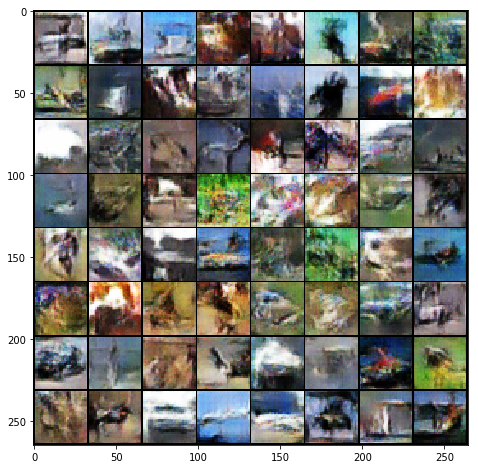

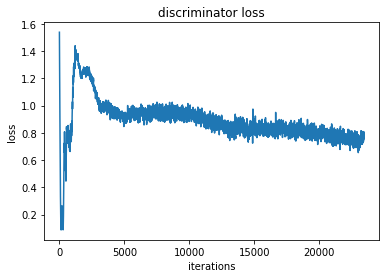

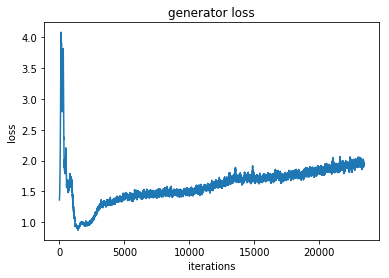

epoch  15
Iteration 23450/156200: dis loss = 0.8175, gen loss = 2.6295
Iteration 23500/156200: dis loss = 0.7043, gen loss = 1.4741
Iteration 23550/156200: dis loss = 0.4671, gen loss = 2.8251
Iteration 23600/156200: dis loss = 0.5507, gen loss = 3.3957
Iteration 23650/156200: dis loss = 0.6444, gen loss = 1.5381
Iteration 23700/156200: dis loss = 0.7683, gen loss = 1.3943
Iteration 23750/156200: dis loss = 0.8132, gen loss = 2.3379
Iteration 23800/156200: dis loss = 0.6663, gen loss = 1.0998
Iteration 23850/156200: dis loss = 1.3696, gen loss = 2.9999
Iteration 23900/156200: dis loss = 0.7858, gen loss = 3.0670
Iteration 23950/156200: dis loss = 0.6253, gen loss = 1.7514
Iteration 24000/156200: dis loss = 1.1391, gen loss = 0.5084
Iteration 24050/156200: dis loss = 0.5448, gen loss = 1.7948
Iteration 24100/156200: dis loss = 0.7069, gen loss = 2.5806
Iteration 24150/156200: dis loss = 0.7477, gen loss = 1.2174
Iteration 24200/156200: dis loss = 0.6216, gen loss = 1.3273
Iteration 2425

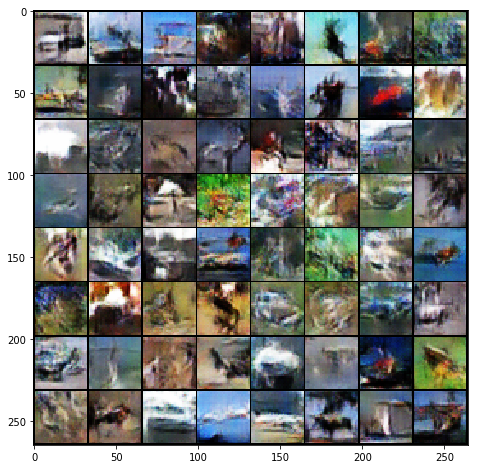

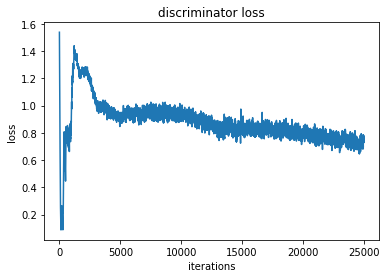

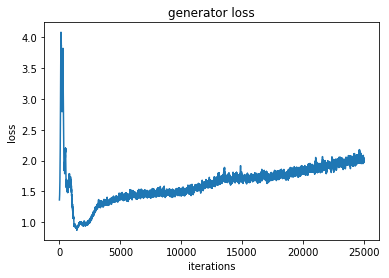

epoch  16
Iteration 25000/156200: dis loss = 0.8744, gen loss = 3.4822
Iteration 25050/156200: dis loss = 0.4151, gen loss = 2.2498
Iteration 25100/156200: dis loss = 0.9753, gen loss = 1.8780
Iteration 25150/156200: dis loss = 0.4353, gen loss = 2.6382
Iteration 25200/156200: dis loss = 0.8434, gen loss = 1.1434
Iteration 25250/156200: dis loss = 1.0810, gen loss = 2.4728
Iteration 25300/156200: dis loss = 0.7058, gen loss = 1.8376
Iteration 25350/156200: dis loss = 0.4850, gen loss = 2.5135
Iteration 25400/156200: dis loss = 0.7728, gen loss = 1.6910
Iteration 25450/156200: dis loss = 0.6680, gen loss = 2.0370
Iteration 25500/156200: dis loss = 0.5984, gen loss = 2.3559
Iteration 25550/156200: dis loss = 0.5592, gen loss = 1.9238
Iteration 25600/156200: dis loss = 0.8126, gen loss = 3.2329
Iteration 25650/156200: dis loss = 0.6719, gen loss = 1.2690
Iteration 25700/156200: dis loss = 1.6028, gen loss = 2.7119
Iteration 25750/156200: dis loss = 0.5333, gen loss = 1.8918
Iteration 2580

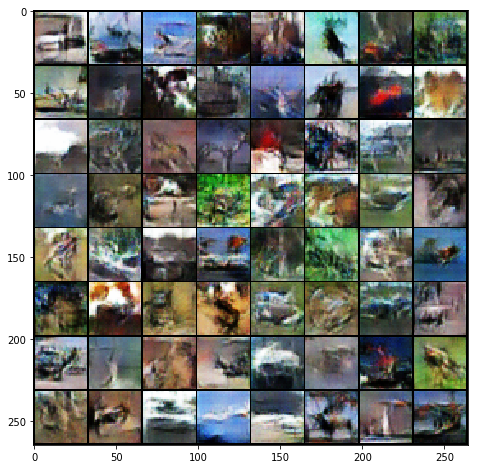

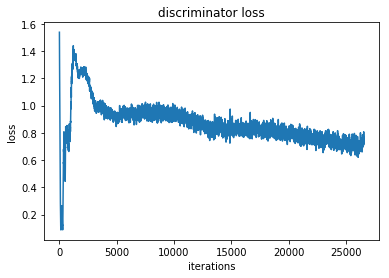

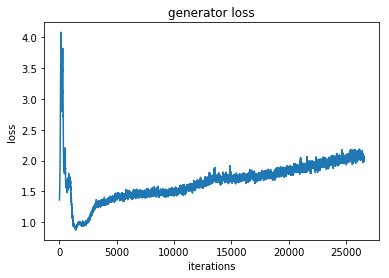

epoch  17
Iteration 26600/156200: dis loss = 0.7249, gen loss = 1.3970
Iteration 26650/156200: dis loss = 0.7538, gen loss = 1.2256
Iteration 26700/156200: dis loss = 0.6775, gen loss = 2.8870
Iteration 26750/156200: dis loss = 1.3922, gen loss = 3.5379
Iteration 26800/156200: dis loss = 1.1104, gen loss = 3.3540
Iteration 26850/156200: dis loss = 0.6493, gen loss = 1.2916
Iteration 26900/156200: dis loss = 0.6541, gen loss = 1.2707
Iteration 26950/156200: dis loss = 0.4541, gen loss = 2.3006
Iteration 27000/156200: dis loss = 0.5601, gen loss = 2.7419
Iteration 27050/156200: dis loss = 0.6961, gen loss = 1.9326
Iteration 27100/156200: dis loss = 0.9989, gen loss = 3.0435
Iteration 27150/156200: dis loss = 0.4348, gen loss = 1.4430
Iteration 27200/156200: dis loss = 0.6801, gen loss = 2.4402
Iteration 27250/156200: dis loss = 0.6714, gen loss = 2.8839
Iteration 27300/156200: dis loss = 0.3943, gen loss = 2.1253
Iteration 27350/156200: dis loss = 0.6174, gen loss = 2.0832
Iteration 2740

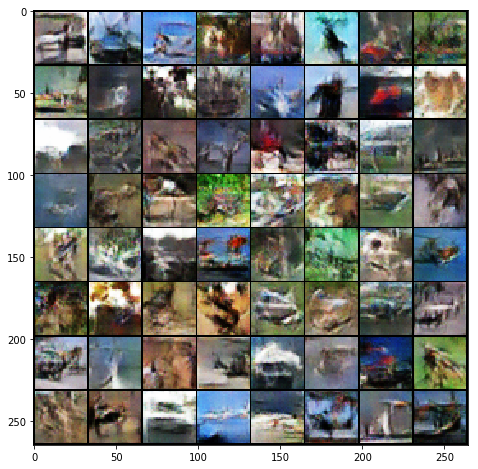

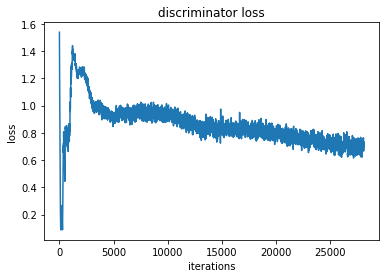

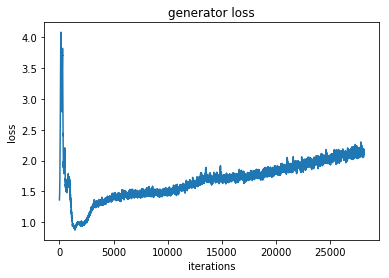

epoch  18
Iteration 28150/156200: dis loss = 1.0112, gen loss = 2.5618
Iteration 28200/156200: dis loss = 0.5886, gen loss = 3.2916
Iteration 28250/156200: dis loss = 0.4622, gen loss = 1.7293
Iteration 28300/156200: dis loss = 1.0856, gen loss = 0.9470
Iteration 28350/156200: dis loss = 0.6784, gen loss = 2.8116
Iteration 28400/156200: dis loss = 0.3770, gen loss = 2.7886
Iteration 28450/156200: dis loss = 0.8672, gen loss = 2.7551
Iteration 28500/156200: dis loss = 0.3804, gen loss = 2.4428
Iteration 28550/156200: dis loss = 0.7475, gen loss = 1.1068
Iteration 28600/156200: dis loss = 0.6655, gen loss = 2.0175
Iteration 28650/156200: dis loss = 0.3716, gen loss = 2.5162
Iteration 28700/156200: dis loss = 0.6949, gen loss = 1.3470
Iteration 28750/156200: dis loss = 0.9700, gen loss = 1.1445
Iteration 28800/156200: dis loss = 1.4117, gen loss = 3.4471
Iteration 28850/156200: dis loss = 0.8471, gen loss = 1.5039
Iteration 28900/156200: dis loss = 0.6123, gen loss = 2.3053
Iteration 2895

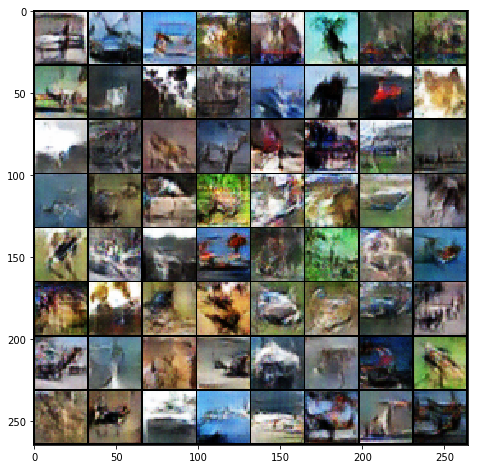

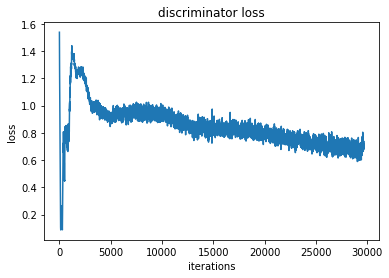

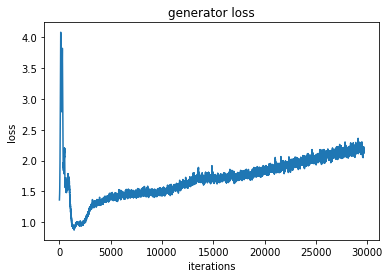

epoch  19
Iteration 29700/156200: dis loss = 0.8067, gen loss = 1.8151
Iteration 29750/156200: dis loss = 0.8170, gen loss = 1.4873
Iteration 29800/156200: dis loss = 0.4225, gen loss = 2.2589
Iteration 29850/156200: dis loss = 0.8506, gen loss = 1.1185
Iteration 29900/156200: dis loss = 0.7899, gen loss = 2.7929
Iteration 29950/156200: dis loss = 0.6253, gen loss = 1.2568
Iteration 30000/156200: dis loss = 0.6839, gen loss = 2.1940
Iteration 30050/156200: dis loss = 0.7376, gen loss = 4.0322
Iteration 30100/156200: dis loss = 0.4550, gen loss = 2.4849
Iteration 30150/156200: dis loss = 0.4589, gen loss = 2.3474
Iteration 30200/156200: dis loss = 0.4867, gen loss = 3.1536
Iteration 30250/156200: dis loss = 0.3793, gen loss = 2.5592
Iteration 30300/156200: dis loss = 1.4915, gen loss = 0.4391
Iteration 30350/156200: dis loss = 0.7725, gen loss = 1.3608
Iteration 30400/156200: dis loss = 0.5195, gen loss = 1.9212
Iteration 30450/156200: dis loss = 0.4759, gen loss = 2.3233
Iteration 3050

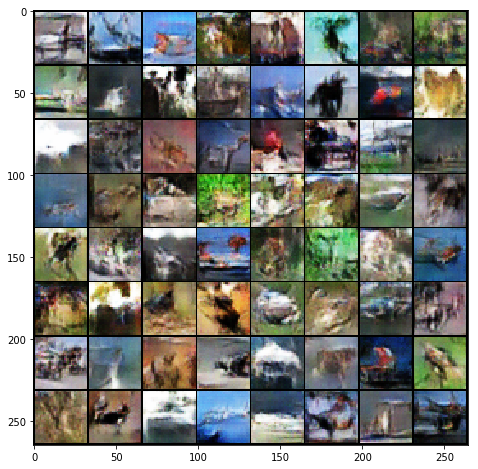

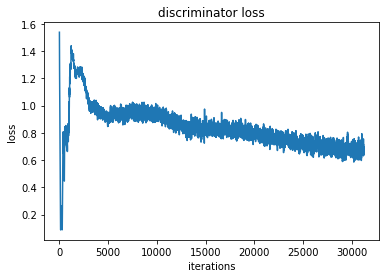

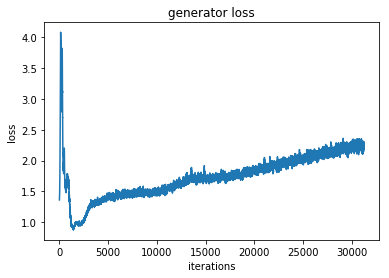

epoch  20
Iteration 31250/156200: dis loss = 0.5202, gen loss = 2.4448
Iteration 31300/156200: dis loss = 0.6015, gen loss = 1.6821
Iteration 31350/156200: dis loss = 0.6812, gen loss = 3.5963
Iteration 31400/156200: dis loss = 0.6009, gen loss = 1.7890
Iteration 31450/156200: dis loss = 0.4670, gen loss = 1.8403
Iteration 31500/156200: dis loss = 0.4053, gen loss = 2.9463
Iteration 31550/156200: dis loss = 0.8630, gen loss = 3.3849
Iteration 31600/156200: dis loss = 0.6547, gen loss = 1.7725
Iteration 31650/156200: dis loss = 0.6446, gen loss = 3.4605
Iteration 31700/156200: dis loss = 0.5922, gen loss = 1.9113
Iteration 31750/156200: dis loss = 0.7458, gen loss = 3.2824
Iteration 31800/156200: dis loss = 0.9807, gen loss = 1.1127
Iteration 31850/156200: dis loss = 0.7323, gen loss = 3.0130
Iteration 31900/156200: dis loss = 0.5792, gen loss = 1.7486
Iteration 31950/156200: dis loss = 0.7320, gen loss = 3.2731
Iteration 32000/156200: dis loss = 0.5126, gen loss = 1.9499
Iteration 3205

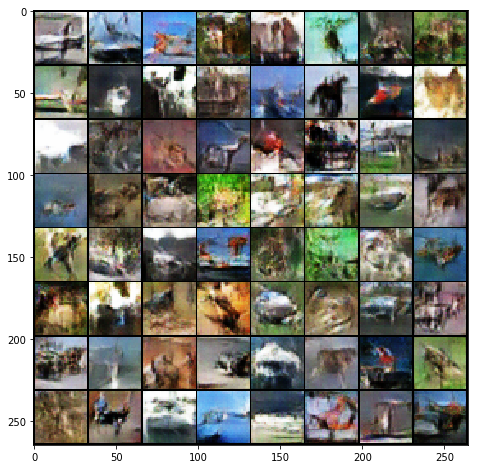

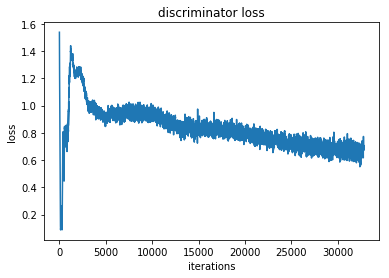

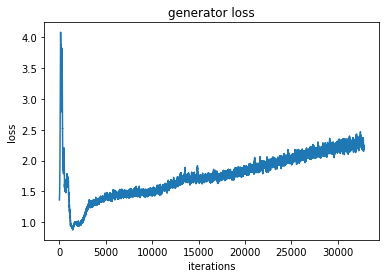

epoch  21
Iteration 32850/156200: dis loss = 0.3810, gen loss = 2.2592
Iteration 32900/156200: dis loss = 0.7385, gen loss = 3.0495
Iteration 32950/156200: dis loss = 0.4698, gen loss = 1.6122
Iteration 33000/156200: dis loss = 0.5678, gen loss = 2.8043
Iteration 33050/156200: dis loss = 0.7177, gen loss = 3.0783
Iteration 33100/156200: dis loss = 0.2944, gen loss = 2.3872
Iteration 33150/156200: dis loss = 0.8859, gen loss = 3.5146
Iteration 33200/156200: dis loss = 0.7215, gen loss = 2.9871
Iteration 33250/156200: dis loss = 1.1066, gen loss = 4.1956
Iteration 33300/156200: dis loss = 0.5242, gen loss = 2.2720
Iteration 33350/156200: dis loss = 0.7367, gen loss = 3.0068
Iteration 33400/156200: dis loss = 0.7062, gen loss = 3.4928
Iteration 33450/156200: dis loss = 0.6452, gen loss = 3.3243
Iteration 33500/156200: dis loss = 0.4087, gen loss = 1.9982
Iteration 33550/156200: dis loss = 0.6029, gen loss = 2.3886
Iteration 33600/156200: dis loss = 0.8068, gen loss = 1.1862
Iteration 3365

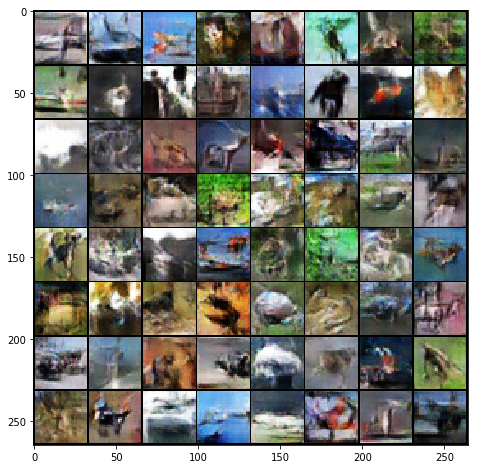

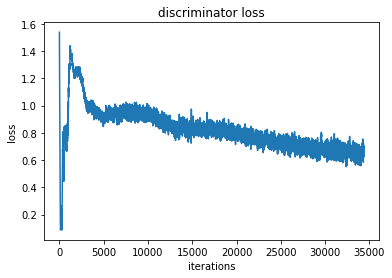

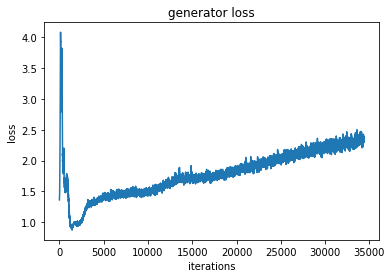

epoch  22
Iteration 34400/156200: dis loss = 0.5960, gen loss = 2.4202
Iteration 34450/156200: dis loss = 0.9278, gen loss = 4.0140
Iteration 34500/156200: dis loss = 0.5039, gen loss = 2.1972
Iteration 34550/156200: dis loss = 0.9078, gen loss = 3.4525
Iteration 34600/156200: dis loss = 0.7868, gen loss = 1.5959
Iteration 34650/156200: dis loss = 0.5395, gen loss = 3.3802
Iteration 34700/156200: dis loss = 0.8576, gen loss = 1.5620
Iteration 34750/156200: dis loss = 0.4875, gen loss = 2.9505
Iteration 34800/156200: dis loss = 0.6030, gen loss = 2.4728
Iteration 34850/156200: dis loss = 0.4578, gen loss = 2.2016
Iteration 34900/156200: dis loss = 0.8589, gen loss = 1.4278
Iteration 34950/156200: dis loss = 0.6293, gen loss = 2.1319
Iteration 35000/156200: dis loss = 0.4685, gen loss = 1.9353
Iteration 35050/156200: dis loss = 0.6392, gen loss = 1.7609
Iteration 35100/156200: dis loss = 0.4262, gen loss = 3.2535
Iteration 35150/156200: dis loss = 0.3403, gen loss = 2.5175
Iteration 3520

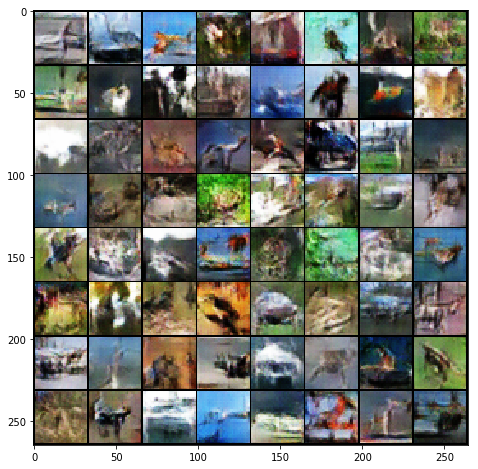

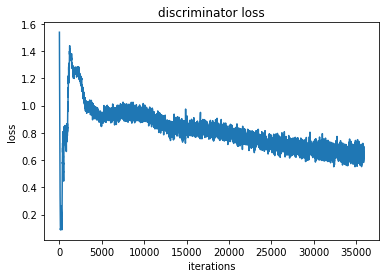

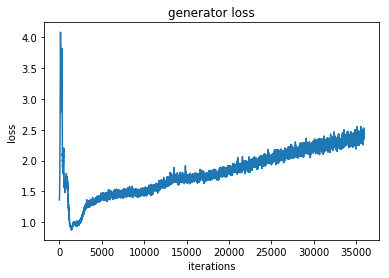

epoch  23
Iteration 35950/156200: dis loss = 0.6587, gen loss = 3.7331
Iteration 36000/156200: dis loss = 0.4329, gen loss = 2.4591
Iteration 36050/156200: dis loss = 0.6574, gen loss = 1.3372
Iteration 36100/156200: dis loss = 0.2851, gen loss = 2.6350
Iteration 36150/156200: dis loss = 0.6581, gen loss = 1.3761
Iteration 36200/156200: dis loss = 0.6442, gen loss = 2.9629
Iteration 36250/156200: dis loss = 0.5375, gen loss = 2.0731
Iteration 36300/156200: dis loss = 0.6649, gen loss = 3.6442
Iteration 36350/156200: dis loss = 0.6177, gen loss = 3.4308
Iteration 36400/156200: dis loss = 0.4046, gen loss = 3.1898
Iteration 36450/156200: dis loss = 0.5834, gen loss = 3.8254
Iteration 36500/156200: dis loss = 0.9187, gen loss = 3.5596
Iteration 36550/156200: dis loss = 1.0530, gen loss = 3.8107
Iteration 36600/156200: dis loss = 0.8293, gen loss = 1.2259
Iteration 36650/156200: dis loss = 0.4508, gen loss = 2.8678
Iteration 36700/156200: dis loss = 0.3604, gen loss = 2.6143
Iteration 3675

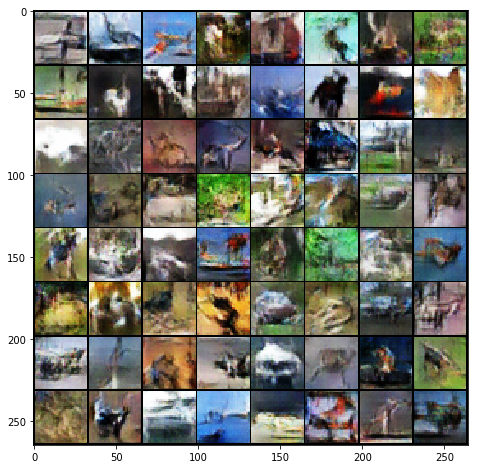

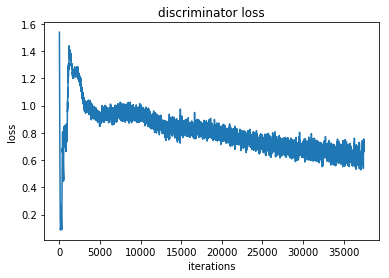

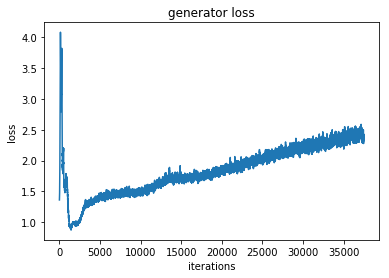

epoch  24
Iteration 37500/156200: dis loss = 0.5162, gen loss = 1.6546
Iteration 37550/156200: dis loss = 0.7300, gen loss = 1.2525
Iteration 37600/156200: dis loss = 0.4260, gen loss = 2.1368
Iteration 37650/156200: dis loss = 0.2518, gen loss = 2.6649
Iteration 37700/156200: dis loss = 0.3821, gen loss = 2.7024
Iteration 37750/156200: dis loss = 0.3231, gen loss = 2.4281
Iteration 37800/156200: dis loss = 0.5777, gen loss = 2.2278
Iteration 37850/156200: dis loss = 0.4919, gen loss = 1.9077
Iteration 37900/156200: dis loss = 0.7623, gen loss = 4.1107
Iteration 37950/156200: dis loss = 0.5666, gen loss = 3.4513
Iteration 38000/156200: dis loss = 0.5965, gen loss = 2.4795
Iteration 38050/156200: dis loss = 0.6538, gen loss = 3.2925
Iteration 38100/156200: dis loss = 0.5902, gen loss = 1.8049
Iteration 38150/156200: dis loss = 0.7199, gen loss = 2.9615
Iteration 38200/156200: dis loss = 0.6038, gen loss = 3.4803
Iteration 38250/156200: dis loss = 0.4226, gen loss = 3.7619
Iteration 3830

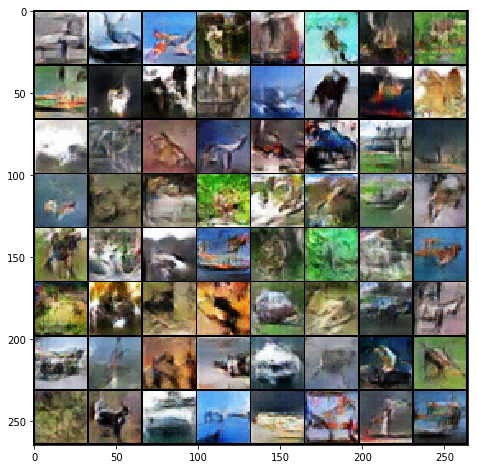

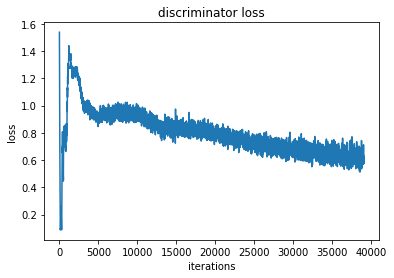

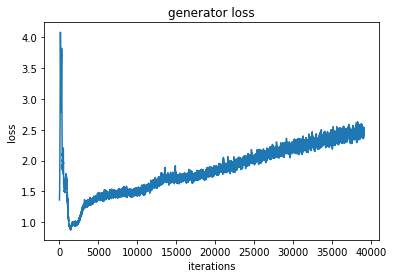

epoch  25
Iteration 39100/156200: dis loss = 0.8309, gen loss = 2.9830
Iteration 39150/156200: dis loss = 0.9203, gen loss = 4.1111
Iteration 39200/156200: dis loss = 0.4031, gen loss = 2.2394
Iteration 39250/156200: dis loss = 0.3149, gen loss = 2.5424
Iteration 39300/156200: dis loss = 0.3962, gen loss = 3.3991
Iteration 39350/156200: dis loss = 0.4335, gen loss = 2.3365
Iteration 39400/156200: dis loss = 0.4006, gen loss = 2.7400
Iteration 39450/156200: dis loss = 1.0089, gen loss = 2.5099
Iteration 39500/156200: dis loss = 0.5149, gen loss = 2.0632
Iteration 39550/156200: dis loss = 0.4991, gen loss = 2.0400
Iteration 39600/156200: dis loss = 0.4847, gen loss = 3.2217
Iteration 39650/156200: dis loss = 1.2018, gen loss = 3.6700
Iteration 39700/156200: dis loss = 0.5533, gen loss = 3.1573
Iteration 39750/156200: dis loss = 0.9906, gen loss = 3.0333
Iteration 39800/156200: dis loss = 0.3090, gen loss = 2.2238
Iteration 39850/156200: dis loss = 0.3198, gen loss = 2.3813
Iteration 3990

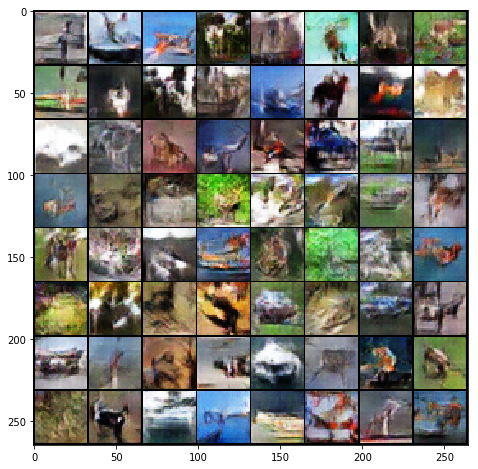

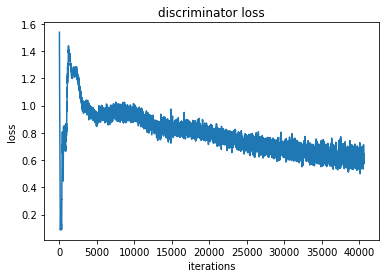

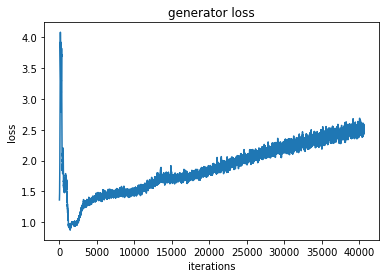

epoch  26
Iteration 40650/156200: dis loss = 0.8988, gen loss = 1.4847
Iteration 40700/156200: dis loss = 0.7567, gen loss = 3.5204
Iteration 40750/156200: dis loss = 0.6337, gen loss = 1.9060
Iteration 40800/156200: dis loss = 0.4155, gen loss = 2.0106
Iteration 40850/156200: dis loss = 0.3598, gen loss = 2.8028
Iteration 40900/156200: dis loss = 0.9644, gen loss = 3.4172
Iteration 40950/156200: dis loss = 0.5093, gen loss = 1.6175
Iteration 41000/156200: dis loss = 0.6262, gen loss = 2.9423
Iteration 41050/156200: dis loss = 0.8627, gen loss = 1.3399
Iteration 41100/156200: dis loss = 1.2621, gen loss = 0.7723
Iteration 41150/156200: dis loss = 0.4733, gen loss = 1.6740
Iteration 41200/156200: dis loss = 0.5256, gen loss = 1.6220
Iteration 41250/156200: dis loss = 0.6889, gen loss = 1.8332
Iteration 41300/156200: dis loss = 0.5356, gen loss = 3.1356
Iteration 41350/156200: dis loss = 0.4797, gen loss = 2.8170
Iteration 41400/156200: dis loss = 0.3269, gen loss = 2.3827
Iteration 4145

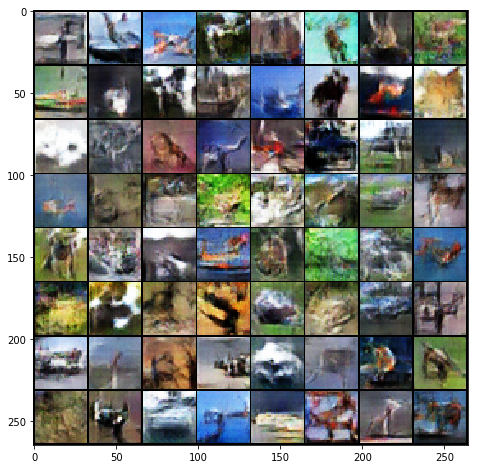

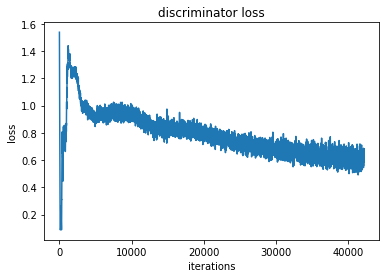

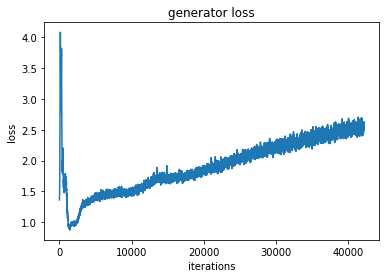

epoch  27
Iteration 42200/156200: dis loss = 0.8174, gen loss = 0.9811
Iteration 42250/156200: dis loss = 1.3002, gen loss = 4.3504
Iteration 42300/156200: dis loss = 0.4941, gen loss = 3.1365
Iteration 42350/156200: dis loss = 0.6467, gen loss = 1.8916
Iteration 42400/156200: dis loss = 0.9478, gen loss = 1.2470
Iteration 42450/156200: dis loss = 0.5925, gen loss = 2.7999
Iteration 42500/156200: dis loss = 0.5492, gen loss = 1.4322
Iteration 42550/156200: dis loss = 1.0842, gen loss = 4.1953
Iteration 42600/156200: dis loss = 0.4769, gen loss = 4.0017
Iteration 42650/156200: dis loss = 0.5756, gen loss = 2.5919
Iteration 42700/156200: dis loss = 0.4910, gen loss = 2.4023
Iteration 42750/156200: dis loss = 0.6107, gen loss = 3.7336
Iteration 42800/156200: dis loss = 0.7466, gen loss = 1.1194
Iteration 42850/156200: dis loss = 0.3662, gen loss = 2.5340
Iteration 42900/156200: dis loss = 0.7148, gen loss = 3.4332
Iteration 42950/156200: dis loss = 0.5474, gen loss = 2.9371
Iteration 4300

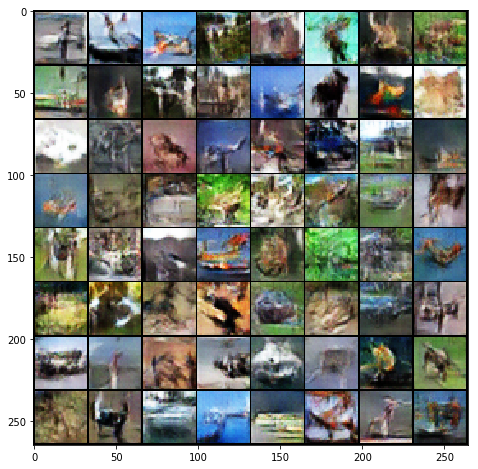

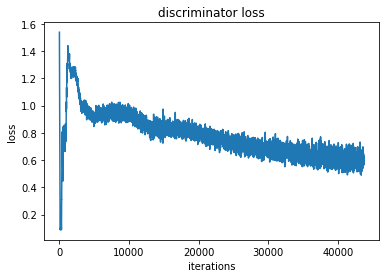

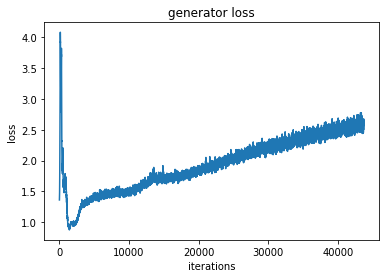

epoch  28
Iteration 43750/156200: dis loss = 0.6477, gen loss = 1.4168
Iteration 43800/156200: dis loss = 0.6703, gen loss = 1.3897
Iteration 43850/156200: dis loss = 0.3414, gen loss = 2.6542
Iteration 43900/156200: dis loss = 0.5529, gen loss = 3.1738
Iteration 43950/156200: dis loss = 0.3831, gen loss = 3.0323
Iteration 44000/156200: dis loss = 0.6056, gen loss = 1.5136
Iteration 44050/156200: dis loss = 0.5807, gen loss = 1.4387
Iteration 44100/156200: dis loss = 0.3494, gen loss = 2.4067
Iteration 44150/156200: dis loss = 0.7317, gen loss = 4.6125
Iteration 44200/156200: dis loss = 0.5338, gen loss = 1.8657
Iteration 44250/156200: dis loss = 0.4383, gen loss = 2.8759
Iteration 44300/156200: dis loss = 0.8942, gen loss = 3.9434
Iteration 44350/156200: dis loss = 0.4028, gen loss = 2.2320
Iteration 44400/156200: dis loss = 0.5287, gen loss = 1.9728
Iteration 44450/156200: dis loss = 0.5944, gen loss = 1.3197
Iteration 44500/156200: dis loss = 0.6450, gen loss = 1.1613
Iteration 4455

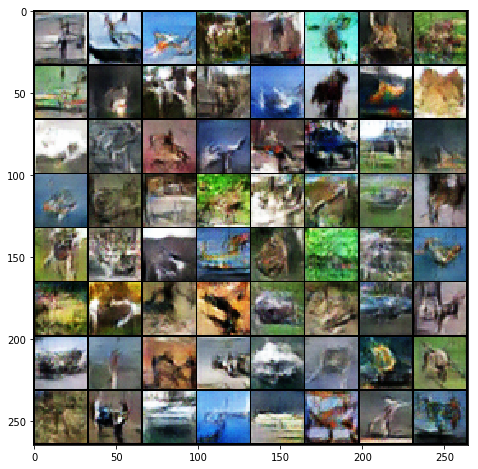

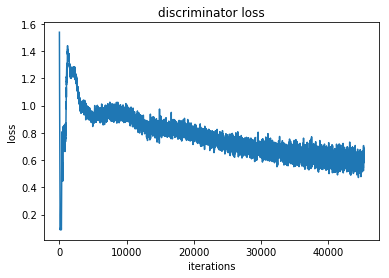

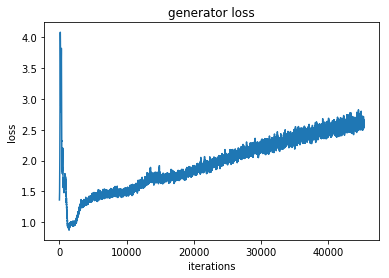

epoch  29
Iteration 45300/156200: dis loss = 0.5454, gen loss = 1.7303
Iteration 45350/156200: dis loss = 0.5814, gen loss = 1.7036
Iteration 45400/156200: dis loss = 0.3045, gen loss = 2.6049
Iteration 45450/156200: dis loss = 0.7510, gen loss = 2.8969
Iteration 45500/156200: dis loss = 0.3702, gen loss = 3.5875
Iteration 45550/156200: dis loss = 0.5516, gen loss = 2.4653
Iteration 45600/156200: dis loss = 0.6697, gen loss = 2.9275
Iteration 45650/156200: dis loss = 0.5263, gen loss = 3.6561
Iteration 45700/156200: dis loss = 0.7130, gen loss = 1.4143
Iteration 45750/156200: dis loss = 0.3153, gen loss = 2.9661
Iteration 45800/156200: dis loss = 0.5149, gen loss = 2.4370
Iteration 45850/156200: dis loss = 0.5207, gen loss = 2.3407
Iteration 45900/156200: dis loss = 0.3145, gen loss = 2.7842
Iteration 45950/156200: dis loss = 0.6727, gen loss = 3.0648
Iteration 46000/156200: dis loss = 0.5388, gen loss = 3.5591
Iteration 46050/156200: dis loss = 0.5416, gen loss = 1.7916
Iteration 4610

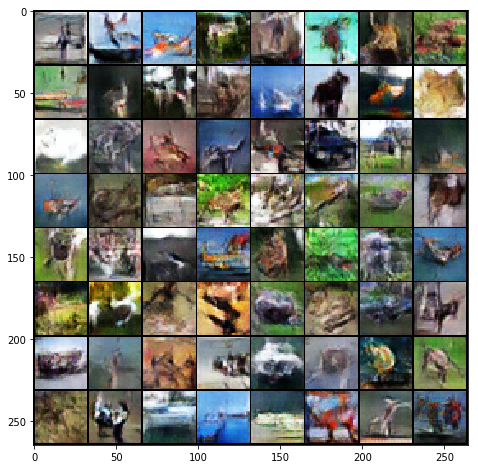

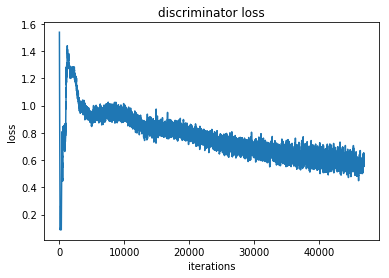

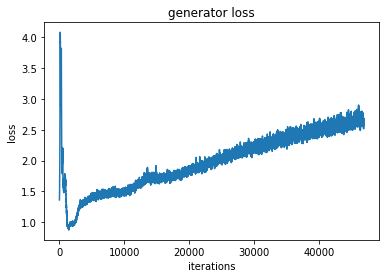

epoch  30
Iteration 46900/156200: dis loss = 0.6388, gen loss = 1.3048
Iteration 46950/156200: dis loss = 0.5415, gen loss = 3.8802
Iteration 47000/156200: dis loss = 0.7555, gen loss = 3.9043
Iteration 47050/156200: dis loss = 0.5476, gen loss = 1.7715
Iteration 47100/156200: dis loss = 0.4775, gen loss = 2.6258
Iteration 47150/156200: dis loss = 0.4509, gen loss = 1.9057
Iteration 47200/156200: dis loss = 1.1708, gen loss = 1.0967
Iteration 47250/156200: dis loss = 1.1716, gen loss = 1.0523
Iteration 47300/156200: dis loss = 0.7165, gen loss = 3.0948
Iteration 47350/156200: dis loss = 0.4440, gen loss = 1.9916
Iteration 47400/156200: dis loss = 0.3728, gen loss = 3.5199
Iteration 47450/156200: dis loss = 0.5040, gen loss = 2.4765
Iteration 47500/156200: dis loss = 0.3311, gen loss = 2.4892
Iteration 47550/156200: dis loss = 0.5463, gen loss = 2.9433
Iteration 47600/156200: dis loss = 0.6200, gen loss = 4.1557
Iteration 47650/156200: dis loss = 0.3318, gen loss = 2.9042
Iteration 4770

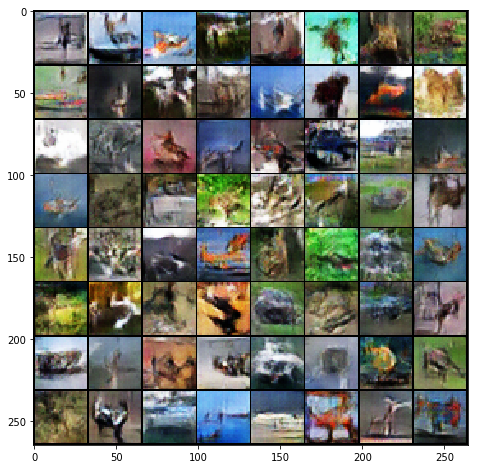

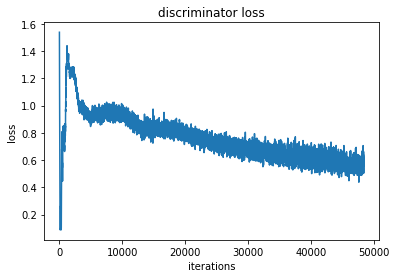

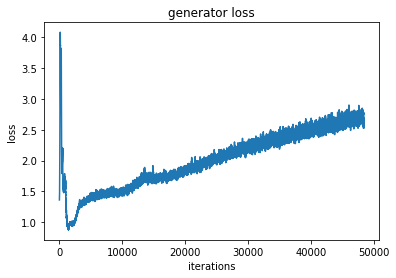

epoch  31
Iteration 48450/156200: dis loss = 0.3992, gen loss = 2.6034
Iteration 48500/156200: dis loss = 0.5044, gen loss = 1.8478
Iteration 48550/156200: dis loss = 0.4970, gen loss = 1.9937
Iteration 48600/156200: dis loss = 0.9083, gen loss = 4.1457
Iteration 48650/156200: dis loss = 0.4251, gen loss = 2.0990
Iteration 48700/156200: dis loss = 0.4853, gen loss = 3.5393
Iteration 48750/156200: dis loss = 0.4198, gen loss = 2.8191
Iteration 48800/156200: dis loss = 0.3393, gen loss = 4.0633
Iteration 48850/156200: dis loss = 0.3986, gen loss = 1.9106
Iteration 48900/156200: dis loss = 0.5613, gen loss = 1.6330
Iteration 48950/156200: dis loss = 0.4633, gen loss = 3.5226
Iteration 49000/156200: dis loss = 0.6124, gen loss = 2.8663
Iteration 49050/156200: dis loss = 0.3642, gen loss = 2.9868
Iteration 49100/156200: dis loss = 0.4010, gen loss = 2.0754
Iteration 49150/156200: dis loss = 0.8146, gen loss = 3.6459
Iteration 49200/156200: dis loss = 0.7647, gen loss = 3.4035
Iteration 4925

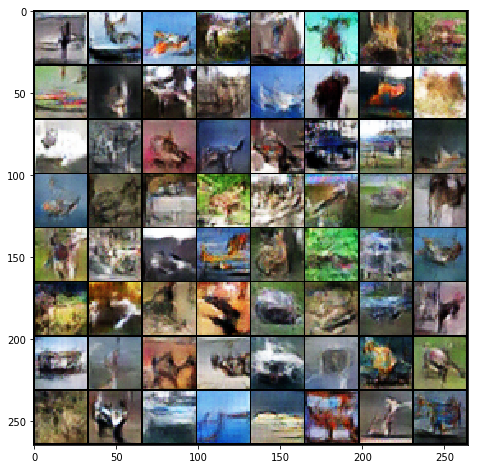

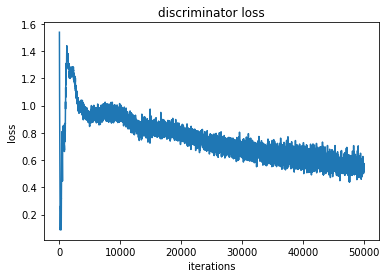

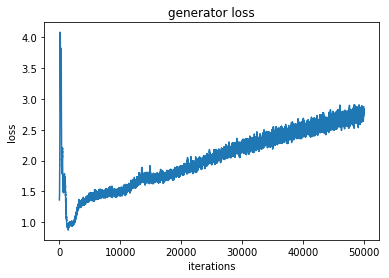

epoch  32
Iteration 50000/156200: dis loss = 0.3600, gen loss = 3.2229
Iteration 50050/156200: dis loss = 0.3880, gen loss = 2.3592
Iteration 50100/156200: dis loss = 0.3151, gen loss = 2.5891
Iteration 50150/156200: dis loss = 0.5815, gen loss = 2.0158
Iteration 50200/156200: dis loss = 0.5285, gen loss = 3.1290
Iteration 50250/156200: dis loss = 0.2953, gen loss = 2.9287
Iteration 50300/156200: dis loss = 0.2986, gen loss = 2.6968
Iteration 50350/156200: dis loss = 0.4136, gen loss = 3.3340
Iteration 50400/156200: dis loss = 0.3432, gen loss = 3.0197
Iteration 50450/156200: dis loss = 0.3568, gen loss = 2.7223
Iteration 50500/156200: dis loss = 0.7125, gen loss = 4.4111
Iteration 50550/156200: dis loss = 0.2028, gen loss = 3.0887
Iteration 50600/156200: dis loss = 0.3480, gen loss = 2.2636
Iteration 50650/156200: dis loss = 0.4862, gen loss = 1.9399
Iteration 50700/156200: dis loss = 0.9563, gen loss = 1.2757
Iteration 50750/156200: dis loss = 0.3771, gen loss = 2.5743
Iteration 5080

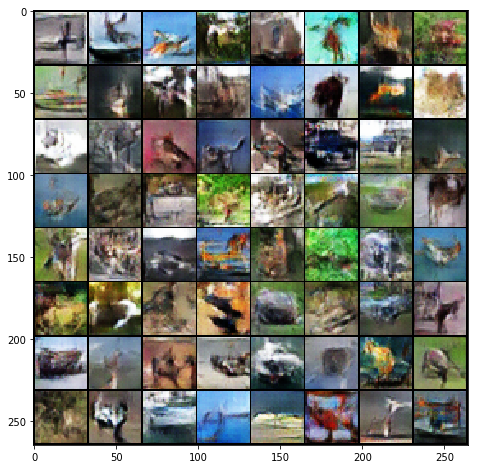

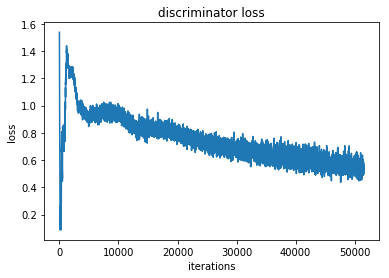

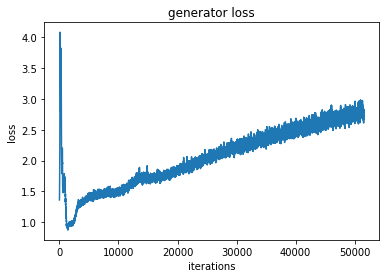

epoch  33
Iteration 51550/156200: dis loss = 0.2571, gen loss = 2.7983
Iteration 51600/156200: dis loss = 0.1997, gen loss = 3.3408
Iteration 51650/156200: dis loss = 0.3863, gen loss = 2.2385
Iteration 51700/156200: dis loss = 0.6066, gen loss = 3.6376
Iteration 51750/156200: dis loss = 0.3737, gen loss = 2.4219
Iteration 51800/156200: dis loss = 0.4251, gen loss = 3.2262
Iteration 51850/156200: dis loss = 0.5190, gen loss = 2.0282
Iteration 51900/156200: dis loss = 0.4150, gen loss = 2.1179
Iteration 51950/156200: dis loss = 0.1869, gen loss = 3.4641
Iteration 52000/156200: dis loss = 0.5548, gen loss = 3.2410
Iteration 52050/156200: dis loss = 0.5983, gen loss = 1.9878
Iteration 52100/156200: dis loss = 1.5083, gen loss = 4.3868
Iteration 52150/156200: dis loss = 0.4542, gen loss = 2.8885
Iteration 52200/156200: dis loss = 0.4306, gen loss = 2.7367
Iteration 52250/156200: dis loss = 0.3289, gen loss = 2.6013
Iteration 52300/156200: dis loss = 0.3706, gen loss = 3.4332
Iteration 5235

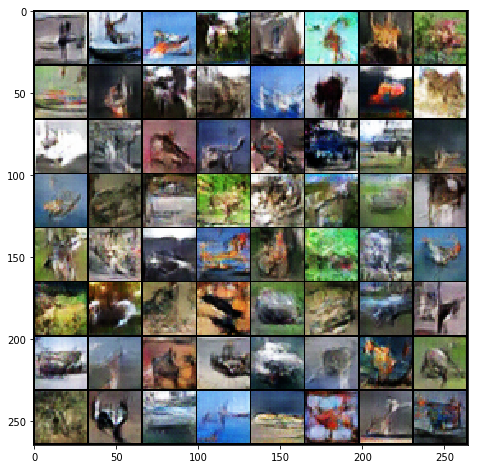

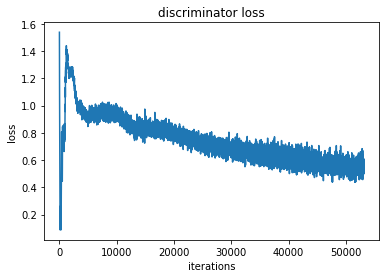

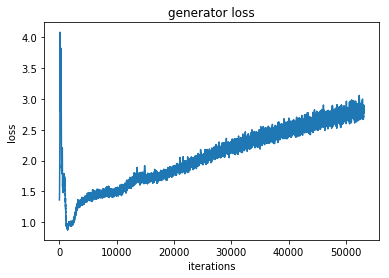

epoch  34
Iteration 53150/156200: dis loss = 0.5689, gen loss = 2.1429
Iteration 53200/156200: dis loss = 0.7586, gen loss = 1.3881
Iteration 53250/156200: dis loss = 0.6733, gen loss = 1.3131
Iteration 53300/156200: dis loss = 0.6274, gen loss = 4.2064
Iteration 53350/156200: dis loss = 0.7073, gen loss = 1.5521
Iteration 53400/156200: dis loss = 0.3191, gen loss = 2.2397
Iteration 53450/156200: dis loss = 0.4369, gen loss = 2.2438
Iteration 53500/156200: dis loss = 0.9636, gen loss = 0.5929
Iteration 53550/156200: dis loss = 0.3139, gen loss = 2.8538
Iteration 53600/156200: dis loss = 0.2688, gen loss = 2.7321
Iteration 53650/156200: dis loss = 0.4009, gen loss = 2.4403
Iteration 53700/156200: dis loss = 0.7395, gen loss = 4.2538
Iteration 53750/156200: dis loss = 0.6746, gen loss = 1.4792
Iteration 53800/156200: dis loss = 0.4884, gen loss = 2.1312
Iteration 53850/156200: dis loss = 0.8732, gen loss = 3.5914
Iteration 53900/156200: dis loss = 0.3409, gen loss = 2.3138
Iteration 5395

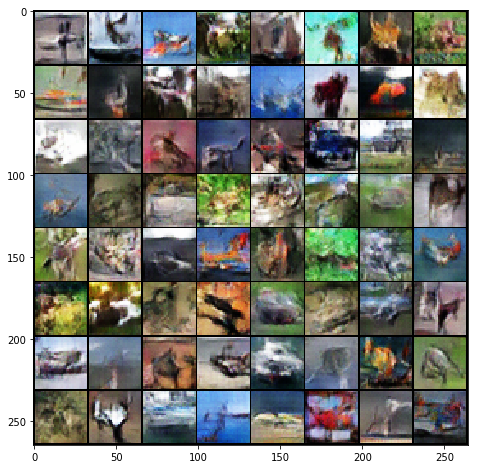

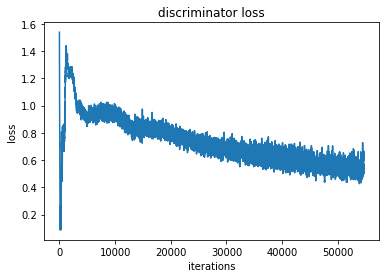

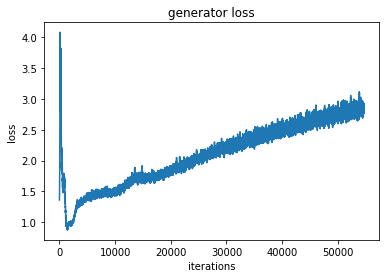

epoch  35
Iteration 54700/156200: dis loss = 0.3212, gen loss = 2.9079
Iteration 54750/156200: dis loss = 0.4732, gen loss = 4.1359
Iteration 54800/156200: dis loss = 0.3868, gen loss = 2.0278
Iteration 54850/156200: dis loss = 0.5312, gen loss = 2.2855
Iteration 54900/156200: dis loss = 0.4729, gen loss = 2.4843
Iteration 54950/156200: dis loss = 0.6150, gen loss = 1.4786
Iteration 55000/156200: dis loss = 0.5182, gen loss = 4.4122
Iteration 55050/156200: dis loss = 1.1047, gen loss = 4.4747
Iteration 55100/156200: dis loss = 0.8776, gen loss = 4.2831
Iteration 55150/156200: dis loss = 0.6681, gen loss = 1.6481
Iteration 55200/156200: dis loss = 0.7086, gen loss = 1.8341
Iteration 55250/156200: dis loss = 0.4993, gen loss = 2.2065
Iteration 55300/156200: dis loss = 0.7859, gen loss = 3.1873
Iteration 55350/156200: dis loss = 0.4743, gen loss = 2.1167
Iteration 55400/156200: dis loss = 0.2677, gen loss = 3.1201
Iteration 55450/156200: dis loss = 0.9234, gen loss = 4.4743
Iteration 5550

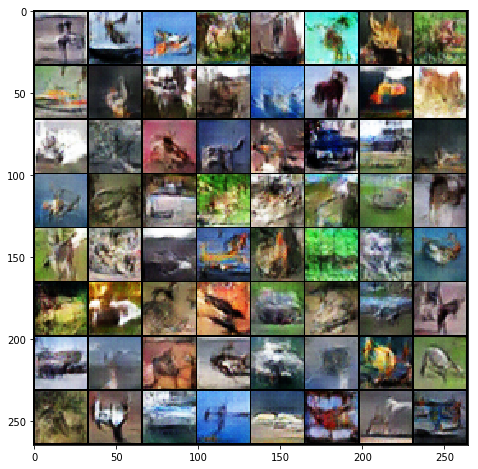

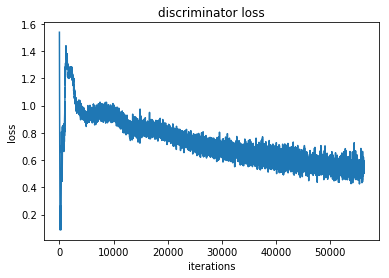

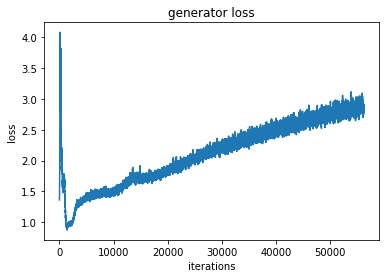

epoch  36
Iteration 56250/156200: dis loss = 0.4786, gen loss = 2.7374
Iteration 56300/156200: dis loss = 0.6105, gen loss = 3.0372
Iteration 56350/156200: dis loss = 0.4283, gen loss = 2.9384
Iteration 56400/156200: dis loss = 0.6203, gen loss = 1.5404
Iteration 56450/156200: dis loss = 0.4505, gen loss = 4.0199
Iteration 56500/156200: dis loss = 0.5201, gen loss = 3.5705
Iteration 56550/156200: dis loss = 0.4446, gen loss = 2.1497
Iteration 56600/156200: dis loss = 0.7452, gen loss = 1.2682
Iteration 56650/156200: dis loss = 0.5891, gen loss = 3.4151
Iteration 56700/156200: dis loss = 0.5058, gen loss = 4.1540
Iteration 56750/156200: dis loss = 0.1433, gen loss = 3.3151
Iteration 56800/156200: dis loss = 0.3928, gen loss = 2.5310
Iteration 56850/156200: dis loss = 0.3802, gen loss = 3.4988
Iteration 56900/156200: dis loss = 0.8277, gen loss = 1.8537
Iteration 56950/156200: dis loss = 0.3594, gen loss = 2.6769
Iteration 57000/156200: dis loss = 0.3170, gen loss = 2.3596
Iteration 5705

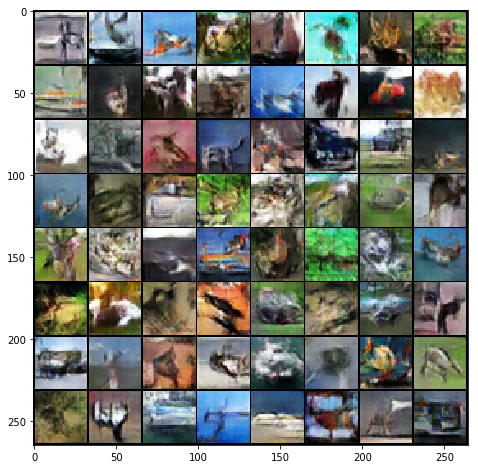

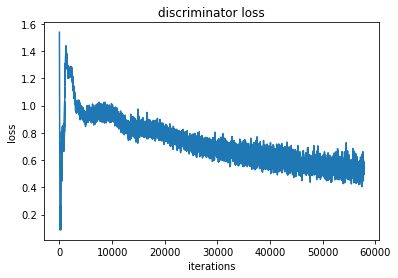

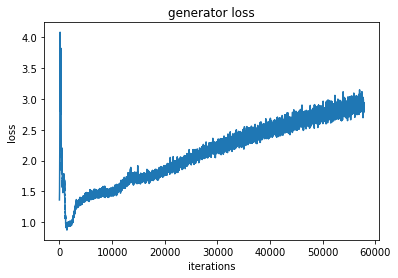

epoch  37
Iteration 57800/156200: dis loss = 0.5169, gen loss = 4.5496
Iteration 57850/156200: dis loss = 0.6551, gen loss = 4.0797
Iteration 57900/156200: dis loss = 0.1510, gen loss = 3.4289
Iteration 57950/156200: dis loss = 0.3605, gen loss = 2.3357
Iteration 58000/156200: dis loss = 0.6614, gen loss = 1.7615
Iteration 58050/156200: dis loss = 0.5527, gen loss = 2.7871
Iteration 58100/156200: dis loss = 0.5705, gen loss = 5.3170
Iteration 58150/156200: dis loss = 0.7632, gen loss = 4.6040
Iteration 58200/156200: dis loss = 0.3007, gen loss = 2.8977
Iteration 58250/156200: dis loss = 0.6673, gen loss = 3.1883
Iteration 58300/156200: dis loss = 0.2415, gen loss = 3.0767
Iteration 58350/156200: dis loss = 0.4363, gen loss = 3.6254
Iteration 58400/156200: dis loss = 0.2400, gen loss = 3.7585
Iteration 58450/156200: dis loss = 0.9554, gen loss = 1.0356
Iteration 58500/156200: dis loss = 0.3147, gen loss = 2.5671
Iteration 58550/156200: dis loss = 0.3428, gen loss = 3.2140
Iteration 5860

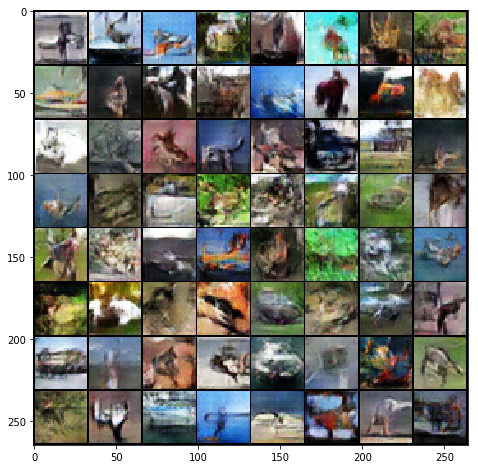

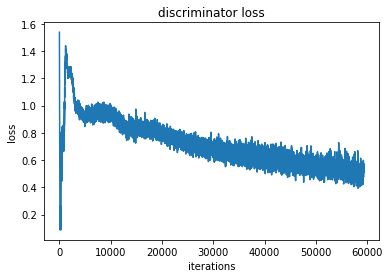

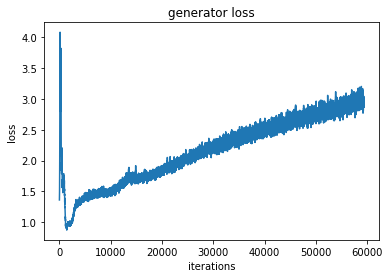

epoch  38
Iteration 59400/156200: dis loss = 0.5404, gen loss = 2.7035
Iteration 59450/156200: dis loss = 2.4276, gen loss = 5.1580
Iteration 59500/156200: dis loss = 0.3908, gen loss = 2.6963
Iteration 59550/156200: dis loss = 0.7067, gen loss = 4.7614
Iteration 59600/156200: dis loss = 0.6167, gen loss = 1.6751
Iteration 59650/156200: dis loss = 0.3566, gen loss = 3.0388
Iteration 59700/156200: dis loss = 0.2115, gen loss = 3.1020
Iteration 59750/156200: dis loss = 0.7891, gen loss = 2.1432
Iteration 59800/156200: dis loss = 0.3120, gen loss = 3.0203
Iteration 59850/156200: dis loss = 0.6513, gen loss = 1.7476
Iteration 59900/156200: dis loss = 0.1906, gen loss = 3.1365
Iteration 59950/156200: dis loss = 0.7200, gen loss = 1.6635
Iteration 60000/156200: dis loss = 0.3372, gen loss = 2.6227
Iteration 60050/156200: dis loss = 0.2505, gen loss = 3.1724
Iteration 60100/156200: dis loss = 0.2484, gen loss = 3.0002
Iteration 60150/156200: dis loss = 0.4366, gen loss = 2.1833
Iteration 6020

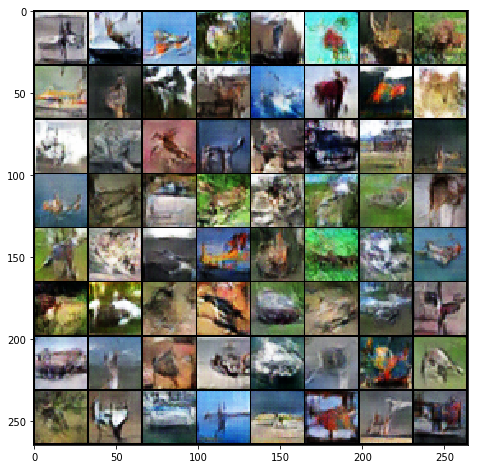

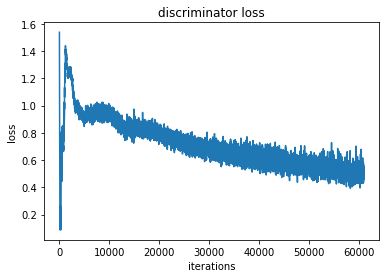

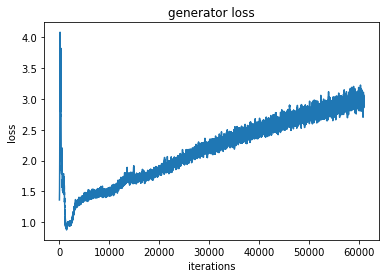

epoch  39
Iteration 60950/156200: dis loss = 0.4738, gen loss = 3.6143
Iteration 61000/156200: dis loss = 0.3422, gen loss = 3.1448
Iteration 61050/156200: dis loss = 0.3083, gen loss = 2.5863
Iteration 61100/156200: dis loss = 0.8338, gen loss = 4.3614
Iteration 61150/156200: dis loss = 0.6886, gen loss = 3.2257
Iteration 61200/156200: dis loss = 0.4313, gen loss = 3.4409
Iteration 61250/156200: dis loss = 0.2734, gen loss = 2.9820
Iteration 61300/156200: dis loss = 0.9676, gen loss = 4.1363
Iteration 61350/156200: dis loss = 0.4718, gen loss = 2.5693
Iteration 61400/156200: dis loss = 0.4252, gen loss = 3.1877
Iteration 61450/156200: dis loss = 0.5995, gen loss = 1.4088
Iteration 61500/156200: dis loss = 0.6551, gen loss = 3.3729
Iteration 61550/156200: dis loss = 0.6116, gen loss = 2.8198
Iteration 61600/156200: dis loss = 0.7110, gen loss = 0.7687
Iteration 61650/156200: dis loss = 0.7139, gen loss = 4.1220
Iteration 61700/156200: dis loss = 1.0581, gen loss = 5.3642
Iteration 6175

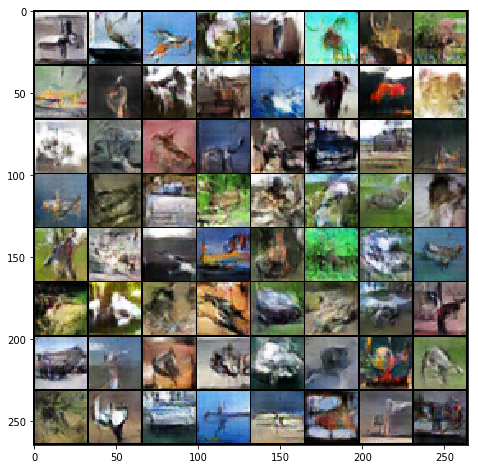

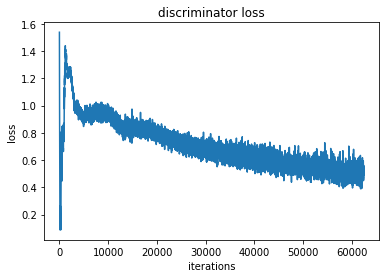

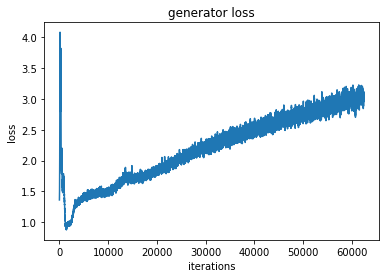

epoch  40
Iteration 62500/156200: dis loss = 0.2783, gen loss = 3.1418
Iteration 62550/156200: dis loss = 0.5991, gen loss = 1.2007
Iteration 62600/156200: dis loss = 0.1942, gen loss = 3.6996
Iteration 62650/156200: dis loss = 0.5032, gen loss = 2.1311
Iteration 62700/156200: dis loss = 0.3390, gen loss = 3.7976
Iteration 62750/156200: dis loss = 0.3897, gen loss = 2.9148
Iteration 62800/156200: dis loss = 0.6099, gen loss = 4.0704
Iteration 62850/156200: dis loss = 0.1846, gen loss = 3.3855
Iteration 62900/156200: dis loss = 0.2140, gen loss = 4.0592
Iteration 62950/156200: dis loss = 0.4169, gen loss = 4.2616
Iteration 63000/156200: dis loss = 0.2515, gen loss = 2.8280
Iteration 63050/156200: dis loss = 0.2878, gen loss = 2.7427
Iteration 63100/156200: dis loss = 0.2929, gen loss = 2.9241
Iteration 63150/156200: dis loss = 0.3432, gen loss = 3.0183
Iteration 63200/156200: dis loss = 1.0869, gen loss = 4.4601
Iteration 63250/156200: dis loss = 0.2197, gen loss = 3.2546
Iteration 6330

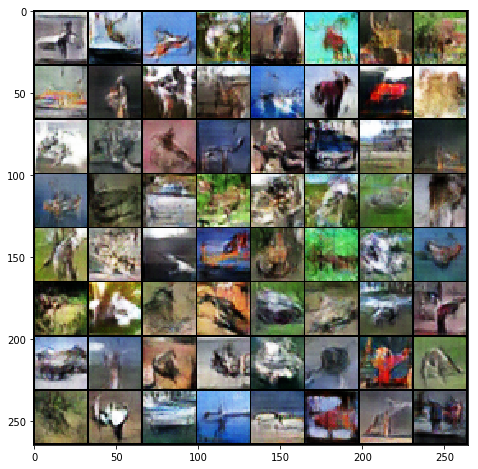

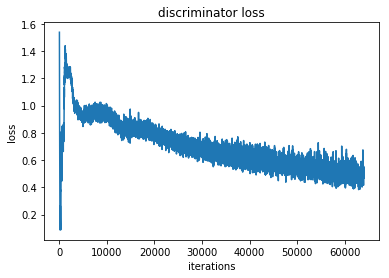

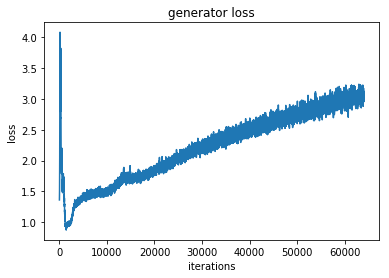

epoch  41
Iteration 64050/156200: dis loss = 0.2513, gen loss = 3.9410
Iteration 64100/156200: dis loss = 0.1948, gen loss = 3.3855
Iteration 64150/156200: dis loss = 1.1015, gen loss = 0.7092
Iteration 64200/156200: dis loss = 0.3099, gen loss = 3.0365
Iteration 64250/156200: dis loss = 0.5604, gen loss = 3.8346
Iteration 64300/156200: dis loss = 1.0731, gen loss = 4.5835
Iteration 64350/156200: dis loss = 1.0063, gen loss = 4.5459
Iteration 64400/156200: dis loss = 0.9976, gen loss = 1.8805
Iteration 64450/156200: dis loss = 0.8043, gen loss = 4.4246
Iteration 64500/156200: dis loss = 0.5360, gen loss = 3.1133
Iteration 64550/156200: dis loss = 0.1792, gen loss = 3.3912
Iteration 64600/156200: dis loss = 0.5606, gen loss = 3.8566
Iteration 64650/156200: dis loss = 0.2604, gen loss = 3.2038
Iteration 64700/156200: dis loss = 0.3086, gen loss = 3.2191
Iteration 64750/156200: dis loss = 0.3211, gen loss = 2.5350
Iteration 64800/156200: dis loss = 0.3658, gen loss = 2.0704
Iteration 6485

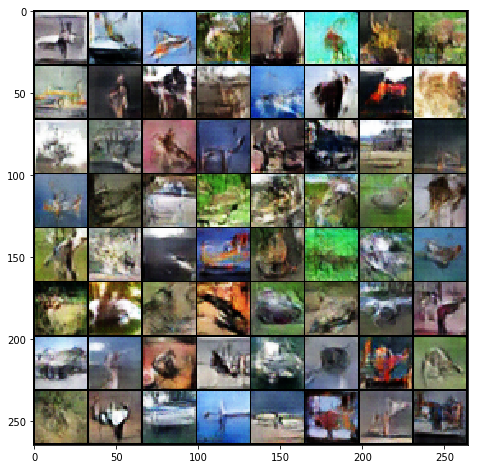

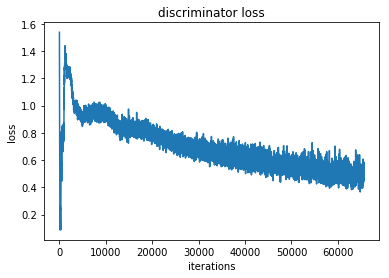

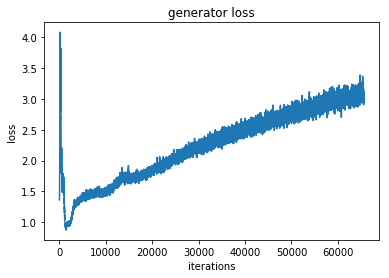

epoch  42
Iteration 65650/156200: dis loss = 0.2750, gen loss = 3.4820
Iteration 65700/156200: dis loss = 0.3599, gen loss = 4.1781
Iteration 65750/156200: dis loss = 0.1600, gen loss = 3.3796
Iteration 65800/156200: dis loss = 0.6543, gen loss = 3.8541
Iteration 65850/156200: dis loss = 0.9982, gen loss = 4.8708
Iteration 65900/156200: dis loss = 0.5099, gen loss = 2.2591
Iteration 65950/156200: dis loss = 0.4322, gen loss = 4.0088
Iteration 66000/156200: dis loss = 0.1573, gen loss = 3.5322
Iteration 66050/156200: dis loss = 0.6435, gen loss = 2.2270
Iteration 66100/156200: dis loss = 0.4670, gen loss = 1.6528
Iteration 66150/156200: dis loss = 0.3813, gen loss = 4.8015
Iteration 66200/156200: dis loss = 0.0746, gen loss = 3.8654
Iteration 66250/156200: dis loss = 0.5909, gen loss = 3.7395
Iteration 66300/156200: dis loss = 0.3298, gen loss = 3.1756
Iteration 66350/156200: dis loss = 0.5075, gen loss = 4.0235
Iteration 66400/156200: dis loss = 1.5798, gen loss = 1.5166
Iteration 6645

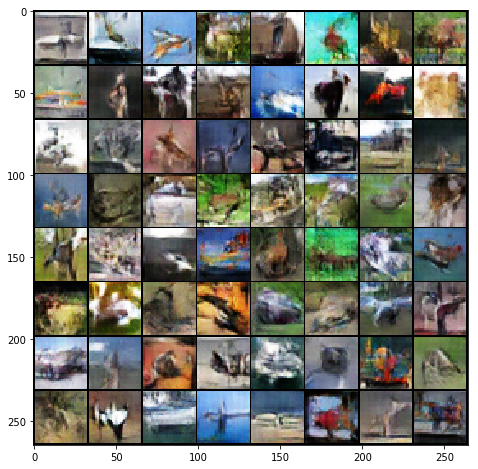

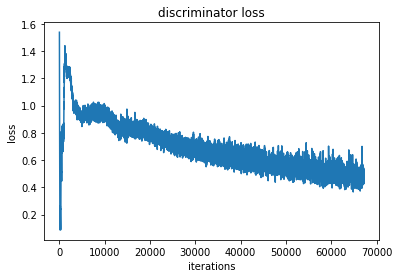

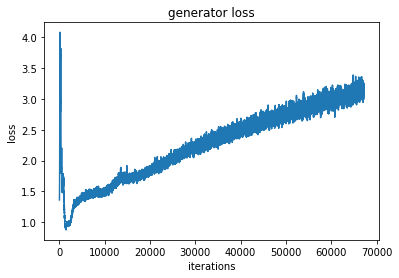

epoch  43
Iteration 67200/156200: dis loss = 0.3246, gen loss = 2.6717
Iteration 67250/156200: dis loss = 0.1983, gen loss = 2.8335
Iteration 67300/156200: dis loss = 1.4366, gen loss = 1.3117
Iteration 67350/156200: dis loss = 0.2143, gen loss = 3.5384
Iteration 67400/156200: dis loss = 0.9846, gen loss = 1.6487
Iteration 67450/156200: dis loss = 0.3786, gen loss = 5.2317
Iteration 67500/156200: dis loss = 0.6762, gen loss = 4.5253
Iteration 67550/156200: dis loss = 0.1708, gen loss = 3.8178
Iteration 67600/156200: dis loss = 0.3053, gen loss = 2.5350
Iteration 67650/156200: dis loss = 0.2579, gen loss = 3.5240
Iteration 67700/156200: dis loss = 0.7970, gen loss = 4.9223
Iteration 67750/156200: dis loss = 0.3457, gen loss = 2.3922
Iteration 67800/156200: dis loss = 0.3949, gen loss = 2.6994
Iteration 67850/156200: dis loss = 0.9349, gen loss = 4.5839
Iteration 67900/156200: dis loss = 0.3048, gen loss = 3.0549
Iteration 67950/156200: dis loss = 0.3377, gen loss = 3.2569
Iteration 6800

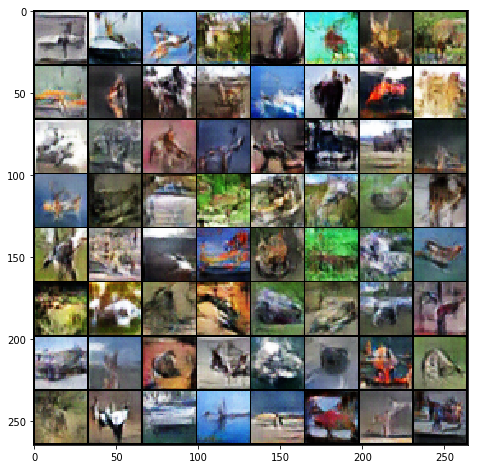

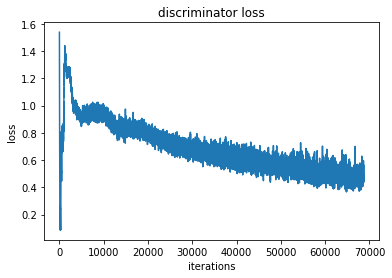

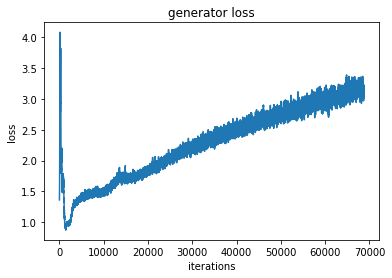

epoch  44
Iteration 68750/156200: dis loss = 0.3909, gen loss = 3.3447
Iteration 68800/156200: dis loss = 0.4207, gen loss = 4.3647
Iteration 68850/156200: dis loss = 0.2257, gen loss = 3.5540
Iteration 68900/156200: dis loss = 1.1529, gen loss = 0.6283
Iteration 68950/156200: dis loss = 0.3630, gen loss = 3.0572
Iteration 69000/156200: dis loss = 0.4393, gen loss = 2.5343
Iteration 69050/156200: dis loss = 0.5933, gen loss = 4.1559
Iteration 69100/156200: dis loss = 1.1409, gen loss = 4.8122
Iteration 69150/156200: dis loss = 0.6599, gen loss = 4.9856
Iteration 69200/156200: dis loss = 0.3227, gen loss = 3.0108
Iteration 69250/156200: dis loss = 0.1572, gen loss = 3.1924
Iteration 69300/156200: dis loss = 0.3136, gen loss = 3.9982
Iteration 69350/156200: dis loss = 0.7267, gen loss = 0.9905
Iteration 69400/156200: dis loss = 0.1605, gen loss = 3.6037
Iteration 69450/156200: dis loss = 0.3722, gen loss = 2.1674
Iteration 69500/156200: dis loss = 0.2479, gen loss = 3.2852
Iteration 6955

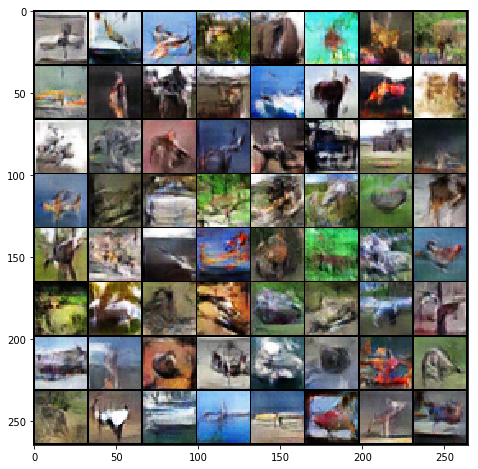

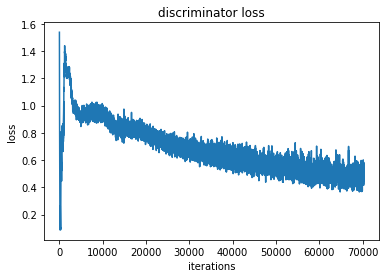

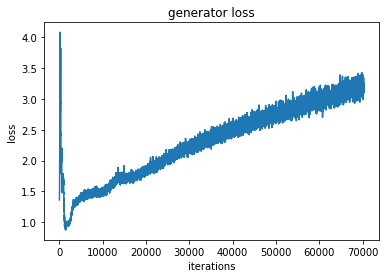

epoch  45
Iteration 70300/156200: dis loss = 1.1164, gen loss = 0.9740
Iteration 70350/156200: dis loss = 0.2241, gen loss = 3.2246
Iteration 70400/156200: dis loss = 0.4352, gen loss = 2.3011
Iteration 70450/156200: dis loss = 0.2795, gen loss = 3.6768
Iteration 70500/156200: dis loss = 0.5243, gen loss = 1.7907
Iteration 70550/156200: dis loss = 0.5528, gen loss = 3.1105
Iteration 70600/156200: dis loss = 0.2237, gen loss = 3.7067
Iteration 70650/156200: dis loss = 0.4039, gen loss = 2.2641
Iteration 70700/156200: dis loss = 1.4062, gen loss = 6.7011
Iteration 70750/156200: dis loss = 0.4374, gen loss = 2.4005
Iteration 70800/156200: dis loss = 1.0432, gen loss = 6.3387
Iteration 70850/156200: dis loss = 0.3652, gen loss = 2.6671
Iteration 70900/156200: dis loss = 0.4735, gen loss = 2.6555
Iteration 70950/156200: dis loss = 0.2840, gen loss = 2.6122
Iteration 71000/156200: dis loss = 0.4318, gen loss = 3.8673
Iteration 71050/156200: dis loss = 0.1757, gen loss = 3.3805
Iteration 7110

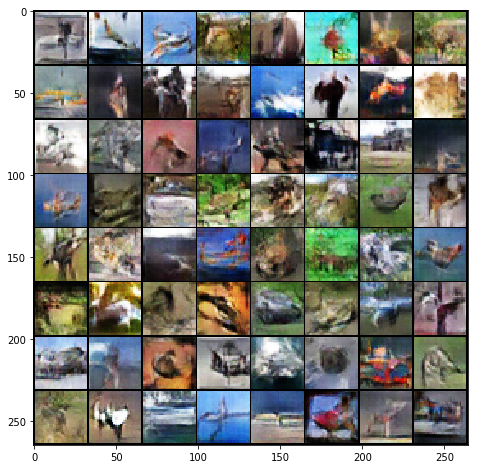

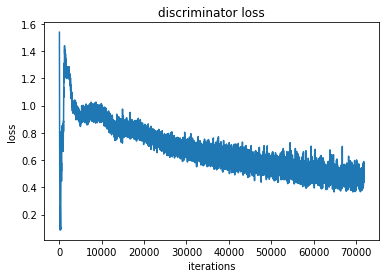

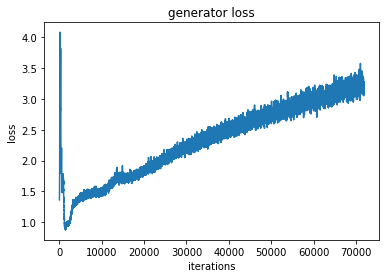

epoch  46
Iteration 71900/156200: dis loss = 0.3444, gen loss = 2.6970
Iteration 71950/156200: dis loss = 0.2778, gen loss = 3.8236
Iteration 72000/156200: dis loss = 1.2369, gen loss = 1.0694
Iteration 72050/156200: dis loss = 0.6844, gen loss = 1.2774
Iteration 72100/156200: dis loss = 0.3857, gen loss = 2.2346
Iteration 72150/156200: dis loss = 0.0687, gen loss = 4.1361
Iteration 72200/156200: dis loss = 0.5463, gen loss = 4.0005
Iteration 72250/156200: dis loss = 0.4393, gen loss = 3.7149
Iteration 72300/156200: dis loss = 0.3295, gen loss = 3.0229
Iteration 72350/156200: dis loss = 0.4214, gen loss = 2.7788
Iteration 72400/156200: dis loss = 0.3498, gen loss = 2.6250
Iteration 72450/156200: dis loss = 0.2524, gen loss = 3.8409
Iteration 72500/156200: dis loss = 0.6366, gen loss = 1.7518
Iteration 72550/156200: dis loss = 0.2670, gen loss = 3.4909
Iteration 72600/156200: dis loss = 0.2301, gen loss = 3.3661
Iteration 72650/156200: dis loss = 0.3708, gen loss = 4.3378
Iteration 7270

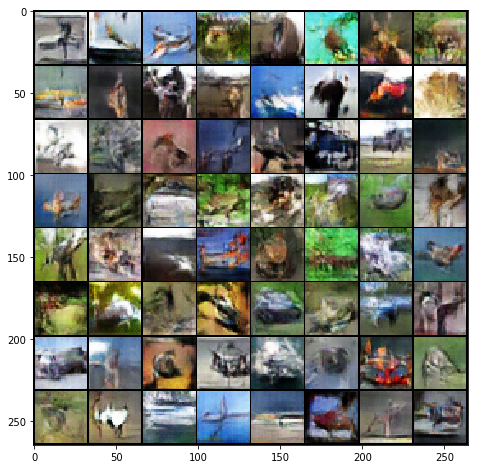

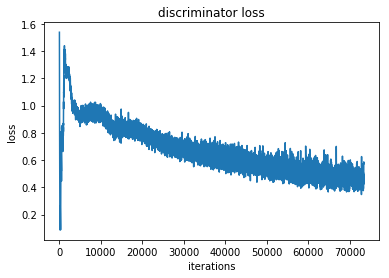

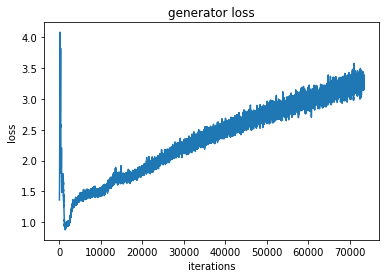

epoch  47
Iteration 73450/156200: dis loss = 0.9092, gen loss = 4.0840
Iteration 73500/156200: dis loss = 0.3616, gen loss = 2.3211
Iteration 73550/156200: dis loss = 0.2449, gen loss = 3.5315
Iteration 73600/156200: dis loss = 0.9265, gen loss = 5.0285
Iteration 73650/156200: dis loss = 0.2868, gen loss = 2.9266
Iteration 73700/156200: dis loss = 0.6578, gen loss = 5.1669
Iteration 73750/156200: dis loss = 0.2909, gen loss = 3.4474
Iteration 73800/156200: dis loss = 0.3624, gen loss = 3.6868
Iteration 73850/156200: dis loss = 0.3438, gen loss = 3.9982
Iteration 73900/156200: dis loss = 1.0098, gen loss = 4.3716
Iteration 73950/156200: dis loss = 0.9263, gen loss = 2.0374
Iteration 74000/156200: dis loss = 0.3052, gen loss = 2.6072
Iteration 74050/156200: dis loss = 0.4029, gen loss = 3.2282
Iteration 74100/156200: dis loss = 0.5681, gen loss = 2.2066
Iteration 74150/156200: dis loss = 0.3321, gen loss = 4.6023
Iteration 74200/156200: dis loss = 0.3089, gen loss = 2.8591
Iteration 7425

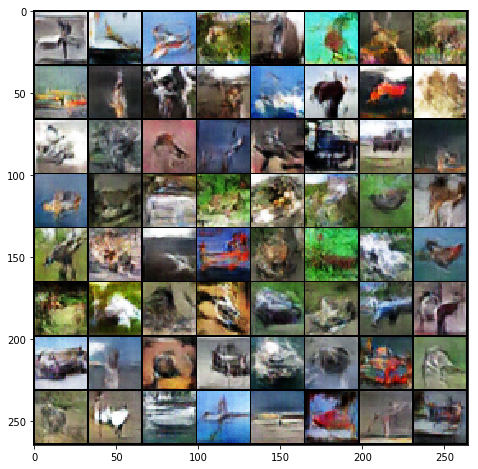

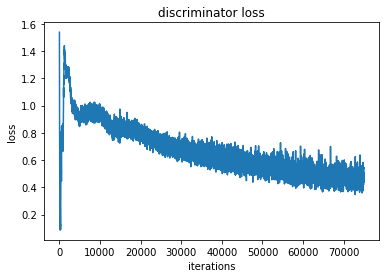

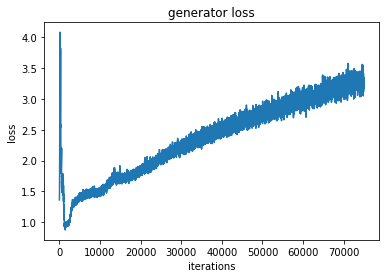

epoch  48
Iteration 75000/156200: dis loss = 0.8060, gen loss = 1.4397
Iteration 75050/156200: dis loss = 0.4095, gen loss = 2.2972
Iteration 75100/156200: dis loss = 0.5813, gen loss = 1.7902
Iteration 75150/156200: dis loss = 0.4657, gen loss = 2.7440
Iteration 75200/156200: dis loss = 0.4049, gen loss = 2.4173
Iteration 75250/156200: dis loss = 0.3165, gen loss = 2.7849
Iteration 75300/156200: dis loss = 0.4242, gen loss = 3.1925
Iteration 75350/156200: dis loss = 0.7342, gen loss = 0.6567
Iteration 75400/156200: dis loss = 0.5773, gen loss = 5.3185
Iteration 75450/156200: dis loss = 0.2723, gen loss = 3.4933
Iteration 75500/156200: dis loss = 0.3459, gen loss = 3.8092
Iteration 75550/156200: dis loss = 0.6909, gen loss = 2.8290
Iteration 75600/156200: dis loss = 0.7254, gen loss = 1.3809
Iteration 75650/156200: dis loss = 0.1961, gen loss = 3.7527
Iteration 75700/156200: dis loss = 0.1969, gen loss = 4.0118
Iteration 75750/156200: dis loss = 0.2989, gen loss = 4.8805
Iteration 7580

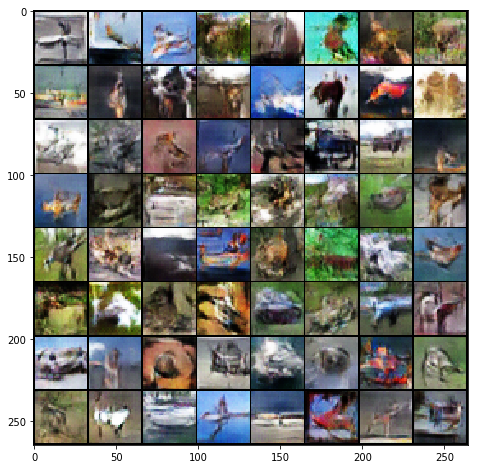

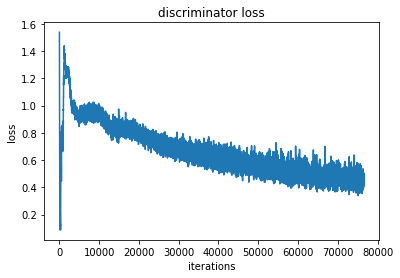

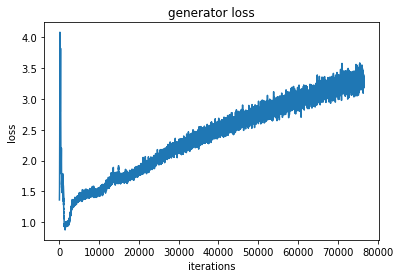

epoch  49
Iteration 76550/156200: dis loss = 0.4173, gen loss = 4.1509
Iteration 76600/156200: dis loss = 0.9551, gen loss = 1.7824
Iteration 76650/156200: dis loss = 0.3447, gen loss = 3.2494
Iteration 76700/156200: dis loss = 0.3037, gen loss = 3.9412
Iteration 76750/156200: dis loss = 0.3388, gen loss = 4.3341
Iteration 76800/156200: dis loss = 0.3233, gen loss = 2.2900
Iteration 76850/156200: dis loss = 0.5342, gen loss = 1.8630
Iteration 76900/156200: dis loss = 0.2131, gen loss = 3.5738
Iteration 76950/156200: dis loss = 0.2647, gen loss = 2.9123
Iteration 77000/156200: dis loss = 0.1276, gen loss = 4.3567
Iteration 77050/156200: dis loss = 0.3547, gen loss = 2.0076
Iteration 77100/156200: dis loss = 0.2054, gen loss = 3.8135
Iteration 77150/156200: dis loss = 0.4240, gen loss = 2.5607
Iteration 77200/156200: dis loss = 0.3390, gen loss = 3.3995
Iteration 77250/156200: dis loss = 0.3425, gen loss = 2.8949
Iteration 77300/156200: dis loss = 0.2466, gen loss = 4.2368
Iteration 7735

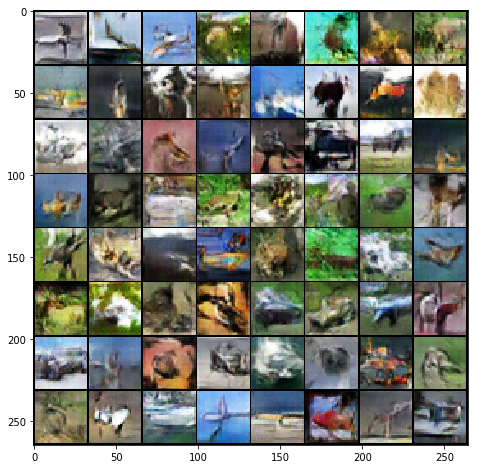

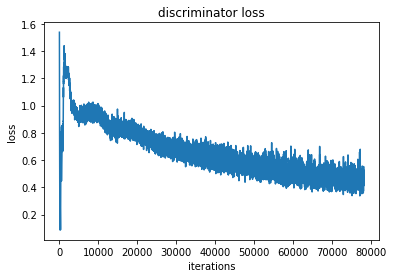

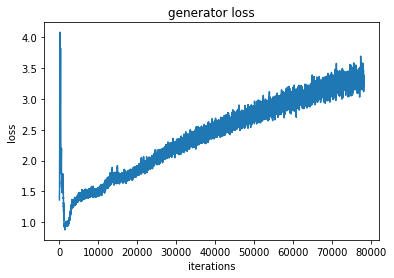

epoch  50
Iteration 78150/156200: dis loss = 0.3198, gen loss = 3.2565
Iteration 78200/156200: dis loss = 0.3224, gen loss = 2.8360
Iteration 78250/156200: dis loss = 0.2654, gen loss = 2.7999
Iteration 78300/156200: dis loss = 0.2501, gen loss = 4.3871
Iteration 78350/156200: dis loss = 0.3432, gen loss = 2.4137
Iteration 78400/156200: dis loss = 0.4007, gen loss = 2.6064
Iteration 78450/156200: dis loss = 0.2728, gen loss = 3.5375
Iteration 78500/156200: dis loss = 0.4281, gen loss = 3.1190
Iteration 78550/156200: dis loss = 0.2895, gen loss = 3.7456
Iteration 78600/156200: dis loss = 0.4695, gen loss = 3.7178
Iteration 78650/156200: dis loss = 0.3335, gen loss = 3.5800
Iteration 78700/156200: dis loss = 0.4040, gen loss = 4.2973
Iteration 78750/156200: dis loss = 0.2030, gen loss = 3.6916
Iteration 78800/156200: dis loss = 0.4530, gen loss = 4.0993
Iteration 78850/156200: dis loss = 0.2942, gen loss = 3.7504
Iteration 78900/156200: dis loss = 0.5052, gen loss = 4.2918
Iteration 7895

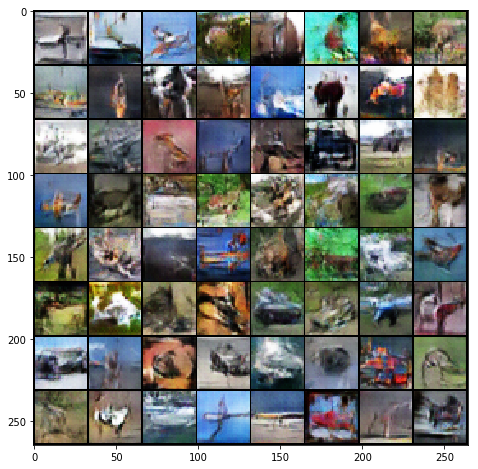

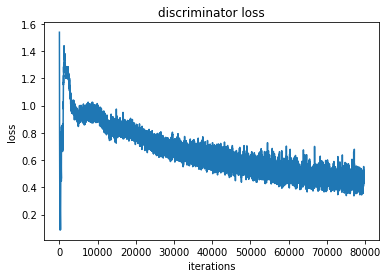

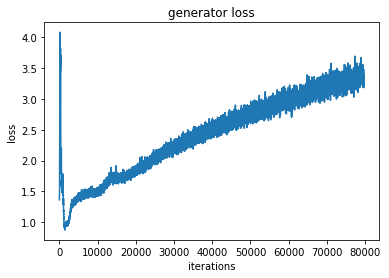

epoch  51
Iteration 79700/156200: dis loss = 0.4894, gen loss = 2.5537
Iteration 79750/156200: dis loss = 0.4263, gen loss = 4.7075
Iteration 79800/156200: dis loss = 0.1737, gen loss = 3.6357
Iteration 79850/156200: dis loss = 0.3610, gen loss = 2.2007
Iteration 79900/156200: dis loss = 0.3023, gen loss = 2.6571
Iteration 79950/156200: dis loss = 0.3539, gen loss = 3.7397
Iteration 80000/156200: dis loss = 0.3838, gen loss = 2.0025
Iteration 80050/156200: dis loss = 0.2755, gen loss = 3.2807
Iteration 80100/156200: dis loss = 1.4199, gen loss = 6.0767
Iteration 80150/156200: dis loss = 0.7711, gen loss = 4.8669
Iteration 80200/156200: dis loss = 0.4808, gen loss = 2.5253
Iteration 80250/156200: dis loss = 0.7873, gen loss = 1.0730
Iteration 80300/156200: dis loss = 0.3425, gen loss = 3.6992
Iteration 80350/156200: dis loss = 0.2836, gen loss = 2.8461
Iteration 80400/156200: dis loss = 0.5867, gen loss = 3.0323
Iteration 80450/156200: dis loss = 0.2307, gen loss = 3.3538
Iteration 8050

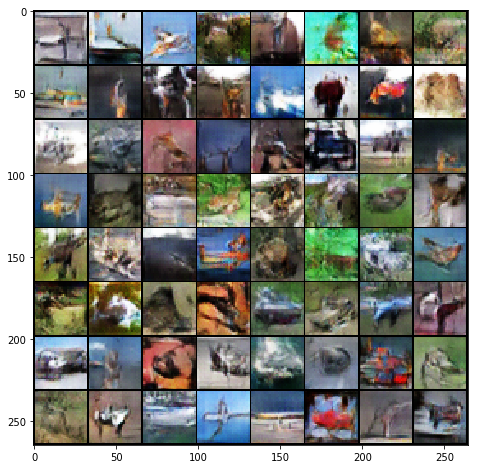

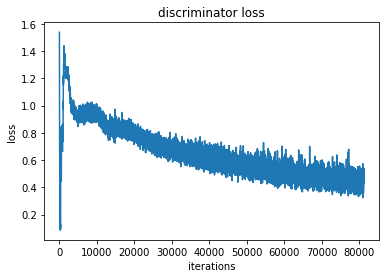

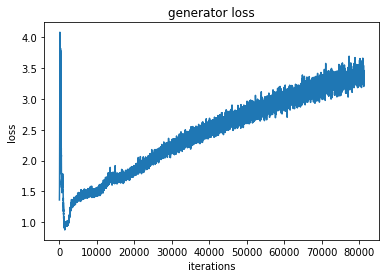

epoch  52
Iteration 81250/156200: dis loss = 0.4345, gen loss = 2.0290
Iteration 81300/156200: dis loss = 0.5647, gen loss = 0.9393
Iteration 81350/156200: dis loss = 0.3968, gen loss = 4.1098
Iteration 81400/156200: dis loss = 0.2668, gen loss = 2.7401
Iteration 81450/156200: dis loss = 0.5965, gen loss = 2.0461
Iteration 81500/156200: dis loss = 0.7295, gen loss = 5.1596
Iteration 81550/156200: dis loss = 0.2151, gen loss = 3.2213
Iteration 81600/156200: dis loss = 0.2998, gen loss = 2.6951
Iteration 81650/156200: dis loss = 0.4554, gen loss = 4.5780
Iteration 81700/156200: dis loss = 0.1359, gen loss = 3.9697
Iteration 81750/156200: dis loss = 0.1395, gen loss = 3.6341
Iteration 81800/156200: dis loss = 0.3763, gen loss = 3.6628
Iteration 81850/156200: dis loss = 0.3380, gen loss = 3.0736
Iteration 81900/156200: dis loss = 0.3441, gen loss = 4.7938
Iteration 81950/156200: dis loss = 0.3726, gen loss = 4.3023
Iteration 82000/156200: dis loss = 0.2934, gen loss = 4.6990
Iteration 8205

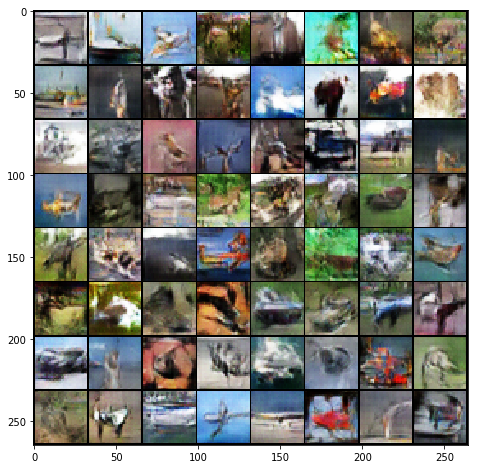

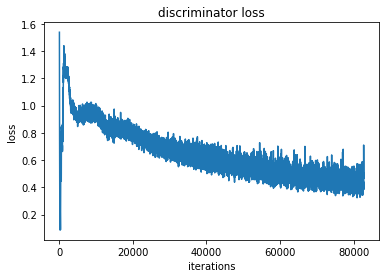

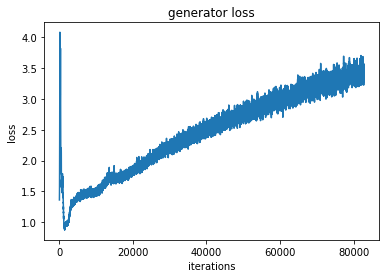

epoch  53
Iteration 82800/156200: dis loss = 0.4161, gen loss = 2.5600
Iteration 82850/156200: dis loss = 0.6514, gen loss = 5.6262
Iteration 82900/156200: dis loss = 0.4869, gen loss = 4.7004
Iteration 82950/156200: dis loss = 0.1754, gen loss = 3.4593
Iteration 83000/156200: dis loss = 0.4554, gen loss = 1.8703
Iteration 83050/156200: dis loss = 0.6567, gen loss = 3.0805
Iteration 83100/156200: dis loss = 0.3773, gen loss = 5.1314
Iteration 83150/156200: dis loss = 1.5622, gen loss = 6.0577
Iteration 83200/156200: dis loss = 0.1379, gen loss = 3.7439
Iteration 83250/156200: dis loss = 0.5428, gen loss = 2.9538
Iteration 83300/156200: dis loss = 0.3339, gen loss = 4.4541
Iteration 83350/156200: dis loss = 0.4219, gen loss = 1.9932
Iteration 83400/156200: dis loss = 0.2582, gen loss = 2.8773
Iteration 83450/156200: dis loss = 0.2403, gen loss = 3.2545
Iteration 83500/156200: dis loss = 0.3627, gen loss = 3.6414
Iteration 83550/156200: dis loss = 0.4240, gen loss = 3.7938
Iteration 8360

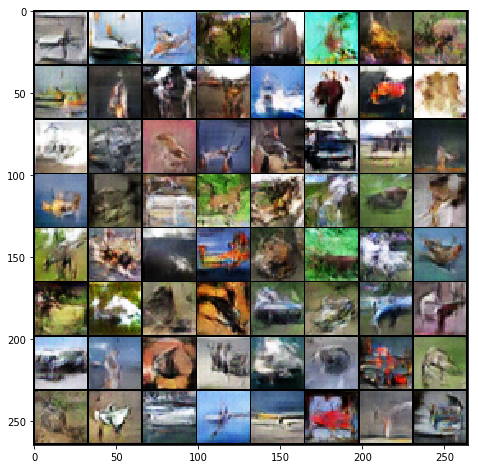

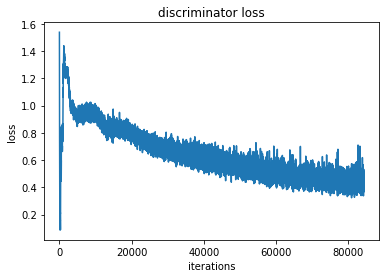

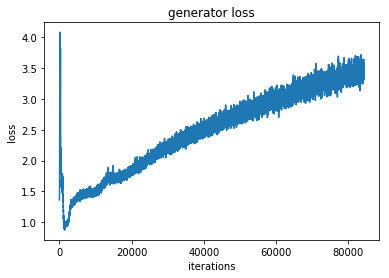

epoch  54
Iteration 84350/156200: dis loss = 0.4213, gen loss = 2.2332
Iteration 84400/156200: dis loss = 0.2177, gen loss = 4.5997
Iteration 84450/156200: dis loss = 0.1488, gen loss = 4.3609
Iteration 84500/156200: dis loss = 0.5361, gen loss = 4.6873
Iteration 84550/156200: dis loss = 0.0801, gen loss = 3.9709
Iteration 84600/156200: dis loss = 0.6663, gen loss = 1.6235
Iteration 84650/156200: dis loss = 0.4981, gen loss = 1.6268
Iteration 84700/156200: dis loss = 0.6875, gen loss = 6.0854
Iteration 84750/156200: dis loss = 0.4131, gen loss = 2.2778
Iteration 84800/156200: dis loss = 0.2354, gen loss = 3.7903
Iteration 84850/156200: dis loss = 0.3704, gen loss = 2.3238
Iteration 84900/156200: dis loss = 0.4824, gen loss = 3.6838
Iteration 84950/156200: dis loss = 0.3163, gen loss = 3.0883
Iteration 85000/156200: dis loss = 0.5452, gen loss = 4.6839
Iteration 85050/156200: dis loss = 0.5878, gen loss = 4.7698
Iteration 85100/156200: dis loss = 0.4833, gen loss = 2.3186
Iteration 8515

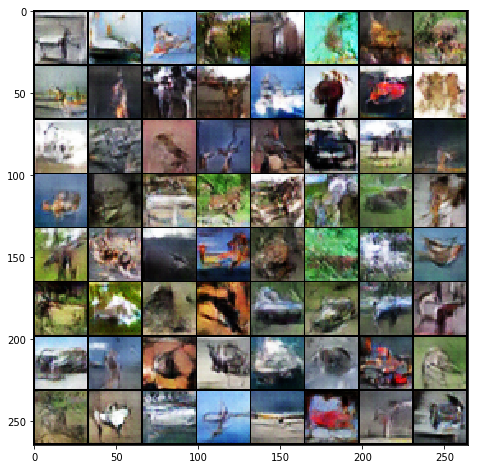

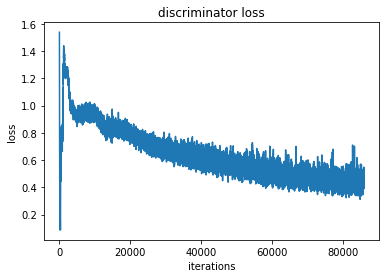

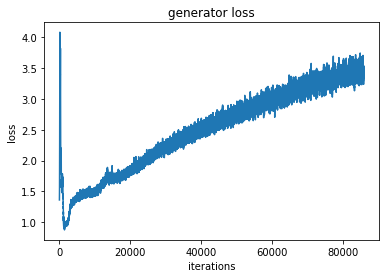

epoch  55
Iteration 85950/156200: dis loss = 0.4242, gen loss = 2.3897
Iteration 86000/156200: dis loss = 0.4553, gen loss = 3.7201
Iteration 86050/156200: dis loss = 0.5085, gen loss = 4.1994
Iteration 86100/156200: dis loss = 0.4093, gen loss = 2.9589
Iteration 86150/156200: dis loss = 0.4001, gen loss = 2.3460
Iteration 86200/156200: dis loss = 0.3897, gen loss = 4.2680
Iteration 86250/156200: dis loss = 0.2878, gen loss = 2.9298
Iteration 86300/156200: dis loss = 0.3402, gen loss = 2.7580
Iteration 86350/156200: dis loss = 0.3844, gen loss = 5.0812
Iteration 86400/156200: dis loss = 0.8568, gen loss = 1.3662
Iteration 86450/156200: dis loss = 0.2352, gen loss = 2.8791
Iteration 86500/156200: dis loss = 0.4094, gen loss = 2.7564
Iteration 86550/156200: dis loss = 0.2767, gen loss = 3.2189
Iteration 86600/156200: dis loss = 0.2530, gen loss = 3.3290
Iteration 86650/156200: dis loss = 0.6704, gen loss = 1.5168
Iteration 86700/156200: dis loss = 0.1224, gen loss = 3.8025
Iteration 8675

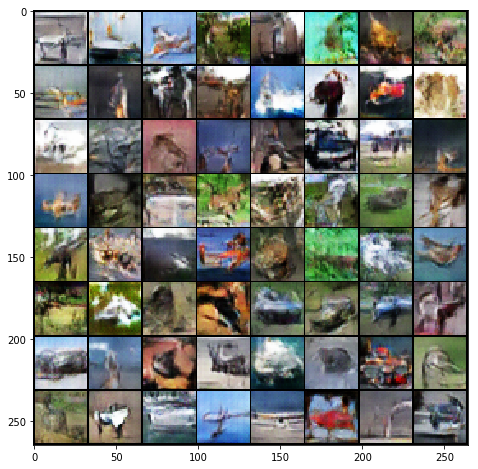

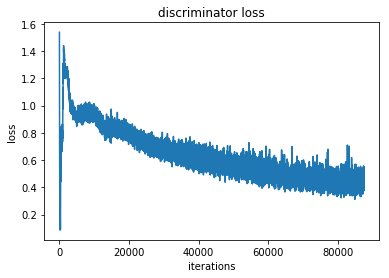

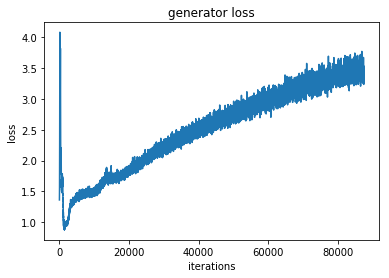

epoch  56
Iteration 87500/156200: dis loss = 0.1817, gen loss = 4.2226
Iteration 87550/156200: dis loss = 0.1825, gen loss = 3.3083
Iteration 87600/156200: dis loss = 0.5195, gen loss = 1.7254
Iteration 87650/156200: dis loss = 0.3181, gen loss = 3.6863
Iteration 87700/156200: dis loss = 0.1482, gen loss = 3.8635
Iteration 87750/156200: dis loss = 0.3217, gen loss = 2.0352
Iteration 87800/156200: dis loss = 0.4000, gen loss = 5.3390
Iteration 87850/156200: dis loss = 0.0573, gen loss = 4.3294
Iteration 87900/156200: dis loss = 0.1893, gen loss = 3.0174
Iteration 87950/156200: dis loss = 0.3176, gen loss = 3.1411
Iteration 88000/156200: dis loss = 0.3868, gen loss = 4.6920
Iteration 88050/156200: dis loss = 0.4410, gen loss = 2.9067
Iteration 88100/156200: dis loss = 0.4061, gen loss = 5.3662
Iteration 88150/156200: dis loss = 0.5157, gen loss = 4.8521
Iteration 88200/156200: dis loss = 0.6106, gen loss = 5.7453
Iteration 88250/156200: dis loss = 0.2907, gen loss = 5.1090
Iteration 8830

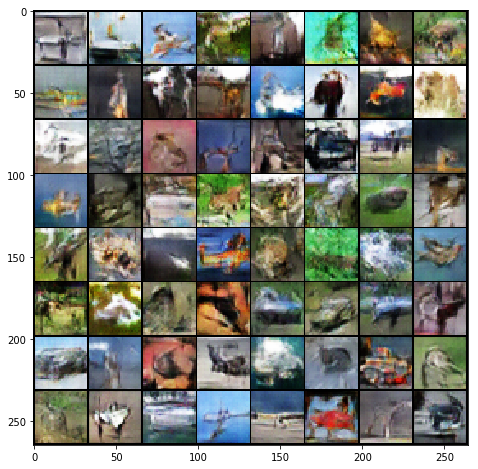

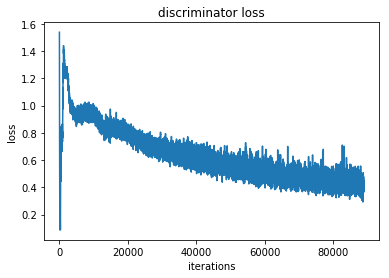

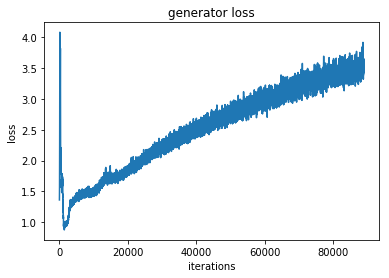

epoch  57
Iteration 89050/156200: dis loss = 0.3032, gen loss = 4.1235
Iteration 89100/156200: dis loss = 0.5771, gen loss = 1.6548
Iteration 89150/156200: dis loss = 0.2178, gen loss = 3.5100
Iteration 89200/156200: dis loss = 0.4679, gen loss = 2.8827
Iteration 89250/156200: dis loss = 0.3013, gen loss = 3.8674
Iteration 89300/156200: dis loss = 0.1528, gen loss = 4.1741
Iteration 89350/156200: dis loss = 0.1938, gen loss = 4.0156
Iteration 89400/156200: dis loss = 0.2921, gen loss = 3.2704
Iteration 89450/156200: dis loss = 0.2991, gen loss = 4.0108
Iteration 89500/156200: dis loss = 0.3799, gen loss = 2.2755
Iteration 89550/156200: dis loss = 3.0302, gen loss = 1.8863
Iteration 89600/156200: dis loss = 0.3091, gen loss = 4.6770
Iteration 89650/156200: dis loss = 0.1811, gen loss = 3.0051
Iteration 89700/156200: dis loss = 0.8402, gen loss = 6.7641
Iteration 89750/156200: dis loss = 0.2874, gen loss = 4.5307
Iteration 89800/156200: dis loss = 0.7799, gen loss = 5.3577
Iteration 8985

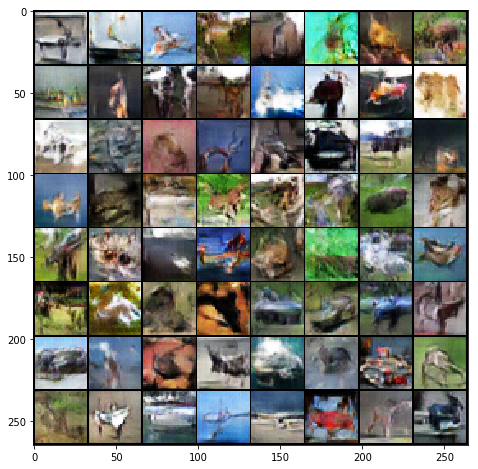

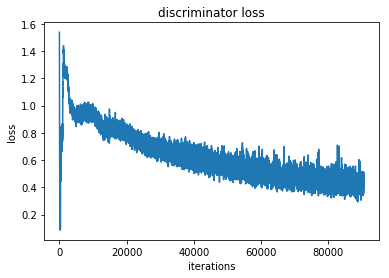

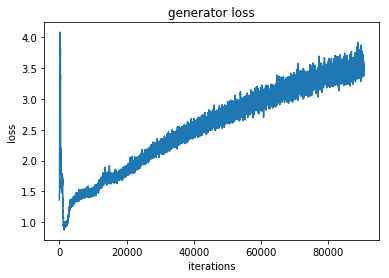

epoch  58
Iteration 90600/156200: dis loss = 0.5867, gen loss = 2.5412
Iteration 90650/156200: dis loss = 0.1351, gen loss = 4.3265
Iteration 90700/156200: dis loss = 0.3420, gen loss = 2.4697
Iteration 90750/156200: dis loss = 0.4620, gen loss = 4.5757
Iteration 90800/156200: dis loss = 0.2873, gen loss = 3.1110
Iteration 90850/156200: dis loss = 0.3893, gen loss = 3.5746
Iteration 90900/156200: dis loss = 0.9197, gen loss = 1.9040
Iteration 90950/156200: dis loss = 0.3131, gen loss = 2.8919
Iteration 91000/156200: dis loss = 0.3011, gen loss = 3.5392
Iteration 91050/156200: dis loss = 0.4286, gen loss = 4.5954
Iteration 91100/156200: dis loss = 0.2120, gen loss = 2.9927
Iteration 91150/156200: dis loss = 0.2531, gen loss = 3.5562
Iteration 91200/156200: dis loss = 0.3553, gen loss = 3.4338
Iteration 91250/156200: dis loss = 0.5668, gen loss = 4.4391
Iteration 91300/156200: dis loss = 0.5976, gen loss = 4.5224
Iteration 91350/156200: dis loss = 0.2492, gen loss = 2.9165
Iteration 9140

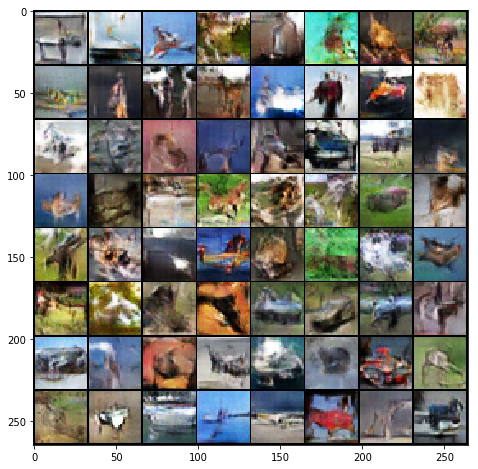

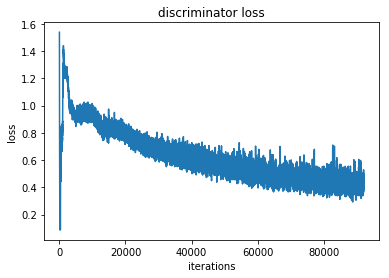

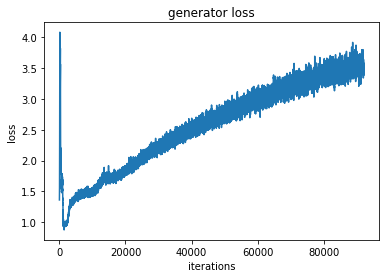

epoch  59
Iteration 92200/156200: dis loss = 0.5517, gen loss = 3.3388
Iteration 92250/156200: dis loss = 0.3017, gen loss = 3.0343
Iteration 92300/156200: dis loss = 0.5900, gen loss = 4.1055
Iteration 92350/156200: dis loss = 0.7217, gen loss = 6.8059
Iteration 92400/156200: dis loss = 0.3294, gen loss = 3.8961
Iteration 92450/156200: dis loss = 0.3497, gen loss = 2.4671
Iteration 92500/156200: dis loss = 0.1752, gen loss = 3.7163
Iteration 92550/156200: dis loss = 0.1444, gen loss = 3.7811
Iteration 92600/156200: dis loss = 1.2505, gen loss = 4.7897
Iteration 92650/156200: dis loss = 0.3100, gen loss = 3.1085
Iteration 92700/156200: dis loss = 0.3492, gen loss = 4.9479
Iteration 92750/156200: dis loss = 0.8427, gen loss = 5.9515
Iteration 92800/156200: dis loss = 0.5247, gen loss = 5.6443
Iteration 92850/156200: dis loss = 0.2342, gen loss = 3.5246
Iteration 92900/156200: dis loss = 0.4922, gen loss = 6.6349
Iteration 92950/156200: dis loss = 0.1745, gen loss = 3.2933
Iteration 9300

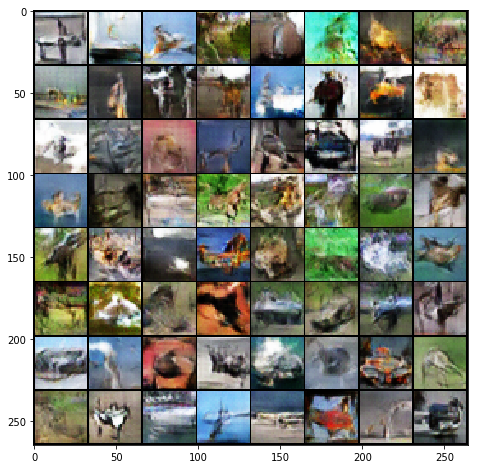

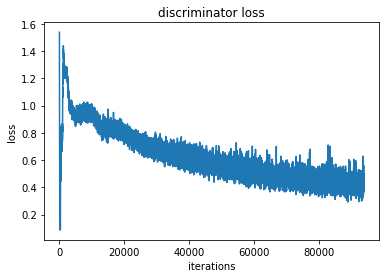

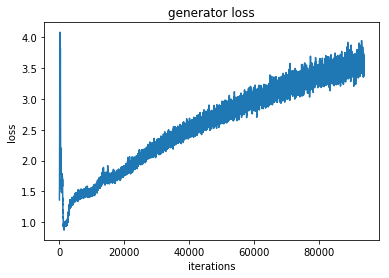

epoch  60
Iteration 93750/156200: dis loss = 0.3275, gen loss = 5.5057
Iteration 93800/156200: dis loss = 0.4054, gen loss = 4.0375
Iteration 93850/156200: dis loss = 0.1652, gen loss = 3.9372
Iteration 93900/156200: dis loss = 0.4462, gen loss = 3.7944
Iteration 93950/156200: dis loss = 0.6000, gen loss = 4.7324
Iteration 94000/156200: dis loss = 0.5367, gen loss = 2.3872
Iteration 94050/156200: dis loss = 0.2441, gen loss = 3.6562
Iteration 94100/156200: dis loss = 0.3291, gen loss = 3.8402
Iteration 94150/156200: dis loss = 0.4297, gen loss = 2.1728
Iteration 94200/156200: dis loss = 0.3601, gen loss = 2.3151
Iteration 94250/156200: dis loss = 0.3102, gen loss = 3.2499
Iteration 94300/156200: dis loss = 0.4730, gen loss = 1.7947
Iteration 94350/156200: dis loss = 0.5734, gen loss = 4.9851
Iteration 94400/156200: dis loss = 0.7173, gen loss = 6.2672
Iteration 94450/156200: dis loss = 0.3521, gen loss = 2.7029
Iteration 94500/156200: dis loss = 0.1223, gen loss = 4.1385
Iteration 9455

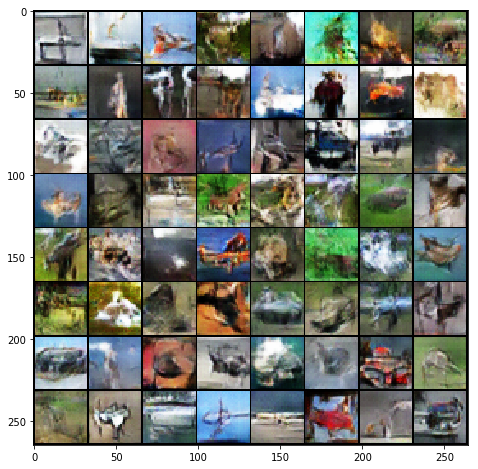

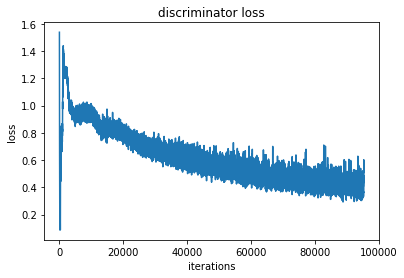

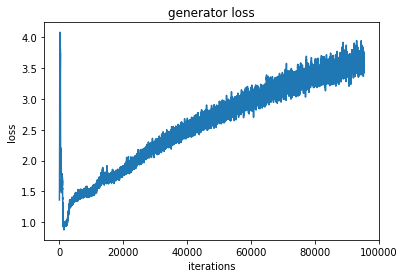

epoch  61
Iteration 95300/156200: dis loss = 0.4950, gen loss = 3.9944
Iteration 95350/156200: dis loss = 0.4228, gen loss = 6.2205
Iteration 95400/156200: dis loss = 0.2803, gen loss = 3.0937
Iteration 95450/156200: dis loss = 0.7840, gen loss = 1.6870
Iteration 95500/156200: dis loss = 0.8726, gen loss = 5.5259
Iteration 95550/156200: dis loss = 0.5361, gen loss = 1.5754
Iteration 95600/156200: dis loss = 0.3025, gen loss = 3.9861
Iteration 95650/156200: dis loss = 0.6051, gen loss = 0.9692
Iteration 95700/156200: dis loss = 0.3129, gen loss = 3.7413
Iteration 95750/156200: dis loss = 0.6172, gen loss = 5.5403
Iteration 95800/156200: dis loss = 0.1229, gen loss = 4.4013
Iteration 95850/156200: dis loss = 0.9621, gen loss = 0.8540
Iteration 95900/156200: dis loss = 0.5288, gen loss = 4.6034
Iteration 95950/156200: dis loss = 0.5100, gen loss = 5.4663
Iteration 96000/156200: dis loss = 0.4340, gen loss = 3.9134
Iteration 96050/156200: dis loss = 0.1672, gen loss = 3.1622
Iteration 9610

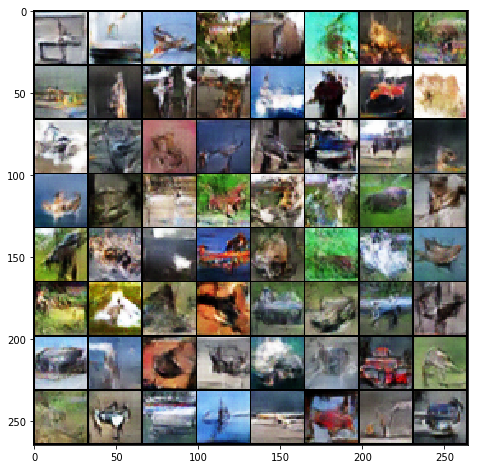

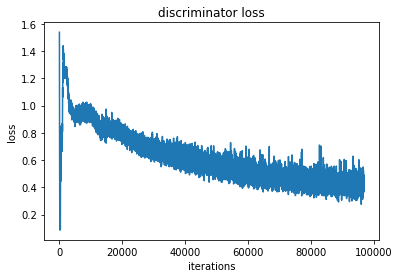

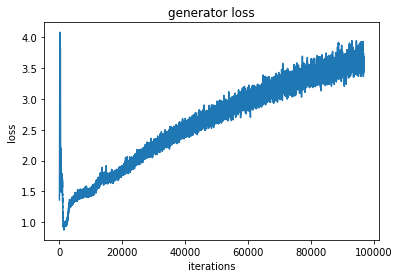

epoch  62
Iteration 96850/156200: dis loss = 0.3058, gen loss = 4.1853
Iteration 96900/156200: dis loss = 0.6697, gen loss = 5.1532
Iteration 96950/156200: dis loss = 0.4622, gen loss = 1.9230
Iteration 97000/156200: dis loss = 0.4815, gen loss = 2.9282
Iteration 97050/156200: dis loss = 0.4144, gen loss = 4.1566
Iteration 97100/156200: dis loss = 0.1460, gen loss = 3.7981
Iteration 97150/156200: dis loss = 0.5180, gen loss = 5.3977
Iteration 97200/156200: dis loss = 0.3564, gen loss = 2.1648
Iteration 97250/156200: dis loss = 0.1696, gen loss = 3.9422
Iteration 97300/156200: dis loss = 0.4513, gen loss = 4.2649
Iteration 97350/156200: dis loss = 0.3221, gen loss = 2.5845
Iteration 97400/156200: dis loss = 0.1142, gen loss = 3.7982
Iteration 97450/156200: dis loss = 0.4047, gen loss = 4.8610
Iteration 97500/156200: dis loss = 0.5866, gen loss = 1.6171
Iteration 97550/156200: dis loss = 0.3327, gen loss = 2.7183
Iteration 97600/156200: dis loss = 0.1563, gen loss = 4.3667
Iteration 9765

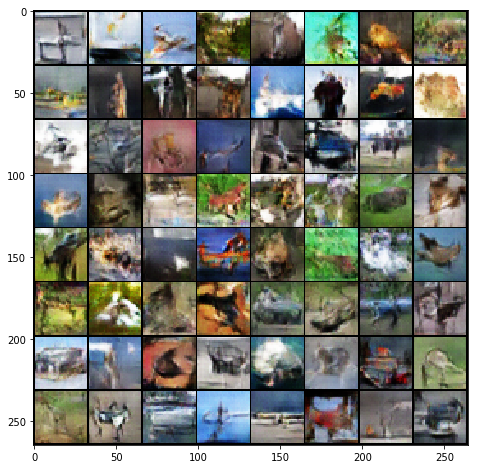

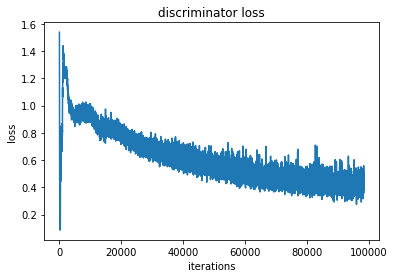

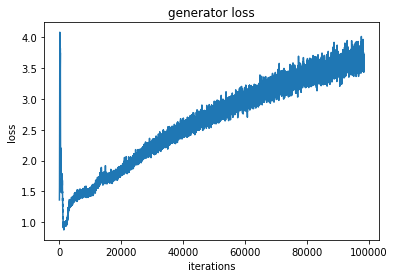

epoch  63
Iteration 98450/156200: dis loss = 0.2426, gen loss = 3.3286
Iteration 98500/156200: dis loss = 0.2484, gen loss = 3.4275
Iteration 98550/156200: dis loss = 0.6923, gen loss = 5.6367
Iteration 98600/156200: dis loss = 0.3764, gen loss = 3.1730
Iteration 98650/156200: dis loss = 0.1883, gen loss = 3.6167
Iteration 98700/156200: dis loss = 0.1947, gen loss = 3.9969
Iteration 98750/156200: dis loss = 0.1590, gen loss = 3.5438
Iteration 98800/156200: dis loss = 0.7691, gen loss = 1.4004
Iteration 98850/156200: dis loss = 0.3052, gen loss = 3.3299
Iteration 98900/156200: dis loss = 0.4630, gen loss = 2.1314
Iteration 98950/156200: dis loss = 0.3140, gen loss = 5.0893
Iteration 99000/156200: dis loss = 0.3196, gen loss = 4.7700
Iteration 99050/156200: dis loss = 0.1576, gen loss = 3.5219
Iteration 99100/156200: dis loss = 0.0596, gen loss = 4.5476
Iteration 99150/156200: dis loss = 0.3172, gen loss = 3.2110
Iteration 99200/156200: dis loss = 0.3089, gen loss = 2.4593
Iteration 9925

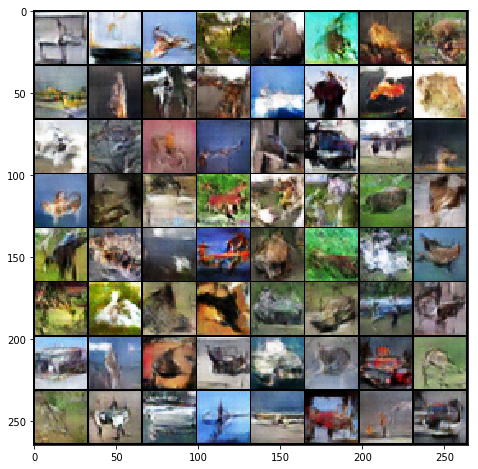

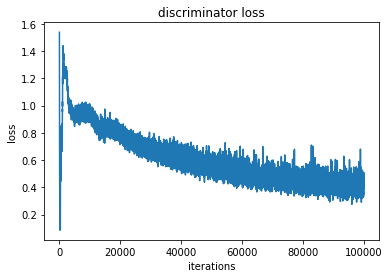

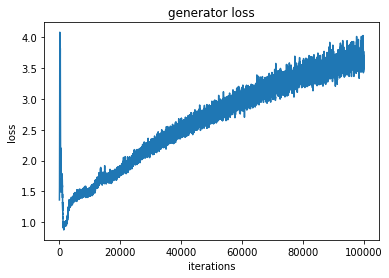

epoch  64
Iteration 100000/156200: dis loss = 0.2136, gen loss = 3.5391
Iteration 100050/156200: dis loss = 0.3173, gen loss = 4.2332
Iteration 100100/156200: dis loss = 0.2916, gen loss = 2.9252
Iteration 100150/156200: dis loss = 0.3571, gen loss = 2.8773
Iteration 100200/156200: dis loss = 0.4438, gen loss = 2.6971
Iteration 100250/156200: dis loss = 0.1952, gen loss = 3.3935
Iteration 100300/156200: dis loss = 0.2523, gen loss = 3.1305
Iteration 100350/156200: dis loss = 0.3578, gen loss = 4.5824
Iteration 100400/156200: dis loss = 0.2098, gen loss = 3.2478
Iteration 100450/156200: dis loss = 0.5130, gen loss = 5.2357
Iteration 100500/156200: dis loss = 0.8858, gen loss = 3.0287
Iteration 100550/156200: dis loss = 0.2305, gen loss = 3.1407
Iteration 100600/156200: dis loss = 1.0381, gen loss = 6.7685
Iteration 100650/156200: dis loss = 0.2705, gen loss = 4.0052
Iteration 100700/156200: dis loss = 0.5076, gen loss = 5.4139
Iteration 100750/156200: dis loss = 0.2522, gen loss = 4.592

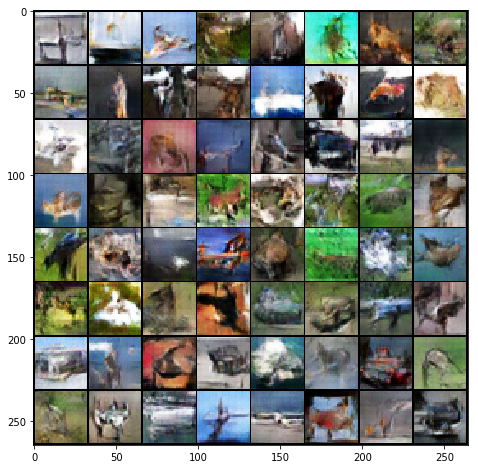

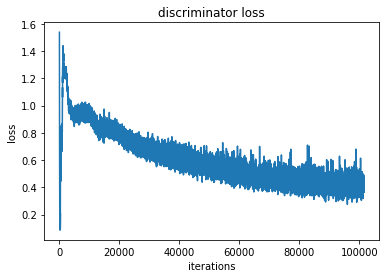

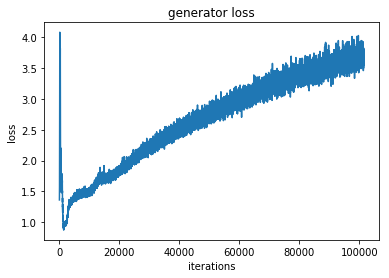

epoch  65
Iteration 101550/156200: dis loss = 0.3877, gen loss = 5.6450
Iteration 101600/156200: dis loss = 0.3359, gen loss = 3.2746
Iteration 101650/156200: dis loss = 0.6331, gen loss = 5.3671
Iteration 101700/156200: dis loss = 0.1710, gen loss = 3.9399
Iteration 101750/156200: dis loss = 0.4993, gen loss = 5.7396
Iteration 101800/156200: dis loss = 0.9164, gen loss = 4.5228
Iteration 101850/156200: dis loss = 0.2541, gen loss = 4.2079
Iteration 101900/156200: dis loss = 0.1756, gen loss = 3.6803
Iteration 101950/156200: dis loss = 0.2559, gen loss = 4.3627
Iteration 102000/156200: dis loss = 0.2480, gen loss = 3.1626
Iteration 102050/156200: dis loss = 0.1869, gen loss = 3.3477
Iteration 102100/156200: dis loss = 0.1198, gen loss = 4.2299
Iteration 102150/156200: dis loss = 0.2386, gen loss = 3.6286
Iteration 102200/156200: dis loss = 0.4964, gen loss = 2.6804
Iteration 102250/156200: dis loss = 0.4096, gen loss = 2.3386
Iteration 102300/156200: dis loss = 0.1493, gen loss = 4.173

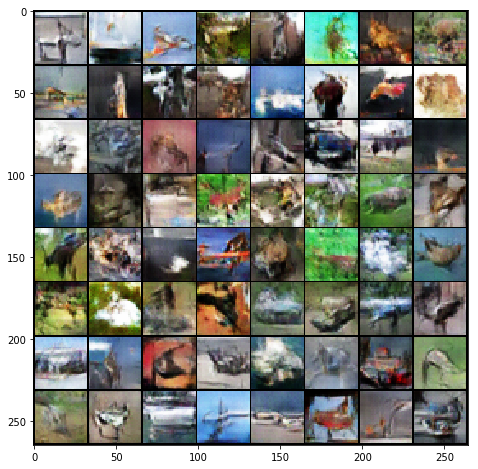

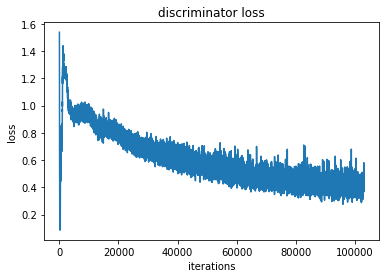

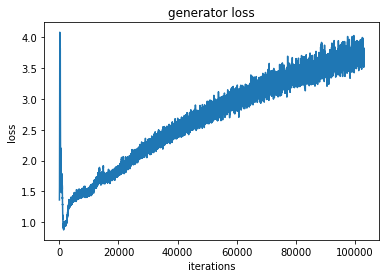

epoch  66
Iteration 103100/156200: dis loss = 0.2450, gen loss = 4.2330
Iteration 103150/156200: dis loss = 0.4649, gen loss = 6.1865
Iteration 103200/156200: dis loss = 0.4619, gen loss = 2.1483
Iteration 103250/156200: dis loss = 0.2389, gen loss = 3.3938
Iteration 103300/156200: dis loss = 0.2494, gen loss = 3.3365
Iteration 103350/156200: dis loss = 0.5347, gen loss = 5.6761
Iteration 103400/156200: dis loss = 0.3308, gen loss = 3.0863
Iteration 103450/156200: dis loss = 0.3717, gen loss = 2.0793
Iteration 103500/156200: dis loss = 0.2677, gen loss = 4.1826
Iteration 103550/156200: dis loss = 0.6148, gen loss = 1.6867
Iteration 103600/156200: dis loss = 0.1355, gen loss = 3.6651
Iteration 103650/156200: dis loss = 0.2645, gen loss = 3.8093
Iteration 103700/156200: dis loss = 0.3998, gen loss = 4.5613
Iteration 103750/156200: dis loss = 0.2063, gen loss = 3.5155
Iteration 103800/156200: dis loss = 0.5014, gen loss = 4.3331
Iteration 103850/156200: dis loss = 0.2432, gen loss = 4.497

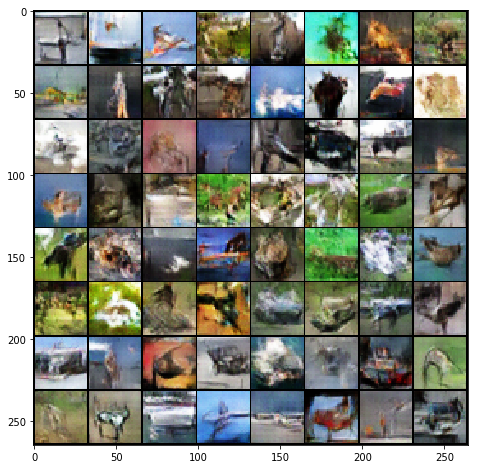

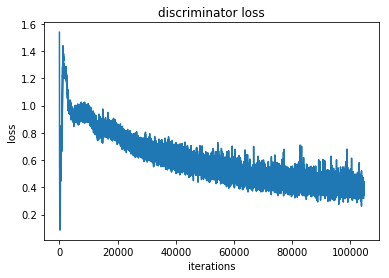

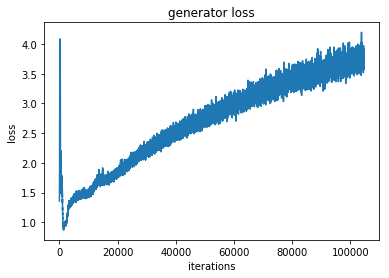

epoch  67
Iteration 104700/156200: dis loss = 0.3784, gen loss = 3.7578
Iteration 104750/156200: dis loss = 0.2914, gen loss = 3.8353
Iteration 104800/156200: dis loss = 0.3136, gen loss = 4.7623
Iteration 104850/156200: dis loss = 0.4801, gen loss = 5.4426
Iteration 104900/156200: dis loss = 0.2194, gen loss = 3.5569
Iteration 104950/156200: dis loss = 0.5695, gen loss = 3.1647
Iteration 105000/156200: dis loss = 0.3007, gen loss = 5.4854
Iteration 105050/156200: dis loss = 0.1752, gen loss = 4.1583
Iteration 105100/156200: dis loss = 0.8105, gen loss = 1.0949
Iteration 105150/156200: dis loss = 0.2892, gen loss = 3.3154
Iteration 105200/156200: dis loss = 0.8869, gen loss = 5.1001
Iteration 105250/156200: dis loss = 0.1016, gen loss = 4.1154
Iteration 105300/156200: dis loss = 0.4035, gen loss = 2.4269
Iteration 105350/156200: dis loss = 0.3475, gen loss = 5.5658
Iteration 105400/156200: dis loss = 0.3191, gen loss = 2.7610
Iteration 105450/156200: dis loss = 0.3839, gen loss = 2.079

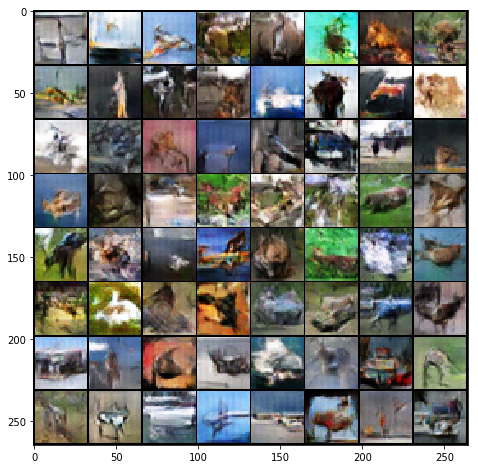

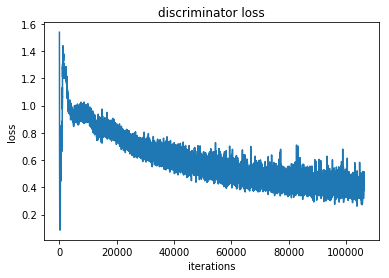

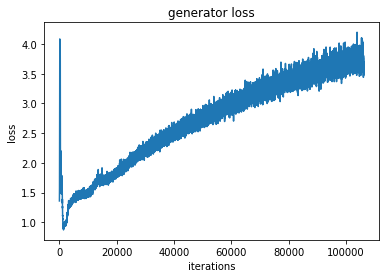

epoch  68
Iteration 106250/156200: dis loss = 0.2167, gen loss = 3.3955
Iteration 106300/156200: dis loss = 0.1897, gen loss = 4.2709
Iteration 106350/156200: dis loss = 0.1633, gen loss = 3.4524
Iteration 106400/156200: dis loss = 0.2273, gen loss = 3.2140
Iteration 106450/156200: dis loss = 0.9221, gen loss = 0.3706
Iteration 106500/156200: dis loss = 0.1459, gen loss = 4.9711
Iteration 106550/156200: dis loss = 0.7312, gen loss = 4.9801
Iteration 106600/156200: dis loss = 0.2208, gen loss = 4.2423
Iteration 106650/156200: dis loss = 0.2154, gen loss = 3.6555
Iteration 106700/156200: dis loss = 0.2402, gen loss = 3.3290
Iteration 106750/156200: dis loss = 0.2935, gen loss = 3.5385
Iteration 106800/156200: dis loss = 0.2790, gen loss = 2.5635
Iteration 106850/156200: dis loss = 0.5570, gen loss = 3.9958
Iteration 106900/156200: dis loss = 1.2216, gen loss = 5.9528
Iteration 106950/156200: dis loss = 0.3975, gen loss = 4.8739
Iteration 107000/156200: dis loss = 0.2728, gen loss = 3.950

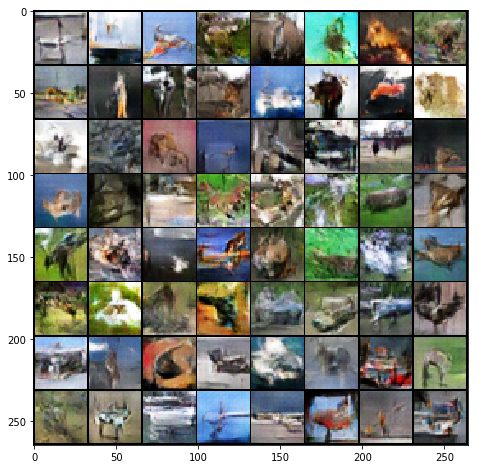

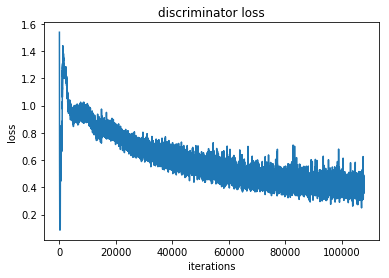

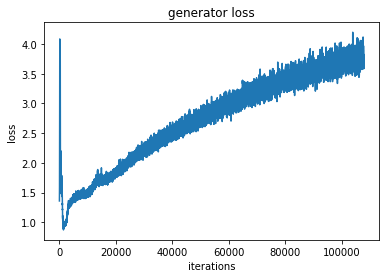

epoch  69
Iteration 107800/156200: dis loss = 0.4942, gen loss = 2.0307
Iteration 107850/156200: dis loss = 0.5947, gen loss = 1.4495
Iteration 107900/156200: dis loss = 0.2178, gen loss = 3.6021
Iteration 107950/156200: dis loss = 0.3548, gen loss = 4.1923
Iteration 108000/156200: dis loss = 0.2084, gen loss = 3.6276
Iteration 108050/156200: dis loss = 0.1236, gen loss = 3.9288
Iteration 108100/156200: dis loss = 0.3535, gen loss = 4.4321
Iteration 108150/156200: dis loss = 0.3881, gen loss = 5.2153
Iteration 108200/156200: dis loss = 0.3244, gen loss = 3.2774
Iteration 108250/156200: dis loss = 0.2069, gen loss = 2.8692
Iteration 108300/156200: dis loss = 0.3317, gen loss = 4.6641
Iteration 108350/156200: dis loss = 0.1877, gen loss = 3.9951
Iteration 108400/156200: dis loss = 0.5579, gen loss = 3.9841
Iteration 108450/156200: dis loss = 0.2476, gen loss = 3.9391
Iteration 108500/156200: dis loss = 0.3154, gen loss = 2.6507
Iteration 108550/156200: dis loss = 0.5752, gen loss = 6.264

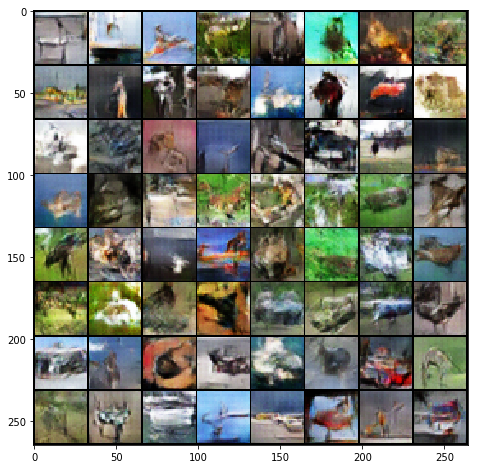

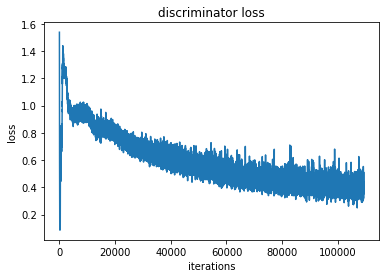

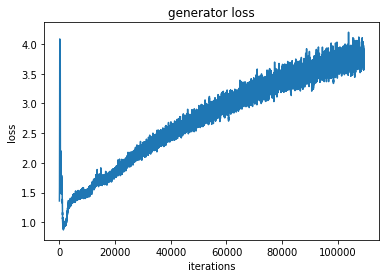

epoch  70
Iteration 109350/156200: dis loss = 0.1523, gen loss = 4.0659
Iteration 109400/156200: dis loss = 0.1846, gen loss = 3.7023
Iteration 109450/156200: dis loss = 0.7358, gen loss = 1.6561
Iteration 109500/156200: dis loss = 0.0964, gen loss = 4.2144
Iteration 109550/156200: dis loss = 0.4969, gen loss = 4.5766
Iteration 109600/156200: dis loss = 0.3092, gen loss = 3.6257
Iteration 109650/156200: dis loss = 0.7961, gen loss = 2.6607
Iteration 109700/156200: dis loss = 0.2027, gen loss = 3.4128
Iteration 109750/156200: dis loss = 0.3628, gen loss = 4.8927
Iteration 109800/156200: dis loss = 0.4964, gen loss = 5.6507
Iteration 109850/156200: dis loss = 0.2121, gen loss = 5.2437
Iteration 109900/156200: dis loss = 0.3810, gen loss = 2.7439
Iteration 109950/156200: dis loss = 0.2343, gen loss = 4.1871
Iteration 110000/156200: dis loss = 0.2876, gen loss = 2.8725
Iteration 110050/156200: dis loss = 1.0745, gen loss = 0.6520
Iteration 110100/156200: dis loss = 0.3739, gen loss = 5.697

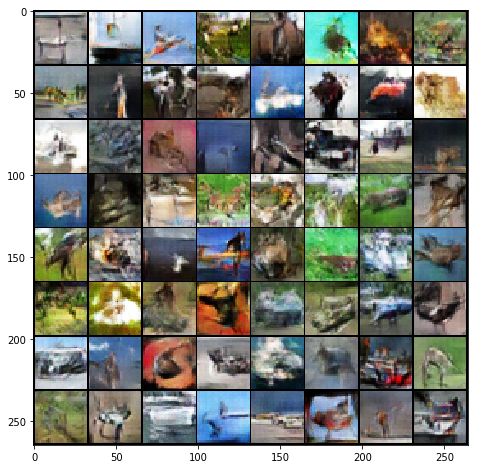

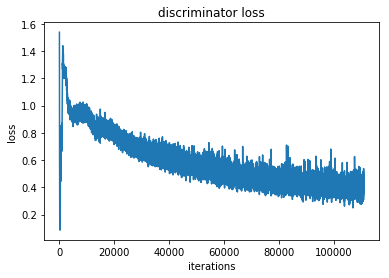

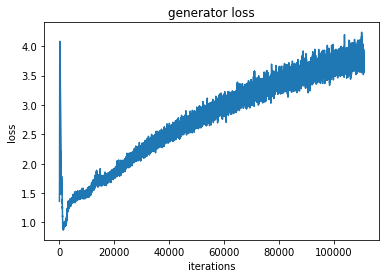

epoch  71
Iteration 110950/156200: dis loss = 0.1734, gen loss = 4.1146
Iteration 111000/156200: dis loss = 0.2018, gen loss = 4.2241
Iteration 111050/156200: dis loss = 0.3840, gen loss = 2.5426
Iteration 111100/156200: dis loss = 0.2712, gen loss = 4.6649
Iteration 111150/156200: dis loss = 0.5311, gen loss = 1.7996
Iteration 111200/156200: dis loss = 0.2562, gen loss = 4.7404
Iteration 111250/156200: dis loss = 1.2603, gen loss = 5.8736
Iteration 111300/156200: dis loss = 0.2886, gen loss = 5.5597
Iteration 111350/156200: dis loss = 0.3108, gen loss = 2.5333
Iteration 111400/156200: dis loss = 0.1981, gen loss = 3.7350
Iteration 111450/156200: dis loss = 0.3524, gen loss = 2.5636
Iteration 111500/156200: dis loss = 0.3250, gen loss = 2.8261
Iteration 111550/156200: dis loss = 0.2707, gen loss = 3.2428
Iteration 111600/156200: dis loss = 0.2153, gen loss = 3.9650
Iteration 111650/156200: dis loss = 0.1325, gen loss = 4.3967
Iteration 111700/156200: dis loss = 1.2079, gen loss = 2.714

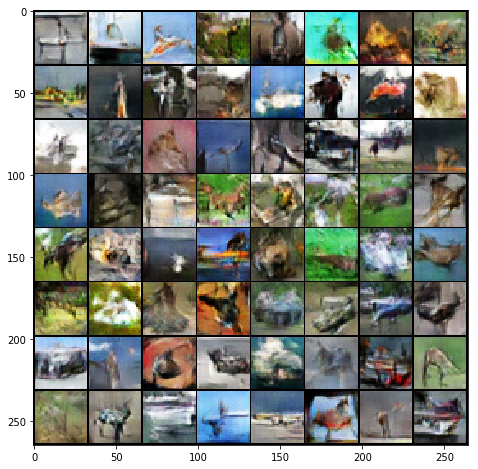

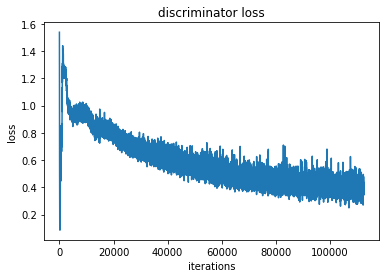

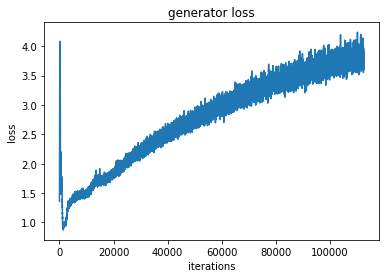

epoch  72
Iteration 112500/156200: dis loss = 0.2628, gen loss = 4.5576
Iteration 112550/156200: dis loss = 0.4846, gen loss = 5.2112
Iteration 112600/156200: dis loss = 0.4612, gen loss = 6.4823
Iteration 112650/156200: dis loss = 0.1541, gen loss = 4.0550
Iteration 112700/156200: dis loss = 0.3972, gen loss = 0.8524
Iteration 112750/156200: dis loss = 0.2288, gen loss = 3.3679
Iteration 112800/156200: dis loss = 0.3041, gen loss = 3.0874
Iteration 112850/156200: dis loss = 0.1563, gen loss = 3.5896
Iteration 112900/156200: dis loss = 0.1927, gen loss = 4.0904
Iteration 112950/156200: dis loss = 0.5201, gen loss = 5.3691
Iteration 113000/156200: dis loss = 0.1796, gen loss = 4.2428
Iteration 113050/156200: dis loss = 0.4542, gen loss = 4.7843
Iteration 113100/156200: dis loss = 0.4230, gen loss = 2.9178
Iteration 113150/156200: dis loss = 0.2561, gen loss = 3.2518
Iteration 113200/156200: dis loss = 0.1125, gen loss = 3.9995
Iteration 113250/156200: dis loss = 0.2944, gen loss = 3.660

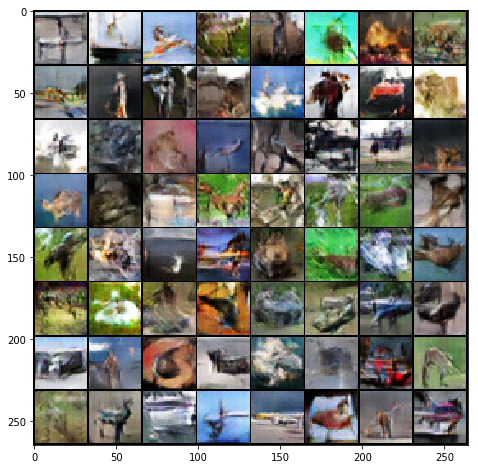

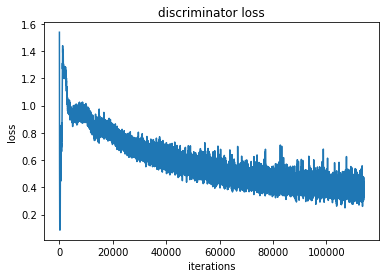

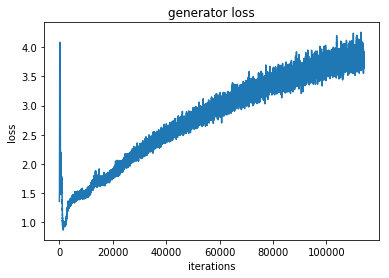

epoch  73
Iteration 114050/156200: dis loss = 0.3262, gen loss = 2.3133
Iteration 114100/156200: dis loss = 0.3517, gen loss = 5.0700
Iteration 114150/156200: dis loss = 0.2794, gen loss = 3.5703
Iteration 114200/156200: dis loss = 0.2656, gen loss = 3.7022
Iteration 114250/156200: dis loss = 0.1608, gen loss = 3.6955
Iteration 114300/156200: dis loss = 0.1683, gen loss = 3.7365
Iteration 114350/156200: dis loss = 0.3987, gen loss = 3.7165
Iteration 114400/156200: dis loss = 1.4384, gen loss = 5.1807
Iteration 114450/156200: dis loss = 0.4280, gen loss = 2.8336
Iteration 114500/156200: dis loss = 0.1768, gen loss = 4.2042
Iteration 114550/156200: dis loss = 0.2522, gen loss = 2.8440
Iteration 114600/156200: dis loss = 0.8945, gen loss = 1.0033
Iteration 114650/156200: dis loss = 1.0910, gen loss = 2.1391
Iteration 114700/156200: dis loss = 0.3194, gen loss = 2.9700
Iteration 114750/156200: dis loss = 0.3950, gen loss = 2.7479
Iteration 114800/156200: dis loss = 0.4137, gen loss = 6.115

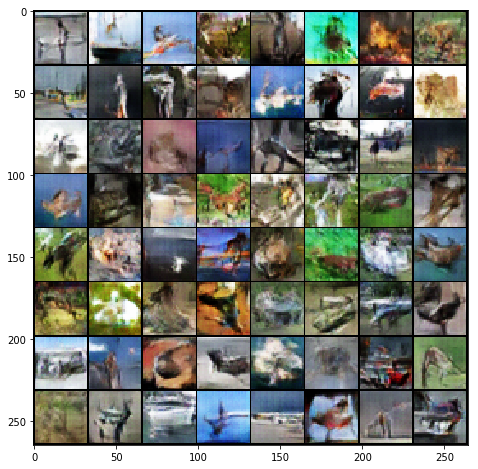

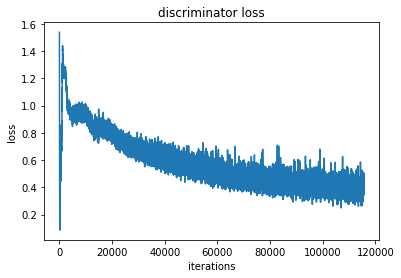

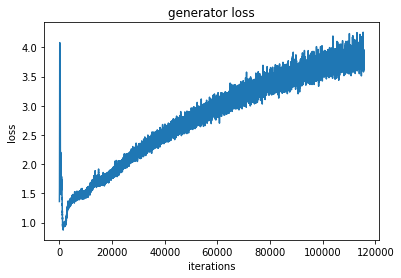

epoch  74
Iteration 115600/156200: dis loss = 0.1385, gen loss = 4.3688
Iteration 115650/156200: dis loss = 0.2357, gen loss = 3.6396
Iteration 115700/156200: dis loss = 0.1671, gen loss = 4.0473
Iteration 115750/156200: dis loss = 0.5612, gen loss = 4.7078
Iteration 115800/156200: dis loss = 0.2894, gen loss = 4.5063
Iteration 115850/156200: dis loss = 0.3204, gen loss = 2.1767
Iteration 115900/156200: dis loss = 0.4605, gen loss = 2.1847
Iteration 115950/156200: dis loss = 0.1850, gen loss = 3.1370
Iteration 116000/156200: dis loss = 0.1589, gen loss = 3.5693
Iteration 116050/156200: dis loss = 0.1311, gen loss = 4.7241
Iteration 116100/156200: dis loss = 0.3063, gen loss = 2.7005
Iteration 116150/156200: dis loss = 0.2017, gen loss = 4.9326
Iteration 116200/156200: dis loss = 0.2544, gen loss = 3.3363
Iteration 116250/156200: dis loss = 0.8056, gen loss = 7.1991
Iteration 116300/156200: dis loss = 0.2123, gen loss = 4.1169
Iteration 116350/156200: dis loss = 0.0954, gen loss = 4.465

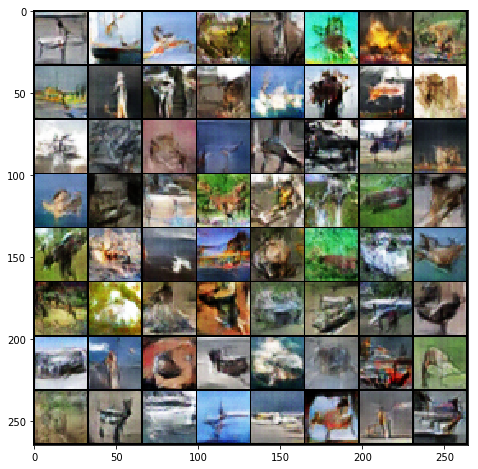

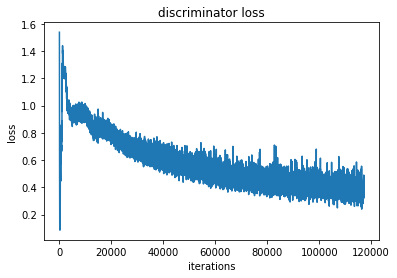

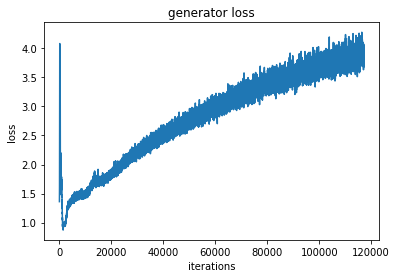

epoch  75
Iteration 117200/156200: dis loss = 0.3162, gen loss = 4.7885
Iteration 117250/156200: dis loss = 0.3725, gen loss = 3.3074
Iteration 117300/156200: dis loss = 0.2227, gen loss = 3.5043
Iteration 117350/156200: dis loss = 0.2396, gen loss = 2.9716
Iteration 117400/156200: dis loss = 0.2245, gen loss = 4.5830
Iteration 117450/156200: dis loss = 0.1507, gen loss = 4.3433
Iteration 117500/156200: dis loss = 0.2371, gen loss = 3.4864
Iteration 117550/156200: dis loss = 0.4944, gen loss = 1.6579
Iteration 117600/156200: dis loss = 0.2410, gen loss = 3.5638
Iteration 117650/156200: dis loss = 0.2433, gen loss = 4.2532
Iteration 117700/156200: dis loss = 0.2102, gen loss = 3.0875
Iteration 117750/156200: dis loss = 0.3049, gen loss = 4.5441
Iteration 117800/156200: dis loss = 0.1731, gen loss = 4.3549
Iteration 117850/156200: dis loss = 0.2641, gen loss = 4.9563
Iteration 117900/156200: dis loss = 0.2791, gen loss = 6.1157
Iteration 117950/156200: dis loss = 0.4710, gen loss = 3.596

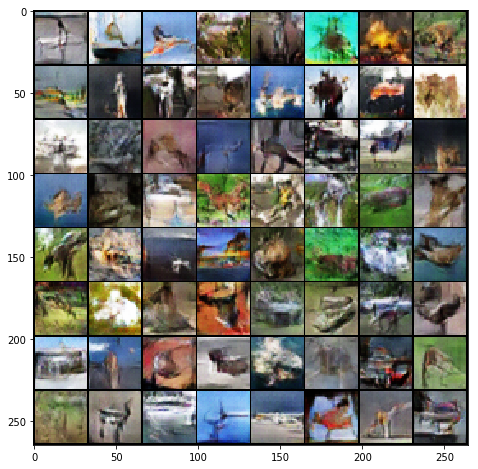

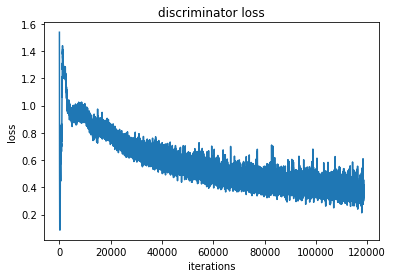

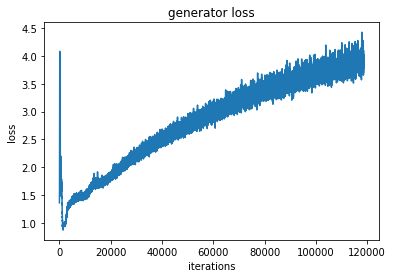

epoch  76
Iteration 118750/156200: dis loss = 0.5410, gen loss = 2.1932
Iteration 118800/156200: dis loss = 0.1366, gen loss = 4.0643
Iteration 118850/156200: dis loss = 0.4141, gen loss = 5.7705
Iteration 118900/156200: dis loss = 0.2447, gen loss = 3.0671
Iteration 118950/156200: dis loss = 0.1286, gen loss = 3.8332
Iteration 119000/156200: dis loss = 0.2736, gen loss = 4.1110
Iteration 119050/156200: dis loss = 0.3600, gen loss = 3.2735
Iteration 119100/156200: dis loss = 0.3339, gen loss = 5.5185
Iteration 119150/156200: dis loss = 0.2292, gen loss = 4.3040
Iteration 119200/156200: dis loss = 0.4954, gen loss = 2.1103
Iteration 119250/156200: dis loss = 0.2110, gen loss = 4.3579
Iteration 119300/156200: dis loss = 0.2112, gen loss = 3.3818
Iteration 119350/156200: dis loss = 0.4917, gen loss = 4.7082
Iteration 119400/156200: dis loss = 0.5598, gen loss = 4.7165
Iteration 119450/156200: dis loss = 0.9713, gen loss = 0.7065
Iteration 119500/156200: dis loss = 0.0966, gen loss = 4.128

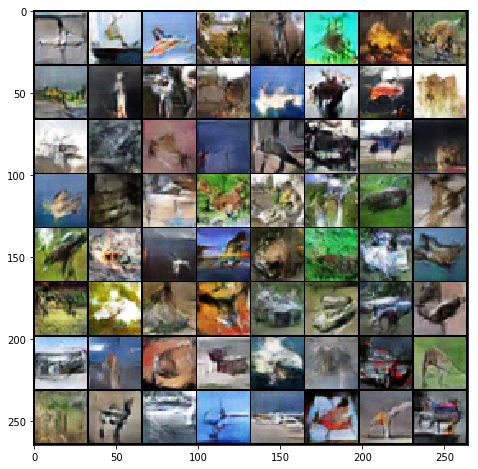

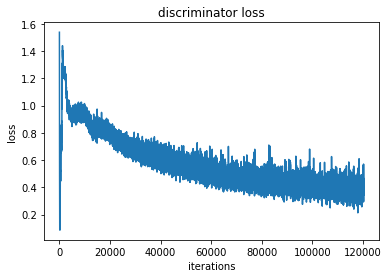

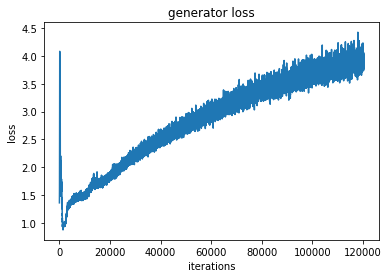

epoch  77
Iteration 120300/156200: dis loss = 0.7022, gen loss = 3.7288
Iteration 120350/156200: dis loss = 0.2345, gen loss = 3.9377
Iteration 120400/156200: dis loss = 0.1836, gen loss = 3.4571
Iteration 120450/156200: dis loss = 0.2674, gen loss = 4.7532
Iteration 120500/156200: dis loss = 0.5282, gen loss = 1.5825
Iteration 120550/156200: dis loss = 0.2167, gen loss = 2.7942
Iteration 120600/156200: dis loss = 0.2532, gen loss = 3.5646
Iteration 120650/156200: dis loss = 0.4486, gen loss = 5.2363
Iteration 120700/156200: dis loss = 0.1567, gen loss = 4.4065
Iteration 120750/156200: dis loss = 0.2776, gen loss = 5.5364
Iteration 120800/156200: dis loss = 0.2662, gen loss = 2.8132
Iteration 120850/156200: dis loss = 0.7551, gen loss = 6.4772
Iteration 120900/156200: dis loss = 0.6489, gen loss = 5.0963
Iteration 120950/156200: dis loss = 0.3469, gen loss = 4.7043
Iteration 121000/156200: dis loss = 0.7406, gen loss = 6.8271
Iteration 121050/156200: dis loss = 0.2630, gen loss = 5.666

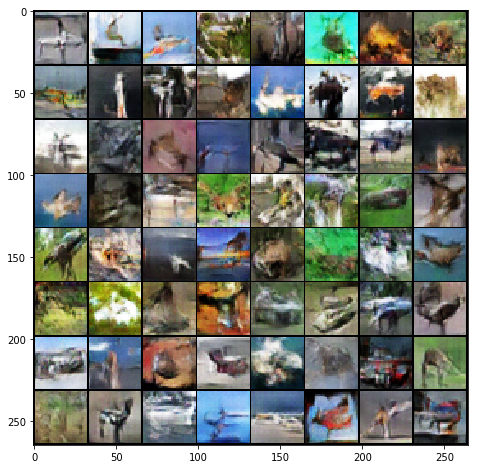

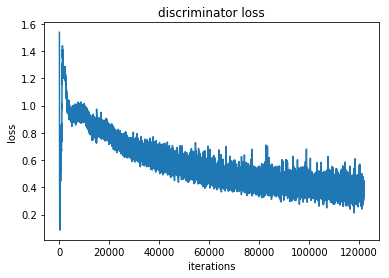

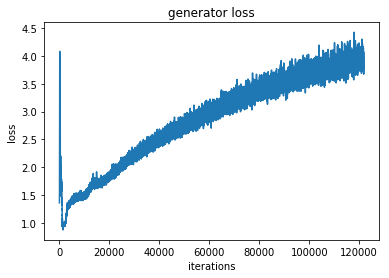

epoch  78
Iteration 121850/156200: dis loss = 0.2959, gen loss = 5.0014
Iteration 121900/156200: dis loss = 0.1532, gen loss = 3.4387
Iteration 121950/156200: dis loss = 0.1770, gen loss = 4.0790
Iteration 122000/156200: dis loss = 0.1564, gen loss = 3.7942
Iteration 122050/156200: dis loss = 0.1879, gen loss = 3.8543
Iteration 122100/156200: dis loss = 0.4800, gen loss = 1.9545
Iteration 122150/156200: dis loss = 0.8365, gen loss = 1.2911
Iteration 122200/156200: dis loss = 0.1633, gen loss = 3.8238
Iteration 122250/156200: dis loss = 0.1836, gen loss = 3.5915
Iteration 122300/156200: dis loss = 0.2150, gen loss = 2.5618
Iteration 122350/156200: dis loss = 0.1597, gen loss = 4.7186
Iteration 122400/156200: dis loss = 0.2899, gen loss = 3.7200
Iteration 122450/156200: dis loss = 0.1598, gen loss = 3.2442
Iteration 122500/156200: dis loss = 0.6229, gen loss = 1.4174
Iteration 122550/156200: dis loss = 0.1955, gen loss = 4.6722
Iteration 122600/156200: dis loss = 0.1523, gen loss = 4.090

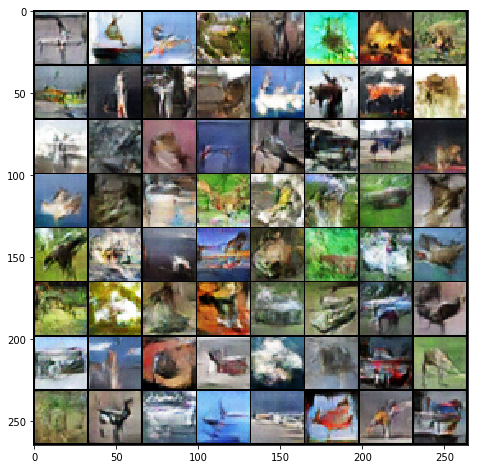

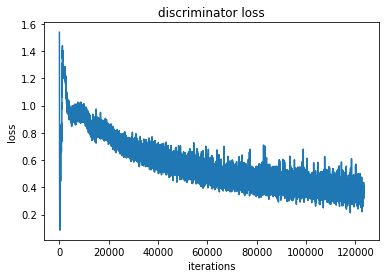

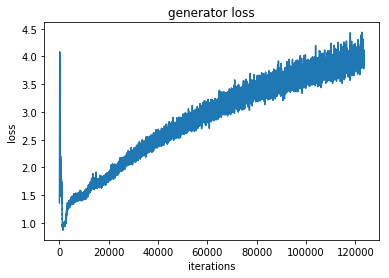

epoch  79
Iteration 123400/156200: dis loss = 0.2474, gen loss = 3.2965
Iteration 123450/156200: dis loss = 0.1315, gen loss = 4.3219
Iteration 123500/156200: dis loss = 0.1712, gen loss = 3.9414
Iteration 123550/156200: dis loss = 0.3933, gen loss = 5.8977
Iteration 123600/156200: dis loss = 0.1132, gen loss = 5.6584
Iteration 123650/156200: dis loss = 0.4287, gen loss = 2.3555
Iteration 123700/156200: dis loss = 0.4594, gen loss = 2.0966
Iteration 123750/156200: dis loss = 0.1309, gen loss = 4.5700
Iteration 123800/156200: dis loss = 0.8979, gen loss = 2.7420
Iteration 123850/156200: dis loss = 0.0765, gen loss = 4.5263
Iteration 123900/156200: dis loss = 0.1404, gen loss = 3.8349
Iteration 123950/156200: dis loss = 0.3533, gen loss = 2.3235
Iteration 124000/156200: dis loss = 0.1560, gen loss = 3.9917
Iteration 124050/156200: dis loss = 0.1669, gen loss = 3.5961
Iteration 124100/156200: dis loss = 0.2484, gen loss = 5.3837
Iteration 124150/156200: dis loss = 0.3030, gen loss = 3.400

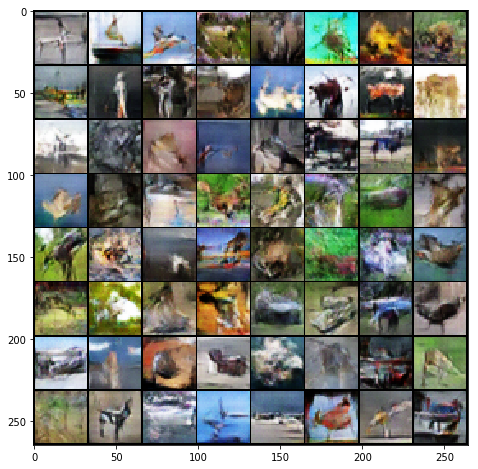

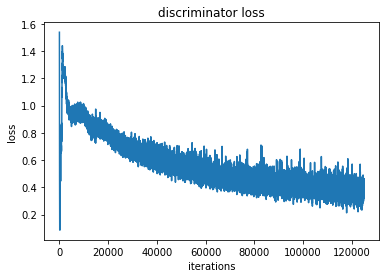

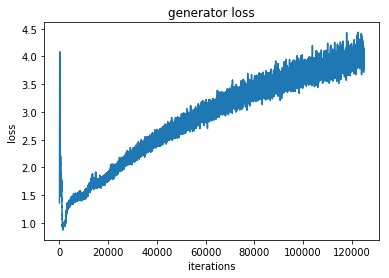

epoch  80
Iteration 125000/156200: dis loss = 0.3306, gen loss = 5.5265
Iteration 125050/156200: dis loss = 0.1514, gen loss = 3.3391
Iteration 125100/156200: dis loss = 0.3606, gen loss = 4.6036
Iteration 125150/156200: dis loss = 0.2167, gen loss = 3.7726
Iteration 125200/156200: dis loss = 0.0871, gen loss = 4.0767
Iteration 125250/156200: dis loss = 0.6380, gen loss = 6.1528
Iteration 125300/156200: dis loss = 0.2550, gen loss = 4.7871
Iteration 125350/156200: dis loss = 0.2910, gen loss = 2.4944
Iteration 125400/156200: dis loss = 0.2859, gen loss = 5.1674
Iteration 125450/156200: dis loss = 0.8494, gen loss = 1.9644
Iteration 125500/156200: dis loss = 0.0998, gen loss = 4.5072
Iteration 125550/156200: dis loss = 0.2891, gen loss = 2.7387
Iteration 125600/156200: dis loss = 0.3915, gen loss = 3.4492
Iteration 125650/156200: dis loss = 0.1936, gen loss = 4.0385
Iteration 125700/156200: dis loss = 0.2479, gen loss = 3.1511
Iteration 125750/156200: dis loss = 0.2695, gen loss = 4.738

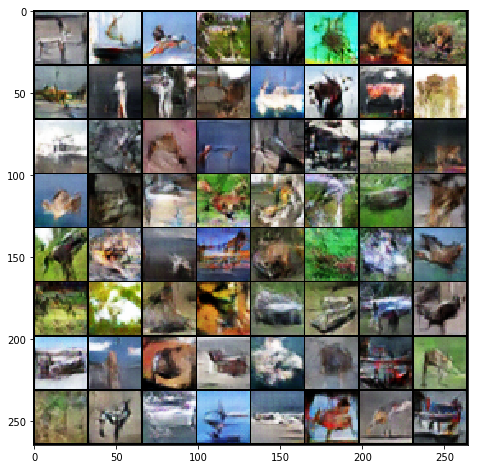

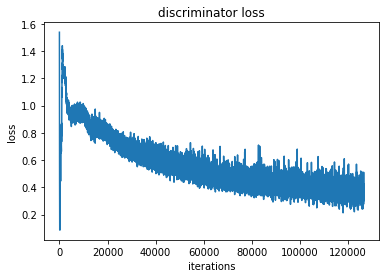

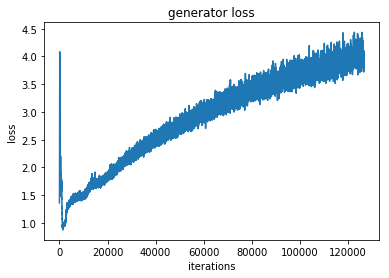

epoch  81
Iteration 126550/156200: dis loss = 0.1440, gen loss = 3.6791
Iteration 126600/156200: dis loss = 0.3893, gen loss = 3.6265
Iteration 126650/156200: dis loss = 0.1378, gen loss = 4.3469
Iteration 126700/156200: dis loss = 0.4343, gen loss = 5.3357
Iteration 126750/156200: dis loss = 0.1704, gen loss = 5.3807
Iteration 126800/156200: dis loss = 0.2023, gen loss = 4.0002
Iteration 126850/156200: dis loss = 0.5846, gen loss = 6.8437
Iteration 126900/156200: dis loss = 0.1192, gen loss = 3.7878
Iteration 126950/156200: dis loss = 0.2118, gen loss = 3.1025
Iteration 127000/156200: dis loss = 0.2337, gen loss = 5.1434
Iteration 127050/156200: dis loss = 0.2011, gen loss = 3.2371
Iteration 127100/156200: dis loss = 0.4594, gen loss = 2.4843
Iteration 127150/156200: dis loss = 0.1670, gen loss = 4.3700
Iteration 127200/156200: dis loss = 0.1826, gen loss = 3.7191
Iteration 127250/156200: dis loss = 0.2691, gen loss = 4.0161
Iteration 127300/156200: dis loss = 0.2774, gen loss = 4.790

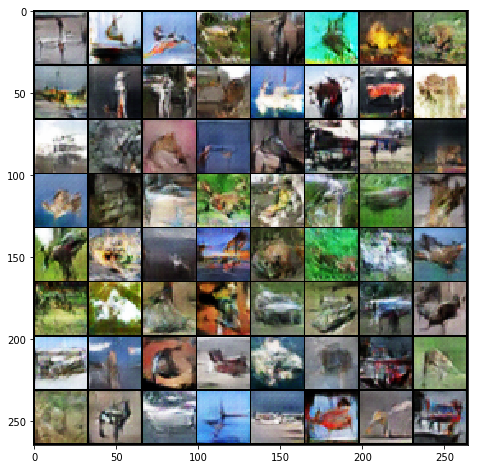

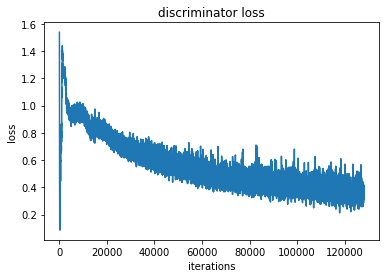

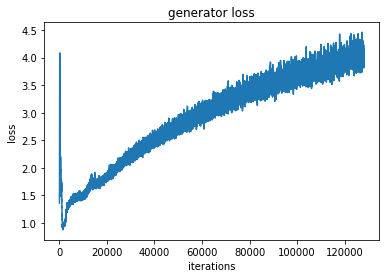

epoch  82
Iteration 128100/156200: dis loss = 0.1158, gen loss = 4.7544
Iteration 128150/156200: dis loss = 0.2159, gen loss = 3.3691
Iteration 128200/156200: dis loss = 0.2802, gen loss = 3.9309
Iteration 128250/156200: dis loss = 1.0341, gen loss = 1.5664
Iteration 128300/156200: dis loss = 0.1779, gen loss = 3.3861
Iteration 128350/156200: dis loss = 0.1756, gen loss = 4.6278
Iteration 128400/156200: dis loss = 0.3922, gen loss = 2.9548
Iteration 128450/156200: dis loss = 0.2292, gen loss = 4.3330
Iteration 128500/156200: dis loss = 0.3238, gen loss = 3.0924
Iteration 128550/156200: dis loss = 0.1395, gen loss = 4.3530
Iteration 128600/156200: dis loss = 0.6001, gen loss = 2.2590
Iteration 128650/156200: dis loss = 0.1685, gen loss = 4.6115
Iteration 128700/156200: dis loss = 0.2931, gen loss = 5.7321
Iteration 128750/156200: dis loss = 0.5435, gen loss = 2.9729
Iteration 128800/156200: dis loss = 0.3385, gen loss = 5.4717
Iteration 128850/156200: dis loss = 0.2384, gen loss = 5.558

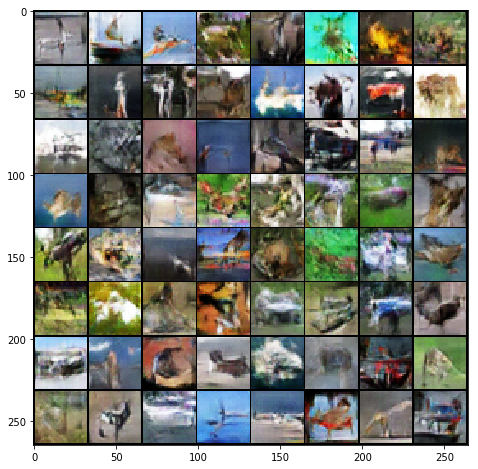

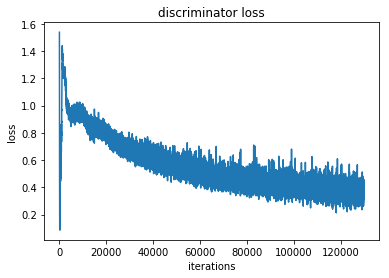

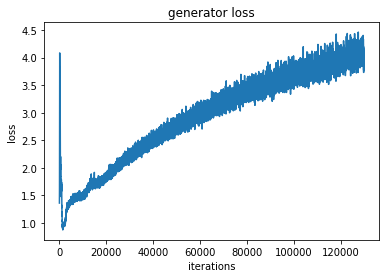

epoch  83
Iteration 129650/156200: dis loss = 0.4709, gen loss = 5.2468
Iteration 129700/156200: dis loss = 0.0638, gen loss = 4.9745
Iteration 129750/156200: dis loss = 0.4347, gen loss = 3.6427
Iteration 129800/156200: dis loss = 0.5172, gen loss = 2.6206
Iteration 129850/156200: dis loss = 0.2340, gen loss = 4.0728
Iteration 129900/156200: dis loss = 0.2274, gen loss = 4.0742
Iteration 129950/156200: dis loss = 0.3242, gen loss = 3.0364
Iteration 130000/156200: dis loss = 0.1512, gen loss = 3.7861
Iteration 130050/156200: dis loss = 0.0863, gen loss = 4.3715
Iteration 130100/156200: dis loss = 1.6980, gen loss = 7.5532
Iteration 130150/156200: dis loss = 0.3658, gen loss = 5.8305
Iteration 130200/156200: dis loss = 0.4328, gen loss = 5.8620
Iteration 130250/156200: dis loss = 0.1671, gen loss = 3.6703
Iteration 130300/156200: dis loss = 0.3344, gen loss = 5.5898
Iteration 130350/156200: dis loss = 0.6874, gen loss = 1.3375
Iteration 130400/156200: dis loss = 0.3755, gen loss = 2.331

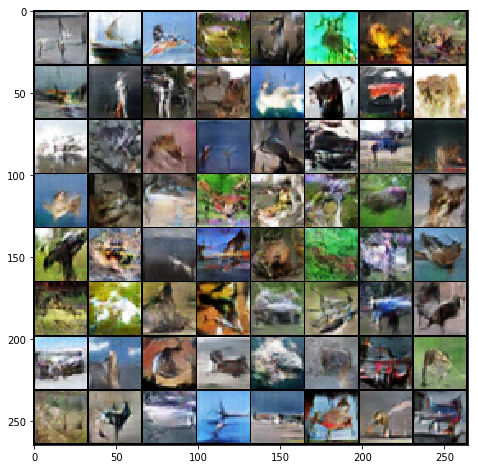

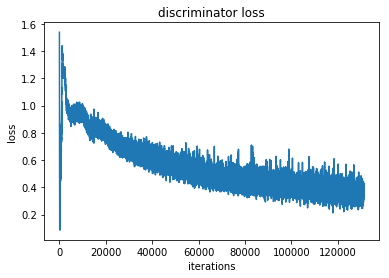

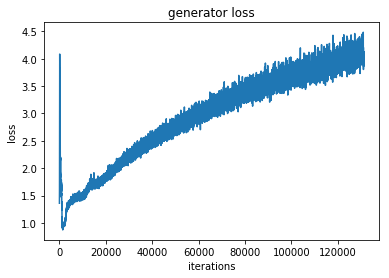

epoch  84
Iteration 131250/156200: dis loss = 0.3945, gen loss = 2.0116
Iteration 131300/156200: dis loss = 0.2706, gen loss = 2.9357
Iteration 131350/156200: dis loss = 0.8838, gen loss = 6.9939
Iteration 131400/156200: dis loss = 0.1251, gen loss = 4.3139
Iteration 131450/156200: dis loss = 0.2478, gen loss = 3.5971
Iteration 131500/156200: dis loss = 0.1384, gen loss = 4.5795
Iteration 131550/156200: dis loss = 0.0534, gen loss = 4.7239
Iteration 131600/156200: dis loss = 0.2033, gen loss = 4.2661
Iteration 131650/156200: dis loss = 1.4210, gen loss = 7.3968
Iteration 131700/156200: dis loss = 0.1275, gen loss = 4.0860
Iteration 131750/156200: dis loss = 0.3543, gen loss = 5.5678
Iteration 131800/156200: dis loss = 1.0086, gen loss = 3.6650
Iteration 131850/156200: dis loss = 0.4676, gen loss = 4.7454
Iteration 131900/156200: dis loss = 0.2155, gen loss = 3.1772
Iteration 131950/156200: dis loss = 0.1123, gen loss = 4.7350
Iteration 132000/156200: dis loss = 0.4742, gen loss = 5.497

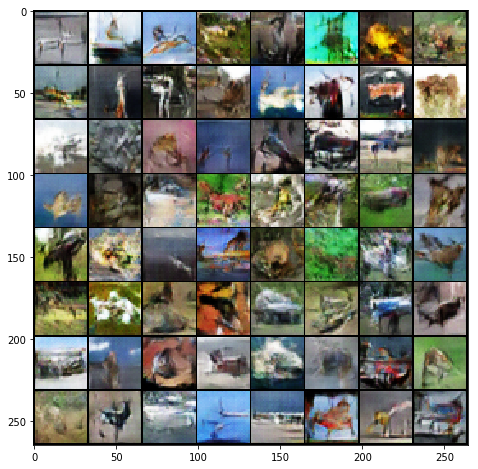

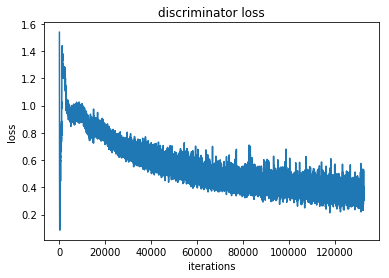

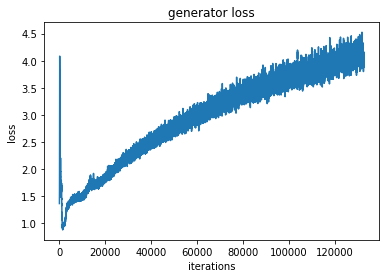

epoch  85
Iteration 132800/156200: dis loss = 0.3398, gen loss = 5.1811
Iteration 132850/156200: dis loss = 0.2516, gen loss = 3.5096
Iteration 132900/156200: dis loss = 0.2653, gen loss = 4.0705
Iteration 132950/156200: dis loss = 0.3625, gen loss = 2.1385
Iteration 133000/156200: dis loss = 0.1223, gen loss = 4.1527
Iteration 133050/156200: dis loss = 0.2839, gen loss = 4.4400
Iteration 133100/156200: dis loss = 0.2639, gen loss = 3.4944
Iteration 133150/156200: dis loss = 0.6442, gen loss = 4.8900
Iteration 133200/156200: dis loss = 0.3287, gen loss = 3.8720
Iteration 133250/156200: dis loss = 0.2330, gen loss = 4.4390
Iteration 133300/156200: dis loss = 0.1178, gen loss = 4.0728
Iteration 133350/156200: dis loss = 0.6512, gen loss = 6.9453
Iteration 133400/156200: dis loss = 0.5109, gen loss = 5.0056
Iteration 133450/156200: dis loss = 0.2009, gen loss = 2.9150
Iteration 133500/156200: dis loss = 0.3010, gen loss = 3.5199
Iteration 133550/156200: dis loss = 0.0618, gen loss = 4.332

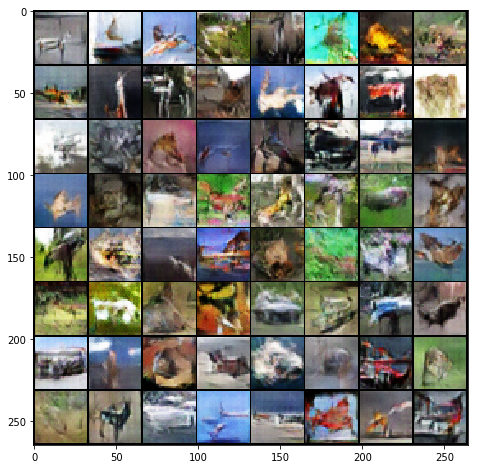

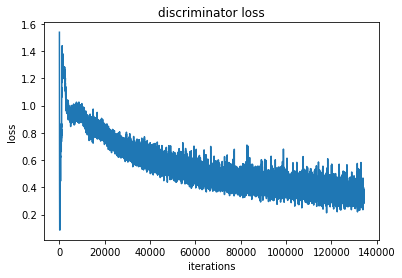

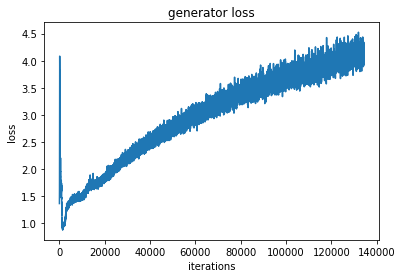

epoch  86
Iteration 134350/156200: dis loss = 0.1859, gen loss = 3.4867
Iteration 134400/156200: dis loss = 0.4096, gen loss = 6.1150
Iteration 134450/156200: dis loss = 0.4101, gen loss = 1.9971
Iteration 134500/156200: dis loss = 0.5281, gen loss = 1.3197
Iteration 134550/156200: dis loss = 0.3810, gen loss = 5.2923
Iteration 134600/156200: dis loss = 0.3025, gen loss = 3.2296
Iteration 134650/156200: dis loss = 0.2772, gen loss = 3.2186
Iteration 134700/156200: dis loss = 0.3733, gen loss = 2.1480
Iteration 134750/156200: dis loss = 0.5659, gen loss = 2.2891
Iteration 134800/156200: dis loss = 0.7443, gen loss = 5.9968
Iteration 134850/156200: dis loss = 0.0920, gen loss = 4.7486
Iteration 134900/156200: dis loss = 0.2814, gen loss = 3.6503
Iteration 134950/156200: dis loss = 0.2872, gen loss = 3.6654
Iteration 135000/156200: dis loss = 0.4139, gen loss = 2.6754
Iteration 135050/156200: dis loss = 0.1861, gen loss = 3.8773
Iteration 135100/156200: dis loss = 0.1014, gen loss = 4.506

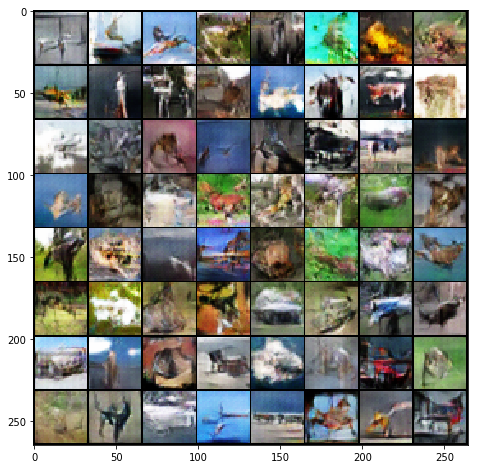

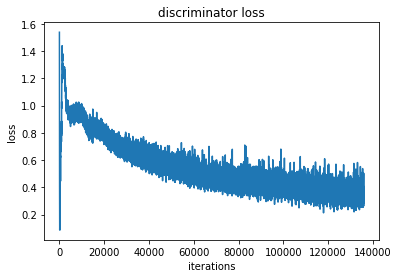

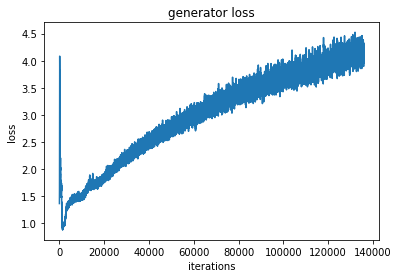

epoch  87
Iteration 135900/156200: dis loss = 0.2455, gen loss = 4.7282
Iteration 135950/156200: dis loss = 0.4872, gen loss = 6.7438
Iteration 136000/156200: dis loss = 0.1808, gen loss = 3.7828
Iteration 136050/156200: dis loss = 0.4752, gen loss = 2.1290
Iteration 136100/156200: dis loss = 0.3911, gen loss = 2.0724
Iteration 136150/156200: dis loss = 0.0845, gen loss = 4.4043
Iteration 136200/156200: dis loss = 0.2692, gen loss = 4.5177
Iteration 136250/156200: dis loss = 0.4120, gen loss = 5.0314
Iteration 136300/156200: dis loss = 0.5550, gen loss = 7.2540
Iteration 136350/156200: dis loss = 0.5184, gen loss = 3.7283
Iteration 136400/156200: dis loss = 0.2805, gen loss = 2.4935
Iteration 136450/156200: dis loss = 0.2168, gen loss = 3.6889
Iteration 136500/156200: dis loss = 0.1123, gen loss = 4.4322
Iteration 136550/156200: dis loss = 0.2910, gen loss = 3.6884
Iteration 136600/156200: dis loss = 0.4861, gen loss = 2.5872
Iteration 136650/156200: dis loss = 0.5418, gen loss = 2.542

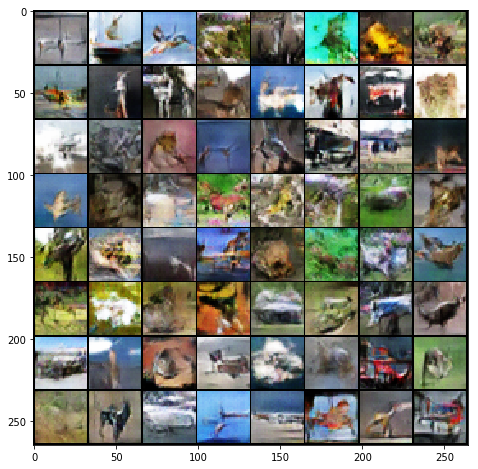

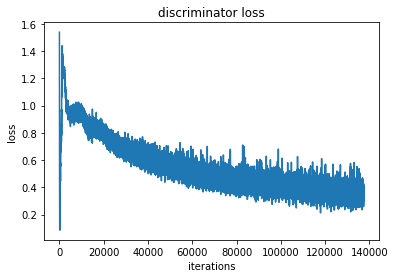

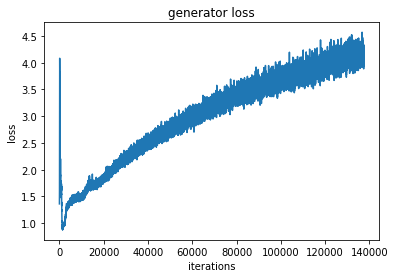

epoch  88
Iteration 137500/156200: dis loss = 0.2378, gen loss = 4.3050
Iteration 137550/156200: dis loss = 0.2114, gen loss = 5.5122
Iteration 137600/156200: dis loss = 0.4219, gen loss = 4.3647
Iteration 137650/156200: dis loss = 0.3896, gen loss = 4.9186
Iteration 137700/156200: dis loss = 0.2679, gen loss = 2.8576
Iteration 137750/156200: dis loss = 0.3462, gen loss = 5.9172
Iteration 137800/156200: dis loss = 0.1067, gen loss = 4.8867
Iteration 137850/156200: dis loss = 1.7146, gen loss = 3.3448
Iteration 137900/156200: dis loss = 0.3014, gen loss = 2.6856
Iteration 137950/156200: dis loss = 0.2596, gen loss = 3.6788
Iteration 138000/156200: dis loss = 0.2219, gen loss = 5.9190
Iteration 138050/156200: dis loss = 0.0918, gen loss = 4.6396
Iteration 138100/156200: dis loss = 0.1129, gen loss = 4.6459
Iteration 138150/156200: dis loss = 0.1619, gen loss = 4.9792
Iteration 138200/156200: dis loss = 0.1952, gen loss = 4.3423
Iteration 138250/156200: dis loss = 0.2823, gen loss = 3.664

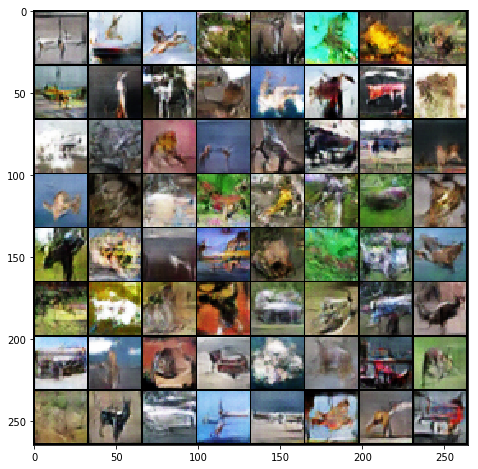

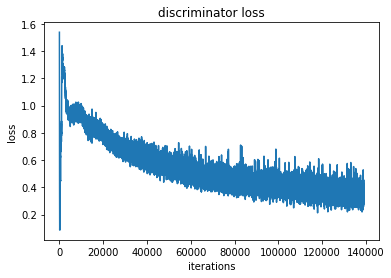

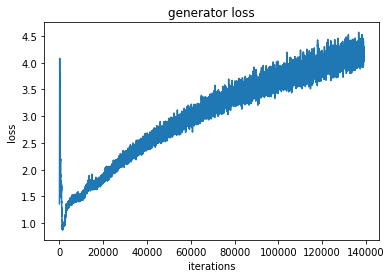

epoch  89
Iteration 139050/156200: dis loss = 0.5354, gen loss = 1.9180
Iteration 139100/156200: dis loss = 0.1720, gen loss = 3.9792
Iteration 139150/156200: dis loss = 0.1643, gen loss = 4.4567
Iteration 139200/156200: dis loss = 0.3641, gen loss = 4.7393
Iteration 139250/156200: dis loss = 0.5764, gen loss = 2.5481
Iteration 139300/156200: dis loss = 0.2293, gen loss = 3.8213
Iteration 139350/156200: dis loss = 0.4177, gen loss = 5.5202
Iteration 139400/156200: dis loss = 0.2899, gen loss = 2.5864
Iteration 139450/156200: dis loss = 0.3334, gen loss = 4.1645
Iteration 139500/156200: dis loss = 0.3033, gen loss = 4.3151
Iteration 139550/156200: dis loss = 0.2913, gen loss = 5.5575
Iteration 139600/156200: dis loss = 0.2954, gen loss = 5.1135
Iteration 139650/156200: dis loss = 0.1372, gen loss = 3.7448
Iteration 139700/156200: dis loss = 0.1369, gen loss = 4.4841
Iteration 139750/156200: dis loss = 0.2290, gen loss = 5.5291
Iteration 139800/156200: dis loss = 0.3353, gen loss = 6.289

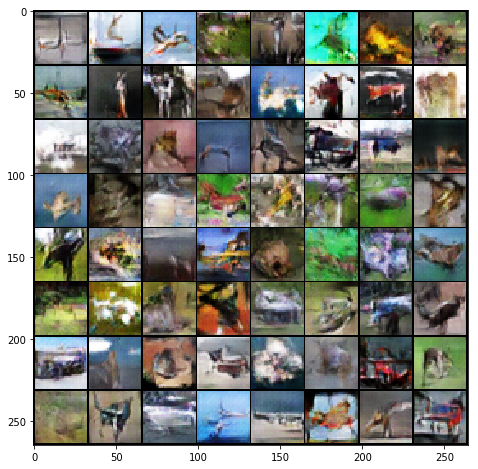

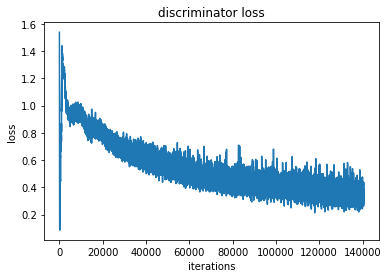

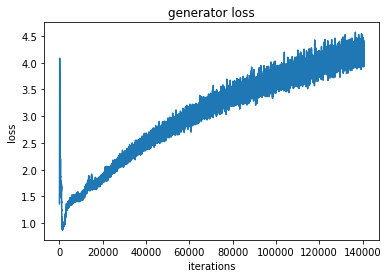

epoch  90
Iteration 140600/156200: dis loss = 0.2043, gen loss = 3.7357
Iteration 140650/156200: dis loss = 0.3067, gen loss = 3.4880
Iteration 140700/156200: dis loss = 0.3960, gen loss = 4.7947
Iteration 140750/156200: dis loss = 0.1015, gen loss = 5.2845
Iteration 140800/156200: dis loss = 0.1069, gen loss = 3.6776
Iteration 140850/156200: dis loss = 0.3480, gen loss = 4.5210
Iteration 140900/156200: dis loss = 0.3313, gen loss = 4.8399
Iteration 140950/156200: dis loss = 0.1433, gen loss = 3.6494
Iteration 141000/156200: dis loss = 0.1510, gen loss = 4.5602
Iteration 141050/156200: dis loss = 0.2256, gen loss = 4.8177
Iteration 141100/156200: dis loss = 0.1697, gen loss = 4.3964
Iteration 141150/156200: dis loss = 0.1224, gen loss = 4.6674
Iteration 141200/156200: dis loss = 0.1023, gen loss = 4.7546
Iteration 141250/156200: dis loss = 0.9023, gen loss = 0.9673
Iteration 141300/156200: dis loss = 0.2784, gen loss = 3.3414
Iteration 141350/156200: dis loss = 0.1032, gen loss = 6.036

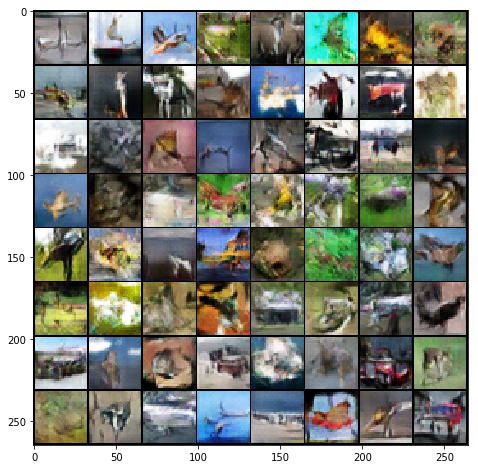

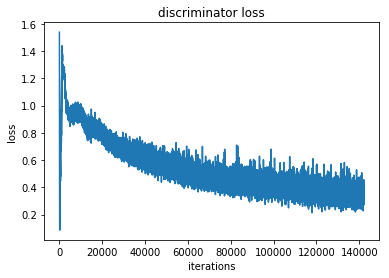

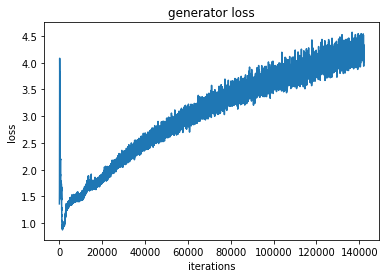

epoch  91
Iteration 142150/156200: dis loss = 0.4001, gen loss = 3.3100
Iteration 142200/156200: dis loss = 0.1728, gen loss = 4.6396
Iteration 142250/156200: dis loss = 0.2395, gen loss = 3.5371
Iteration 142300/156200: dis loss = 0.6815, gen loss = 2.4531
Iteration 142350/156200: dis loss = 0.1676, gen loss = 4.1916
Iteration 142400/156200: dis loss = 0.9115, gen loss = 6.8126
Iteration 142450/156200: dis loss = 0.3115, gen loss = 4.5304
Iteration 142500/156200: dis loss = 0.1048, gen loss = 4.4253
Iteration 142550/156200: dis loss = 0.4468, gen loss = 6.6157
Iteration 142600/156200: dis loss = 0.3597, gen loss = 3.9984
Iteration 142650/156200: dis loss = 0.1720, gen loss = 3.3786
Iteration 142700/156200: dis loss = 0.3868, gen loss = 5.5454
Iteration 142750/156200: dis loss = 0.1904, gen loss = 3.8324
Iteration 142800/156200: dis loss = 0.2463, gen loss = 4.1025
Iteration 142850/156200: dis loss = 0.4763, gen loss = 1.8907
Iteration 142900/156200: dis loss = 0.3435, gen loss = 5.527

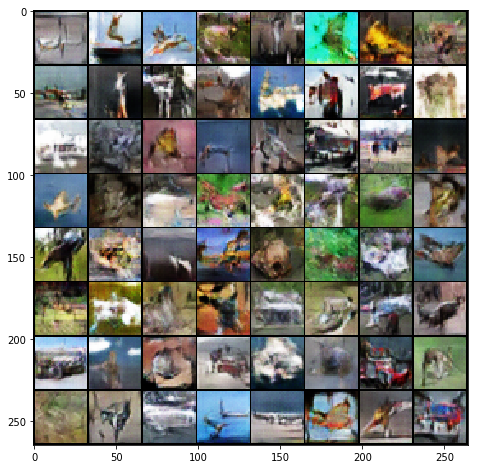

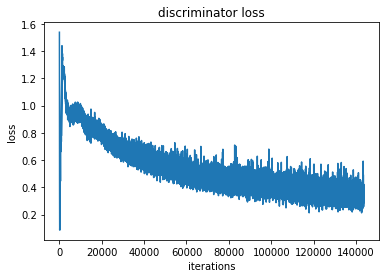

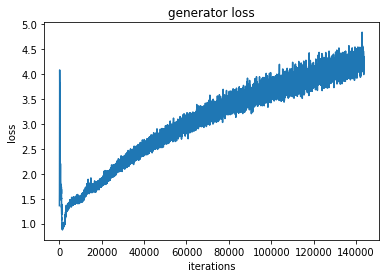

epoch  92
Iteration 143750/156200: dis loss = 0.2633, gen loss = 3.6398
Iteration 143800/156200: dis loss = 0.2028, gen loss = 4.2610
Iteration 143850/156200: dis loss = 0.1289, gen loss = 4.3982
Iteration 143900/156200: dis loss = 0.3486, gen loss = 5.3378
Iteration 143950/156200: dis loss = 0.1963, gen loss = 4.2572
Iteration 144000/156200: dis loss = 0.3463, gen loss = 4.4332
Iteration 144050/156200: dis loss = 0.4219, gen loss = 6.4069
Iteration 144100/156200: dis loss = 0.1454, gen loss = 4.0754
Iteration 144150/156200: dis loss = 0.1439, gen loss = 3.6280
Iteration 144200/156200: dis loss = 0.3536, gen loss = 3.9500
Iteration 144250/156200: dis loss = 0.3769, gen loss = 6.4508
Iteration 144300/156200: dis loss = 0.1896, gen loss = 4.1410
Iteration 144350/156200: dis loss = 0.3231, gen loss = 2.8777
Iteration 144400/156200: dis loss = 0.1176, gen loss = 5.2867
Iteration 144450/156200: dis loss = 0.1299, gen loss = 4.8136
Iteration 144500/156200: dis loss = 0.4428, gen loss = 1.970

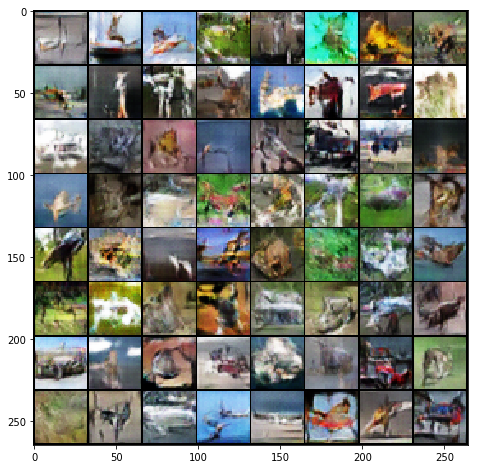

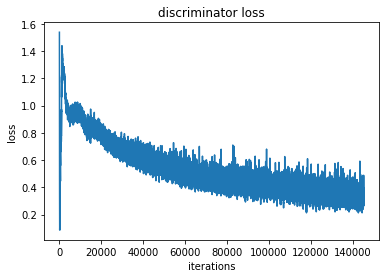

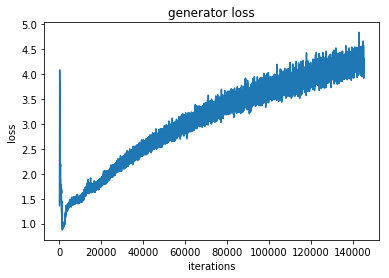

epoch  93
Iteration 145300/156200: dis loss = 0.1106, gen loss = 4.9244
Iteration 145350/156200: dis loss = 0.1844, gen loss = 6.4783
Iteration 145400/156200: dis loss = 0.1861, gen loss = 3.5922
Iteration 145450/156200: dis loss = 0.1354, gen loss = 4.3885
Iteration 145500/156200: dis loss = 0.3230, gen loss = 3.3945
Iteration 145550/156200: dis loss = 0.1079, gen loss = 5.0301
Iteration 145600/156200: dis loss = 0.4527, gen loss = 2.5100
Iteration 145650/156200: dis loss = 0.0693, gen loss = 4.6974
Iteration 145700/156200: dis loss = 0.2345, gen loss = 4.1397
Iteration 145750/156200: dis loss = 0.3542, gen loss = 5.8250
Iteration 145800/156200: dis loss = 0.5002, gen loss = 5.3313
Iteration 145850/156200: dis loss = 0.1108, gen loss = 4.4813
Iteration 145900/156200: dis loss = 0.4124, gen loss = 5.6401
Iteration 145950/156200: dis loss = 0.2632, gen loss = 4.3790
Iteration 146000/156200: dis loss = 0.1176, gen loss = 4.5560
Iteration 146050/156200: dis loss = 0.2197, gen loss = 4.767

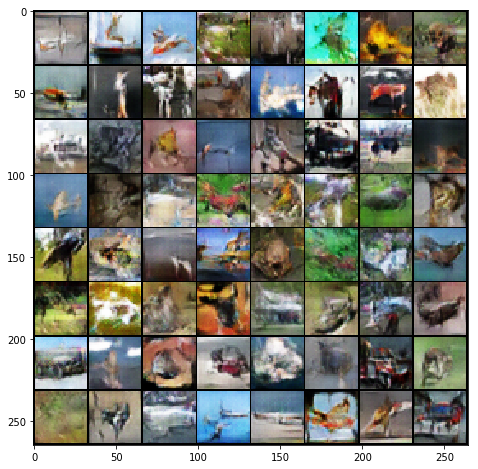

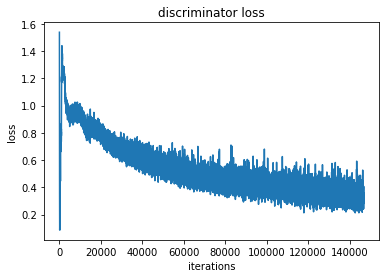

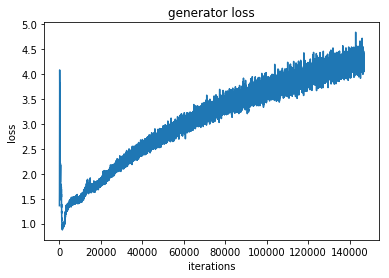

epoch  94
Iteration 146850/156200: dis loss = 0.5154, gen loss = 2.7275
Iteration 146900/156200: dis loss = 0.0655, gen loss = 4.6788
Iteration 146950/156200: dis loss = 0.0833, gen loss = 4.6286
Iteration 147000/156200: dis loss = 0.3572, gen loss = 3.0924
Iteration 147050/156200: dis loss = 0.2791, gen loss = 3.6108
Iteration 147100/156200: dis loss = 0.1339, gen loss = 4.3393
Iteration 147150/156200: dis loss = 0.2587, gen loss = 3.1214
Iteration 147200/156200: dis loss = 0.2798, gen loss = 3.1290
Iteration 147250/156200: dis loss = 0.1839, gen loss = 5.2160
Iteration 147300/156200: dis loss = 0.2185, gen loss = 4.0708
Iteration 147350/156200: dis loss = 0.1485, gen loss = 5.7939
Iteration 147400/156200: dis loss = 0.1995, gen loss = 3.2351
Iteration 147450/156200: dis loss = 0.4650, gen loss = 1.8173
Iteration 147500/156200: dis loss = 0.1496, gen loss = 4.7208
Iteration 147550/156200: dis loss = 0.2578, gen loss = 4.1012
Iteration 147600/156200: dis loss = 0.0861, gen loss = 4.823

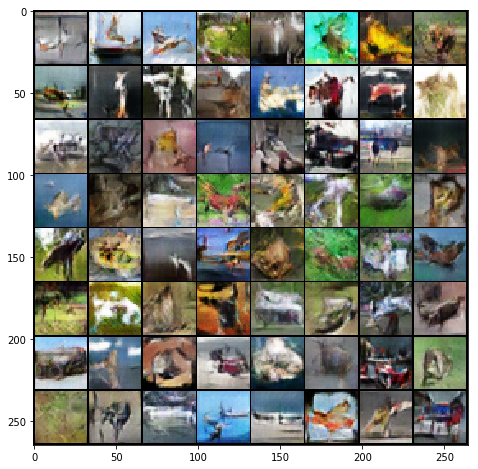

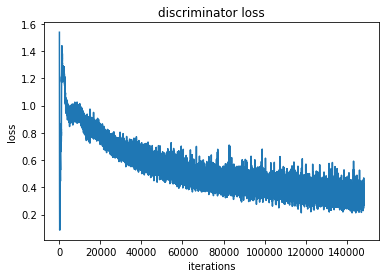

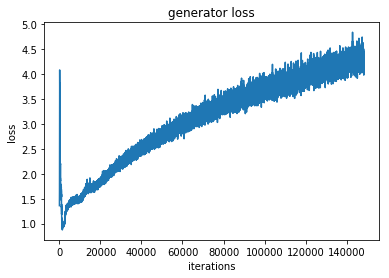

epoch  95
Iteration 148400/156200: dis loss = 0.1696, gen loss = 5.0373
Iteration 148450/156200: dis loss = 0.6214, gen loss = 5.5757
Iteration 148500/156200: dis loss = 0.3788, gen loss = 1.5973
Iteration 148550/156200: dis loss = 0.1786, gen loss = 4.3805
Iteration 148600/156200: dis loss = 0.1960, gen loss = 4.1344
Iteration 148650/156200: dis loss = 0.3637, gen loss = 3.8462
Iteration 148700/156200: dis loss = 0.1208, gen loss = 4.6200
Iteration 148750/156200: dis loss = 0.1243, gen loss = 4.4683
Iteration 148800/156200: dis loss = 0.1275, gen loss = 5.0276
Iteration 148850/156200: dis loss = 0.2394, gen loss = 4.1902
Iteration 148900/156200: dis loss = 0.5907, gen loss = 7.3667
Iteration 148950/156200: dis loss = 0.2734, gen loss = 2.9561
Iteration 149000/156200: dis loss = 0.3239, gen loss = 6.0176
Iteration 149050/156200: dis loss = 0.2762, gen loss = 3.7851
Iteration 149100/156200: dis loss = 0.1747, gen loss = 4.9605
Iteration 149150/156200: dis loss = 0.1007, gen loss = 4.107

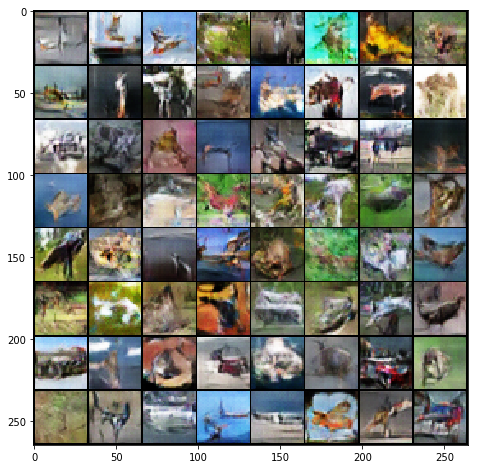

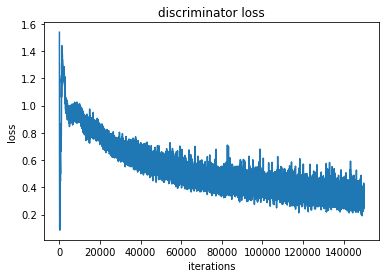

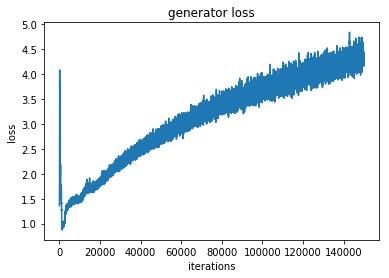

epoch  96
Iteration 150000/156200: dis loss = 0.9448, gen loss = 3.3392
Iteration 150050/156200: dis loss = 0.2139, gen loss = 3.5610
Iteration 150100/156200: dis loss = 0.2309, gen loss = 5.3962
Iteration 150150/156200: dis loss = 0.4572, gen loss = 6.4132
Iteration 150200/156200: dis loss = 0.2108, gen loss = 3.1007
Iteration 150250/156200: dis loss = 0.0849, gen loss = 5.3933
Iteration 150300/156200: dis loss = 0.4080, gen loss = 3.0926
Iteration 150350/156200: dis loss = 0.3347, gen loss = 3.3875
Iteration 150400/156200: dis loss = 0.1414, gen loss = 3.8854
Iteration 150450/156200: dis loss = 0.4485, gen loss = 2.3095
Iteration 150500/156200: dis loss = 0.2385, gen loss = 2.7763
Iteration 150550/156200: dis loss = 0.4398, gen loss = 2.4786
Iteration 150600/156200: dis loss = 0.2124, gen loss = 4.3955
Iteration 150650/156200: dis loss = 0.1631, gen loss = 4.1845
Iteration 150700/156200: dis loss = 0.2529, gen loss = 5.9658
Iteration 150750/156200: dis loss = 0.3175, gen loss = 3.092

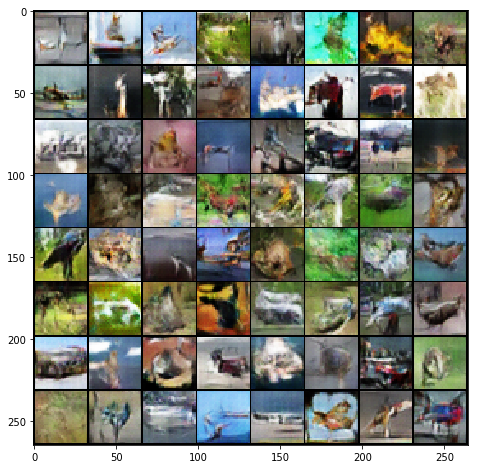

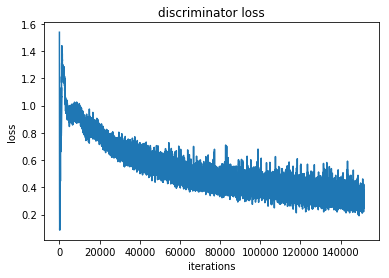

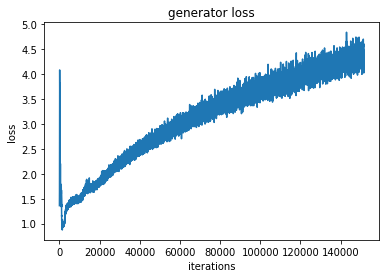

epoch  97
Iteration 151550/156200: dis loss = 0.3474, gen loss = 5.0020
Iteration 151600/156200: dis loss = 0.2027, gen loss = 5.8973
Iteration 151650/156200: dis loss = 0.1806, gen loss = 5.6752
Iteration 151700/156200: dis loss = 0.0775, gen loss = 4.5508
Iteration 151750/156200: dis loss = 0.1508, gen loss = 4.1071
Iteration 151800/156200: dis loss = 0.2611, gen loss = 4.5282
Iteration 151850/156200: dis loss = 0.1900, gen loss = 4.3201
Iteration 151900/156200: dis loss = 0.1997, gen loss = 3.9657
Iteration 151950/156200: dis loss = 0.1802, gen loss = 5.5763
Iteration 152000/156200: dis loss = 0.2304, gen loss = 5.3006
Iteration 152050/156200: dis loss = 0.1219, gen loss = 5.1502
Iteration 152100/156200: dis loss = 0.2961, gen loss = 4.2416
Iteration 152150/156200: dis loss = 0.7250, gen loss = 5.7643
Iteration 152200/156200: dis loss = 0.3012, gen loss = 3.9149
Iteration 152250/156200: dis loss = 0.0984, gen loss = 4.8153
Iteration 152300/156200: dis loss = 0.3193, gen loss = 3.501

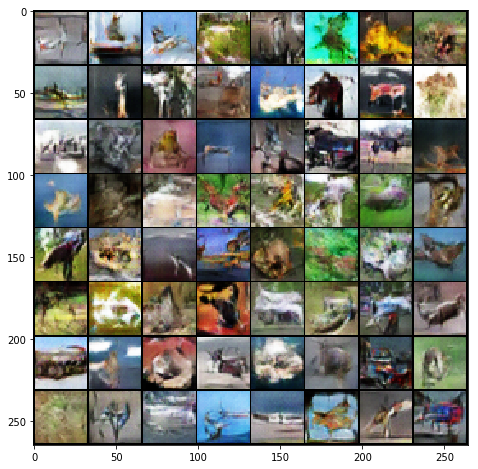

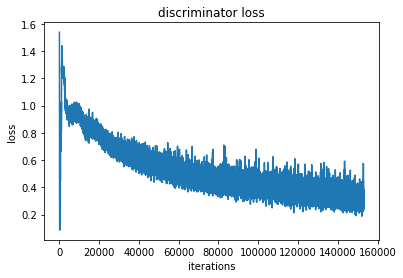

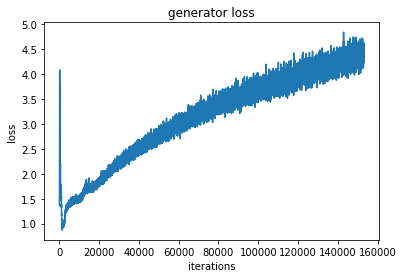

epoch  98
Iteration 153100/156200: dis loss = 0.3249, gen loss = 4.4797
Iteration 153150/156200: dis loss = 0.1739, gen loss = 4.2022
Iteration 153200/156200: dis loss = 0.2792, gen loss = 3.4196
Iteration 153250/156200: dis loss = 0.5017, gen loss = 6.5646
Iteration 153300/156200: dis loss = 0.1390, gen loss = 4.1210
Iteration 153350/156200: dis loss = 0.7414, gen loss = 2.5890
Iteration 153400/156200: dis loss = 0.2067, gen loss = 5.6137
Iteration 153450/156200: dis loss = 0.2333, gen loss = 4.5351
Iteration 153500/156200: dis loss = 0.2609, gen loss = 4.0397
Iteration 153550/156200: dis loss = 0.1848, gen loss = 5.6896
Iteration 153600/156200: dis loss = 0.2889, gen loss = 4.6683
Iteration 153650/156200: dis loss = 1.7493, gen loss = 1.1376
Iteration 153700/156200: dis loss = 0.2383, gen loss = 4.3606
Iteration 153750/156200: dis loss = 0.4017, gen loss = 4.6361
Iteration 153800/156200: dis loss = 0.0709, gen loss = 4.5550
Iteration 153850/156200: dis loss = 0.3460, gen loss = 7.557

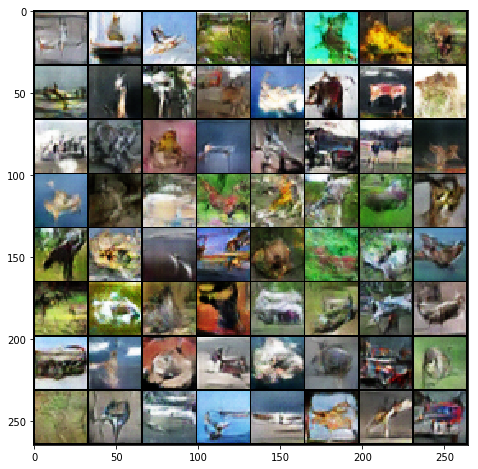

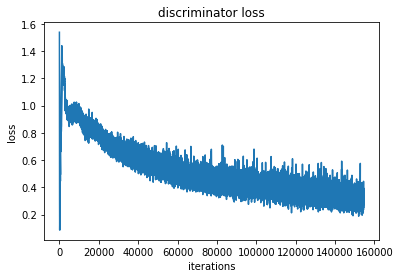

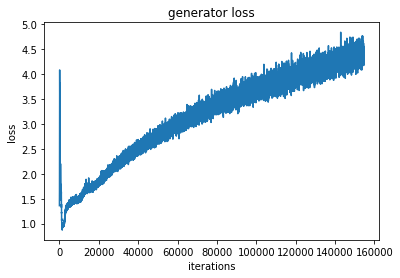

epoch  99
Iteration 154650/156200: dis loss = 0.4391, gen loss = 2.0315
Iteration 154700/156200: dis loss = 0.1674, gen loss = 4.4580
Iteration 154750/156200: dis loss = 0.2501, gen loss = 3.3767
Iteration 154800/156200: dis loss = 0.1687, gen loss = 5.4866
Iteration 154850/156200: dis loss = 0.0841, gen loss = 4.1297
Iteration 154900/156200: dis loss = 0.2135, gen loss = 2.9333
Iteration 154950/156200: dis loss = 0.5416, gen loss = 1.8845
Iteration 155000/156200: dis loss = 0.1788, gen loss = 5.1741
Iteration 155050/156200: dis loss = 0.1186, gen loss = 4.1645
Iteration 155100/156200: dis loss = 0.0836, gen loss = 5.0121
Iteration 155150/156200: dis loss = 0.2220, gen loss = 3.7904
Iteration 155200/156200: dis loss = 0.1337, gen loss = 4.9713
Iteration 155250/156200: dis loss = 0.2316, gen loss = 3.0318
Iteration 155300/156200: dis loss = 0.9474, gen loss = 8.1726
Iteration 155350/156200: dis loss = 0.2173, gen loss = 4.8173
Iteration 155400/156200: dis loss = 0.1314, gen loss = 4.851

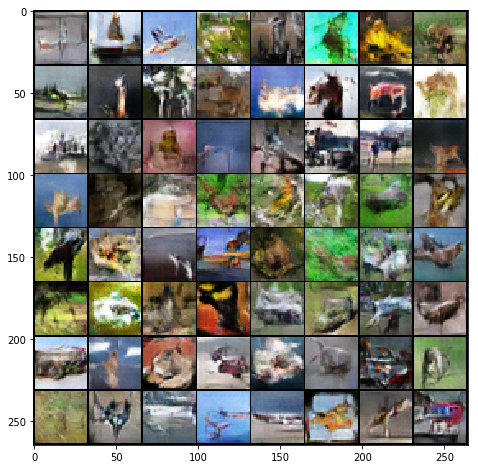

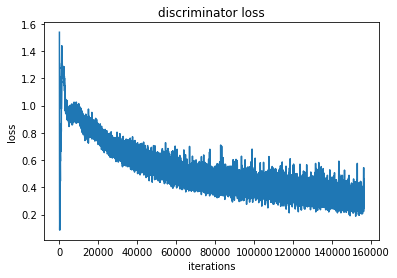

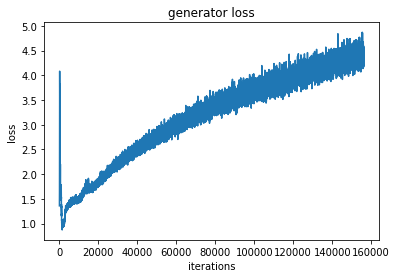

... Done!


In [5]:
tf.reset_default_graph()
set_seed(21)

with tf.Session() as sess:
    with tf.device('/cpu:0'):
        dcgan = DCGAN()
        sess.run(tf.global_variables_initializer())
        dcgan.train(sess, train_samples)
        dis_var_list = tf.get_collection(tf.GraphKeys.GLOBAL_VARIABLES, 'dis')
        gen_var_list = tf.get_collection(tf.GraphKeys.GLOBAL_VARIABLES, 'gen')
        saver = tf.train.Saver(dis_var_list + gen_var_list)
    with tf.device('/cpu:0'):
        saver.save(sess, 'model/dcgan')


Start training ...
epoch  0
Iteration 50/1562: dis loss = 0.4688, gen loss = 2.1446
Iteration 100/1562: dis loss = 0.0753, gen loss = 4.0170
Iteration 150/1562: dis loss = 0.1897, gen loss = 5.2835
Iteration 200/1562: dis loss = 0.1905, gen loss = 2.8293
Iteration 250/1562: dis loss = 0.0445, gen loss = 4.2968
Iteration 300/1562: dis loss = 0.3133, gen loss = 1.1837
Iteration 350/1562: dis loss = 0.6578, gen loss = 1.3265
Iteration 400/1562: dis loss = 0.5728, gen loss = 1.7224
Iteration 450/1562: dis loss = 0.6661, gen loss = 1.5399
Iteration 500/1562: dis loss = 0.5682, gen loss = 3.0428
Iteration 550/1562: dis loss = 0.8679, gen loss = 1.6789
Iteration 600/1562: dis loss = 0.7592, gen loss = 1.9425
Iteration 650/1562: dis loss = 1.0551, gen loss = 2.2363
Iteration 700/1562: dis loss = 0.7847, gen loss = 1.0953
Iteration 750/1562: dis loss = 0.6365, gen loss = 2.1538
Iteration 800/1562: dis loss = 0.5567, gen loss = 2.4792
Iteration 850/1562: dis loss = 0.7807, gen loss = 1.3873
Iter

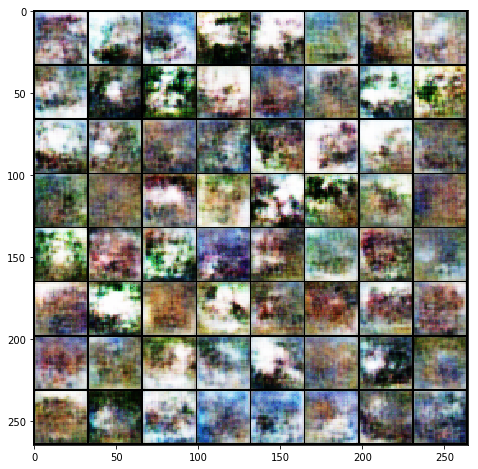

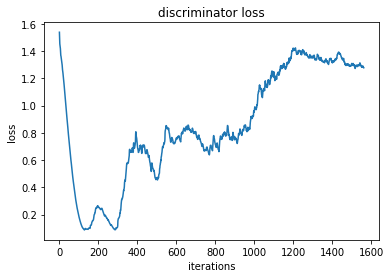

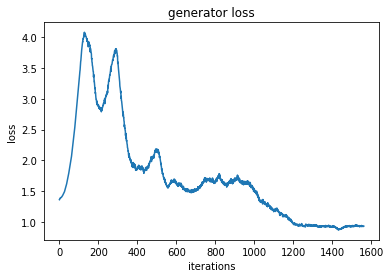

... Done!


In [11]:
tf.reset_default_graph()
set_seed(21)

with tf.Session() as sess:
    with tf.device('/cpu:0'):
        dcgan = DCGAN()
        sess.run(tf.global_variables_initializer())
        dcgan.train(sess, train_samples)
        dis_var_list = tf.get_collection(tf.GraphKeys.GLOBAL_VARIABLES, 'dis')
        gen_var_list = tf.get_collection(tf.GraphKeys.GLOBAL_VARIABLES, 'gen')
        saver = tf.train.Saver(dis_var_list + gen_var_list)
    with tf.device('/cpu:0'):
        saver.save(sess, 'model/dcgan')


In [21]:
from tensorflow.python.client import device_lib

def get_available_gpus():
    local_device_protos = device_lib.list_local_devices()
    #return [x.name for x in local_device_protos if x.device_type == 'GPU']
    return [x.name for x in local_device_protos]

print(get_available_gpus())

# outout on cmd
# 2019-03-13 14:39:25.362048: I tensorflow/core/platform/cpu_feature_guard.cc:141] Your CPU supports instructions that thi
# s TensorFlow binary was not compiled to use: AVX
# 2019-03-13 14:39:25.942456: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1433] Found device 0 with properties:
# name: GeForce GT 720M major: 2 minor: 1 memoryClockRate(GHz): 1.25
# pciBusID: 0000:01:00.0
# totalMemory: 2.00GiB freeMemory: 1.65GiB
# 2019-03-13 14:39:25.968877: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1483] Ignoring visible gpu device (device
# : 0, name: GeForce GT 720M, pci bus id: 0000:01:00.0, compute capability: 2.1) with Cuda compute capability 2.1. The min
# imum required Cuda capability is 3.0.
# 2019-03-13 14:39:26.003050: I tensorflow/core/common_runtime/gpu/gpu_device.cc:984] Device interconnect StreamExecutor w
# ith strength 1 edge matrix:
# 2019-03-13 14:39:26.022324: I tensorflow/core/common_runtime/gpu/gpu_device.cc:990]      0
# 2019-03-13 14:39:26.033424: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1003] 0:   N
# ['/device:CPU:0']

# output on jupyter notebook
['/device:CPU:0']

['/device:CPU:0']


## Problem 2-2: The forger versus the police, revisited

In the forger versus police story, we made part of it hand-wavy to hide a flaw that makes the story improbable to actually happen and makes it a bad analogy of how the training works in a GAN. Now that you have implemented a GAN, can you spot the flaw?

Specifically, when we consider one of the two parties, the other is treated as a black box. They know their opponent's result but not how they works. What is wrong here?

**Your answer below:**

In the orger versus the police story, they never share information and are adversarial to each other. The Nets are adversarial but also cooperative as the discriminator estimates the ratio of densities and freely shares this information with generator. The discriminator is more like a teacher instructing the generator in how to improve the adversary.

https://medium.com/@sanketgujar95/quick-introduction-to-gans-1d1f099dc4a7

---

*The Tao of GANs: They might be adversaries, yet they are also cooperative.*

---

## Problem 2-3: The Batch Normalization dilemma

Here are three questions related to the use of Batch Normalization in GANs. The first two will not be graded and their answers are provided. But you should attempt to solve them before looking at the answer.

---

We made separate batches for real samples and fake samples when training the discriminator. Is this just an arbitrary design decision made by the inventor that later becomes the common practice, or is it critical to the correctness of the algorithm?

**Select text below to see answer:**

<p style="color:white;">When we are training the generator, the input batch to the discriminator will always consist of only fake samples. If we separate real and fake batches when training the discriminator, then the fake samples are normalized in the same way when we are training the discriminator and when we are training the generator. If we mix real and fake samples in the same batch when training the discriminator, then the fake samples are not normalized in the same way when we train the two networks, which causes the generator to fail to learn the correct distribution.</p>

---

Look at the construction of the discriminator carefully. You will find that between ```dis_conv1``` and ```dis_lrelu1``` there is no batch normalization. This is not a mistake. What could go wrong if there were a batch normalization layer there? Why do you think that omitting this batch normalization layer solves the problem practically if not theoretically?

**Select text below to see answer:**

<p style="color:white;">Since we put real samples and fake samples in separate batches, if we add a batch normalization layer between dis_conv1 and dis_lrelu1, the discriminator would not be able to distinguish two distributions if one can be obtained by applying an isotropic scaling and a translation in color space to the other.</p>

<p style="color:white;">By removing the first batch normalization layer, for two different distributions to get confused with each other they must produce two distributions after dis_lrelu1 such that one can be obtained by applying an isotropic scaling and a translation to the other. Such a case is still possible but extremely unlikely to happen.</p>

---

Propose a different way of feeding the samples to solve the problem in the second question without omitting any batch normalization layers or changing their mode of operation.

**Your answer below:**

---

*Take-aways from this problem: always excercise extreme caution when using batch normalization in your network!*

*For further info (optional): you can read this paper to find out more about why Batch Normalization might be bad for your GANs: [On the Effects of Batch and Weight Normalization in Generative Adversarial Networks](https://arxiv.org/abs/1704.03971)*

---

## Problem 2-4: Activation Maximization

Activation Maximization is a visualization technique to see what a particular neuron has learned, by finding the input that maximizes the activation of that neuron. Here we use methods similar to *[Synthesizing the preferred inputs for neurons in neural networks via deep generator networks](https://arxiv.org/abs/1605.09304)*.

In short, what we want to do is to find the samples that the discriminator considers most real, among all possible outputs of the generator, which is to say, we want to find the codes (i.e. a point in the input space of the generator) from which the generated images, if labelled as real, would minimize the classification loss of the discriminator:

$$\min_{z} L(D_{\theta}(G_{\phi}(z)), 1)$$

Compare this to the objective when we were training the generator:

$$\min_{\phi} \mathrm{E}_{z \sim q(z)}[L(D_{\theta}(G_{\phi}(z)), 1)]$$

The function to minimize is the same, with the difference being that when training the network we fix a set of input data and find the optimal model parameters, while in activation maximization we fix the model parameters and find the optimal input.

So, similar to the training, we use gradient descent to solve for the optimal input. Starting from a random code drawn from a standard normal distribution, we perform a fixed step of Adam optimization algorithm on the code.

The batch normalization layers should work in evaluation mode.  <p style="color:red;"> what should we do for this. In line 317 of that block it is already self.is_train:Flase</p>

We provide the code for this part, as a reference for solving the next part. You may want to go back to the code above and check the following:

*   **Build the computation graph for the loss:** Check the definition of these operations in ```_init_ops()```
    *   ```actmax_sample_op```: generate samples from ```actmax_code```
    *   ```actmax_loss_op```: compute discriminator's loss on samples generated from ```actmax_code```
*   **Define the optimizer:** Check the definition of ```actmax_op```, which updates ```actmax_code```
*   **Feed the data:** Check the function ```actmax_one_sample()```

INFO:tensorflow:Restoring parameters from model/dcgan


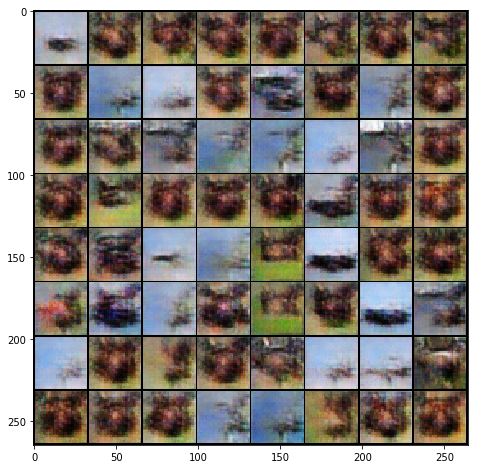

In [8]:
tf.reset_default_graph()
set_seed(241)

with tf.Session() as sess:
    with tf.device('/cpu:0'):
        dcgan = DCGAN()
        sess.run(tf.global_variables_initializer())
        dis_var_list = tf.get_collection(tf.GraphKeys.GLOBAL_VARIABLES, 'dis')
        gen_var_list = tf.get_collection(tf.GraphKeys.GLOBAL_VARIABLES, 'gen')
        saver = tf.train.Saver(dis_var_list + gen_var_list)
#     with tf.device('/cpu:0'):
        saver.restore(sess, 'model/dcgan')
        actmax_results = dcgan.actmax(np.random.random([64, dcgan.code_size]))
        fig = plt.figure(figsize = (8, 8))   
        ax1 = plt.subplot(111)
        ax1.imshow(viz_grid(actmax_results, 1))
        plt.show()

INFO:tensorflow:Restoring parameters from model/dcgan


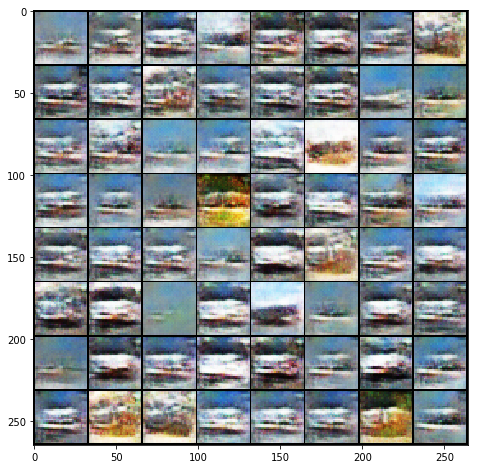

In [39]:
tf.reset_default_graph()
set_seed(241)

with tf.Session() as sess:
    with tf.device('/cpu:0'):
        dcgan = DCGAN()
        sess.run(tf.global_variables_initializer())
        dis_var_list = tf.get_collection(tf.GraphKeys.GLOBAL_VARIABLES, 'dis')
        gen_var_list = tf.get_collection(tf.GraphKeys.GLOBAL_VARIABLES, 'gen')
        saver = tf.train.Saver(dis_var_list + gen_var_list)
#     with tf.device('/cpu:0'):
        saver.restore(sess, 'model/dcgan')
        actmax_results = dcgan.actmax(np.random.random([64, dcgan.code_size]))
        fig = plt.figure(figsize = (8, 8))   
        ax1 = plt.subplot(111)
        ax1.imshow(viz_grid(actmax_results, 1))
        plt.show()

INFO:tensorflow:Restoring parameters from model/dcgan


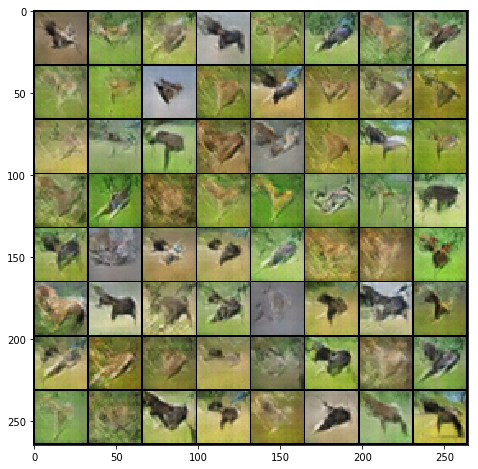

In [5]:
tf.reset_default_graph()
set_seed(241)

with tf.Session() as sess:
    with tf.device('/cpu:0'):
        dcgan = DCGAN()
        sess.run(tf.global_variables_initializer())
        dis_var_list = tf.get_collection(tf.GraphKeys.GLOBAL_VARIABLES, 'dis')
        gen_var_list = tf.get_collection(tf.GraphKeys.GLOBAL_VARIABLES, 'gen')
        saver = tf.train.Saver(dis_var_list + gen_var_list)
#     with tf.device('/cpu:0'):
        saver.restore(sess, 'model/dcgan')
        actmax_results = dcgan.actmax(np.random.random([64, dcgan.code_size]))
        fig = plt.figure(figsize = (8, 8))   
        ax1 = plt.subplot(111)
        ax1.imshow(viz_grid(actmax_results, 1))
        plt.show()

The output should have less variety than those generated from random code. While it is reasonable that the samples that are "most real" makes up only a small portion of the sample space, this also gives us a hint that the so-called "mode collapse", in which the GAN simply fails to model a majority part of the data distribution, is a real problem.

A similar technique can be used to reconstruct a test sample, that is, to find the code that most closely approximates the test sample. To achieve this, we only need to change the loss function from discriminator's loss to the squared L2-distance between the generated image and the target image:

$$\min_{z} \left|\left|G_{\phi}(z)-x\right|\right|_2^2$$

This time, we always start from a zero vector.

For this part, you need to complete code blocks marked with "Prob 2-4":

*   **Build the computation graph for the loss:** Complete the definition of ```recon_loss_op``` in ```_init_ops()```, which computes the squared L2-distance between ```recon_sample``` and the sample generated from ```actmax_code```.
*   **Define the optimizer:** Modify the definition of ```reconstruct_op``` so that it updates ```actmax_code``` rather than the parameters of the networks.
*   **Feed the data:** Set the proper initial value and feed the proper data in ```reconstruct_one_sample()```

INFO:tensorflow:Restoring parameters from model/dcgan
average reconstruction loss = 34.3816


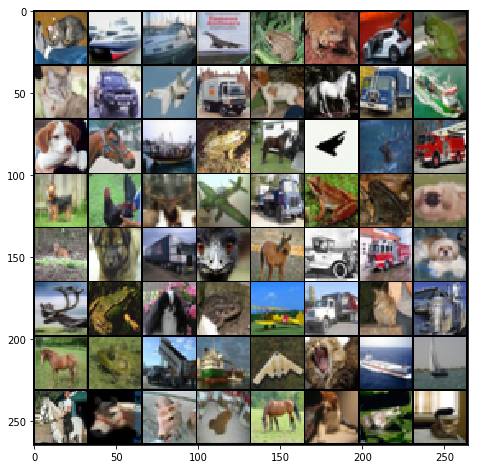

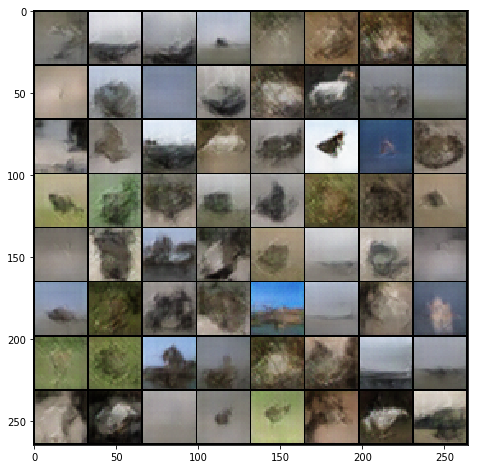

In [15]:
tf.reset_default_graph()

with tf.Session() as sess:
    with tf.device('/cpu:0'):
        dcgan = DCGAN()
        sess.run(tf.global_variables_initializer())
        dis_var_list = tf.get_collection(tf.GraphKeys.GLOBAL_VARIABLES, 'dis')
        gen_var_list = tf.get_collection(tf.GraphKeys.GLOBAL_VARIABLES, 'gen')
        saver = tf.train.Saver(dis_var_list + gen_var_list)
    with tf.device('/cpu:0'):
        saver.restore(sess, 'model/dcgan')
    
    with tf.device('/cpu:0'):
        avg_loss, reconstructions = dcgan.reconstruct(test_samples[0:64])
        print('average reconstruction loss = {0:.4f}'.format(avg_loss))
        fig = plt.figure(figsize = (8, 8))   
        ax1 = plt.subplot(111)
        ax1.imshow(viz_grid(test_samples[0:64], 1))
        plt.show()
        fig = plt.figure(figsize = (8, 8))   
        ax1 = plt.subplot(111)
        ax1.imshow(viz_grid(reconstructions, 1))
        plt.show()

INFO:tensorflow:Restoring parameters from model/dcgan
average reconstruction loss = 32.7369


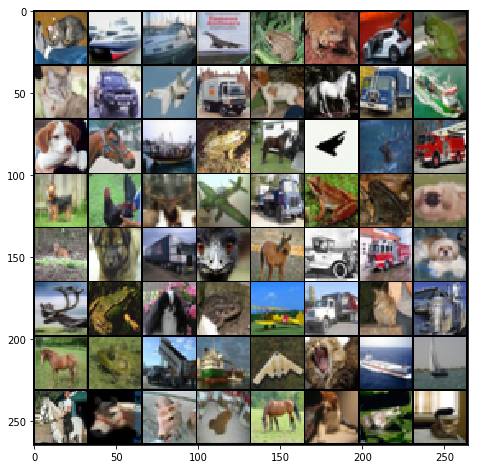

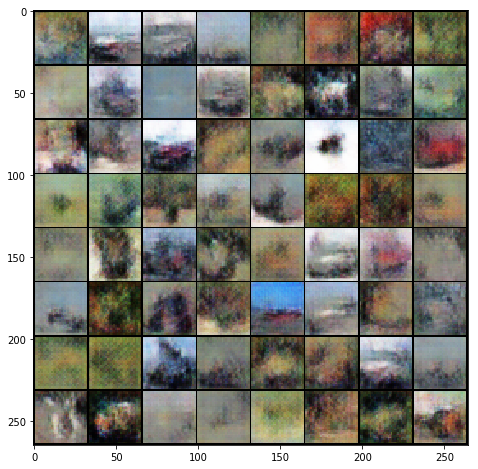

In [16]:
tf.reset_default_graph()

with tf.Session() as sess:
    with tf.device('/cpu:0'):
        dcgan = DCGAN()
        sess.run(tf.global_variables_initializer())
        dis_var_list = tf.get_collection(tf.GraphKeys.GLOBAL_VARIABLES, 'dis')
        gen_var_list = tf.get_collection(tf.GraphKeys.GLOBAL_VARIABLES, 'gen')
        saver = tf.train.Saver(dis_var_list + gen_var_list)
    with tf.device('/cpu:0'):
        saver.restore(sess, 'model/dcgan')
    
    with tf.device('/cpu:0'):
        avg_loss, reconstructions = dcgan.reconstruct(test_samples[0:64])
        print('average reconstruction loss = {0:.4f}'.format(avg_loss))
        fig = plt.figure(figsize = (8, 8))   
        ax1 = plt.subplot(111)
        ax1.imshow(viz_grid(test_samples[0:64], 1))
        plt.show()
        fig = plt.figure(figsize = (8, 8))   
        ax1 = plt.subplot(111)
        ax1.imshow(viz_grid(reconstructions, 1))
        plt.show()

INFO:tensorflow:Restoring parameters from model/dcgan
average reconstruction loss = 31.8736


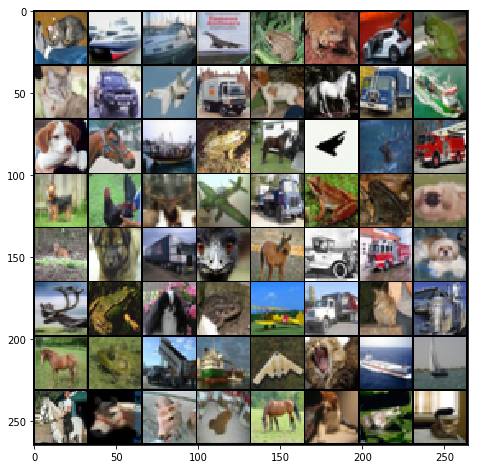

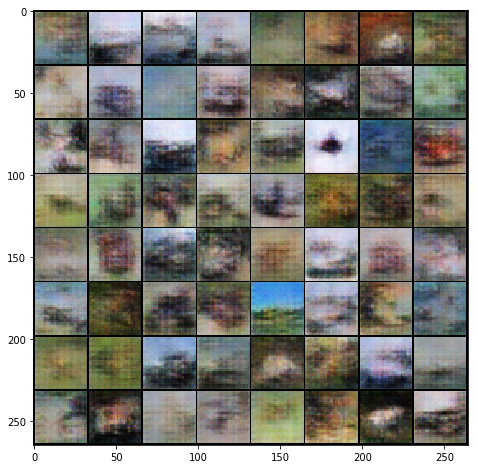

In [17]:
tf.reset_default_graph()

with tf.Session() as sess:
    with tf.device('/cpu:0'):
        dcgan = DCGAN()
        sess.run(tf.global_variables_initializer())
        dis_var_list = tf.get_collection(tf.GraphKeys.GLOBAL_VARIABLES, 'dis')
        gen_var_list = tf.get_collection(tf.GraphKeys.GLOBAL_VARIABLES, 'gen')
        saver = tf.train.Saver(dis_var_list + gen_var_list)
    with tf.device('/cpu:0'):
        saver.restore(sess, 'model/dcgan')
    
    with tf.device('/cpu:0'):
        avg_loss, reconstructions = dcgan.reconstruct(test_samples[0:64])
        print('average reconstruction loss = {0:.4f}'.format(avg_loss))
        fig = plt.figure(figsize = (8, 8))   
        ax1 = plt.subplot(111)
        ax1.imshow(viz_grid(test_samples[0:64], 1))
        plt.show()
        fig = plt.figure(figsize = (8, 8))   
        ax1 = plt.subplot(111)
        ax1.imshow(viz_grid(reconstructions, 1))
        plt.show()

INFO:tensorflow:Restoring parameters from model/dcgan
average reconstruction loss = 32.7369


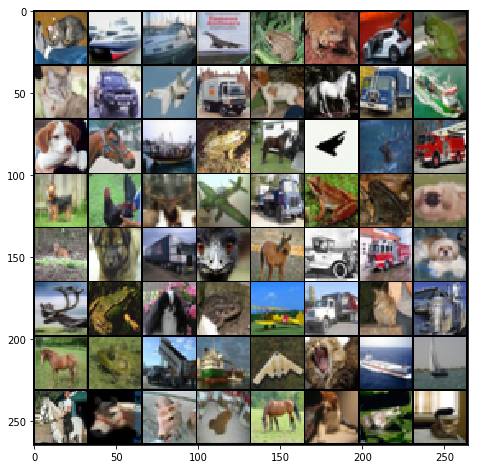

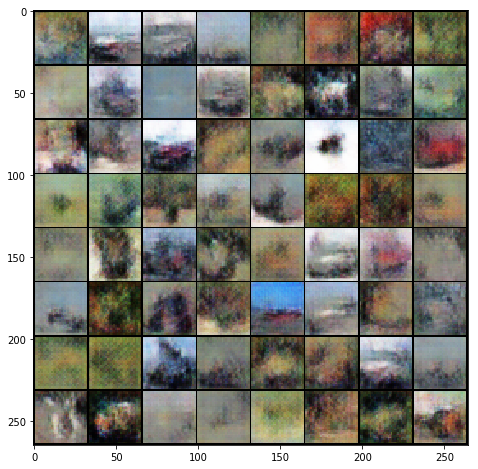

In [18]:
tf.reset_default_graph()

with tf.Session() as sess:
    with tf.device('/cpu:0'):
        dcgan = DCGAN()
        sess.run(tf.global_variables_initializer())
        dis_var_list = tf.get_collection(tf.GraphKeys.GLOBAL_VARIABLES, 'dis')
        gen_var_list = tf.get_collection(tf.GraphKeys.GLOBAL_VARIABLES, 'gen')
        saver = tf.train.Saver(dis_var_list + gen_var_list)
    with tf.device('/cpu:0'):
        saver.restore(sess, 'model/dcgan')
    
    with tf.device('/cpu:0'):
        avg_loss, reconstructions = dcgan.reconstruct(test_samples[0:64])
        print('average reconstruction loss = {0:.4f}'.format(avg_loss))
        fig = plt.figure(figsize = (8, 8))   
        ax1 = plt.subplot(111)
        ax1.imshow(viz_grid(test_samples[0:64], 1))
        plt.show()
        fig = plt.figure(figsize = (8, 8))   
        ax1 = plt.subplot(111)
        ax1.imshow(viz_grid(reconstructions, 1))
        plt.show()

Now you can increase the training epochs. You should be able to achieve a reconstruction loss lower than 32.